In [1]:
%matplotlib inline
import os
from os.path import dirname, abspath, join
from os import getcwd
import sys

THIS_DIR = getcwd()
CLASS_DIR = abspath(join(THIS_DIR, 'dsnclasses'))  #abspath(join(THIS_DIR, '../../..', 'dsnclasses'))
sys.path.append(CLASS_DIR)

In [2]:
import random
import string
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import torch
from IPython.display import clear_output

In [3]:
seed = 161
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [4]:
class ENO(object):
    
    #no. of forecast types is 6 ranging from 0 to 5
  
    def __init__(self, location='tokyo', year=2010, shuffle=False, day_balance=False):
        self.location = location
        self.year = year
        self.day = None
        self.hr = None
        
        self.shuffle = shuffle
        self.day_balance = day_balance

        self.TIME_STEPS = None #no. of time steps in one episode
        self.NO_OF_DAYS = None #no. of days in one year
        
        self.NO_OF_DAYTYPE = 5 #no. of daytypes
        self.daycounter = 0 #to count number of days that have been passed
        
        self.sradiation = None #matrix with GSR for the entire year
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #matrix with forecast values for each day
        

        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
        
        self.SMAX = 1000 # 1 Watt Solar Panel

    
    #function to get the solar data for the given location and year and prep it
    def get_data(self):
        #CSV files contain the values of GSR (Global Solar Radiation in MegaJoules per meters squared per hour)
        THIS_DIR = getcwd()
        DATA_DIR = abspath(join(THIS_DIR, 'data'))  #abspath(join(THIS_DIR, '../../..', 'data'))
        file = DATA_DIR + '/' + self.location +'/' + str(self.year) + '.csv'
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(file, skiprows=4, encoding='shift_jisx0213', usecols=[4])
        
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values
        #reshape solar_radiation into no_of_daysx24 array
        sradiation = solar_radiation.reshape(-1,24)
        #convert missing data in CSV files to zero
        sradiation[np.isnan(sradiation)] = 0
        if(self.shuffle): #if class instatiation calls for shuffling the day order. Required when learning
            np.random.shuffle(sradiation) 
        self.sradiation = sradiation
        
        
        #GSR values (in MJ/sq.mts per hour) need to be expressed in mW
        # Conversion is accomplished by 
        # solar_energy = GSR(in MJ/m2/hr) * 1e6 * size of solar cell * efficiency of solar cell /(60x60) *1000 (to express in mW)
        # the factor of 2 in the end is assuming two solar cells
        self.senergy = 2*self.sradiation * 1e6 * (55e-3 * 70e-3) * 0.15 * 1000/(60*60)

        return 0
    
    #function to map total day radiation into type of day ranging from 0 to 5
    #the classification into day types is quite arbitrary. There is no solid logic behind this type of classification.
    
    def get_day_state(self,tot_day_radiation):
        if (tot_day_radiation < 3.5):
            day_state = 0
        elif (3.5 <= tot_day_radiation < 7):
            day_state = 1
        elif (7 <= tot_day_radiation < 12):
            day_state = 2
        elif (12 <= tot_day_radiation < 15):
            day_state = 3
        elif (15 <= tot_day_radiation < 17.5):
            day_state = 4
        else:
            day_state = 5
        return int(day_state)
    
    def get_forecast(self):
        #create a perfect forecaster.
        tot_day_radiation = np.sum(self.sradiation, axis=1) #contains total solar radiation for each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_radiation)
        
        #sort days depending on the type of day and shuffle them; maybe required when learning
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
        return 0
    
    def reset(self,day=0): #it is possible to reset to the beginning of a certain day
        
        self.get_data() #first get data for the given year
        self.get_forecast() #calculate the forecast
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        self.day = day
        self.hr = 0
        
        self.henergy = self.senergy[self.day][self.hr]
        self.fcast = self.fforecast[self.day]
        
        end_of_day = False
        end_of_year = False
        return [self.henergy, self.fcast, end_of_day, end_of_year]

    
    def step(self):
        end_of_day = False
        end_of_year = False
        if not(self.day_balance): #if daytype balance is not required
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
            else:
                if(self.day < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.hr = 0
                    self.day += 1
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else:
                    end_of_day = True
                    end_of_year = True
                    
        else: #when training, we want all daytypes to be equally represented for robust policy
              #obviously, the days are going to be in random order
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
            else:
                if(self.daycounter < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.daycounter += 1
                    self.hr = 0
                    daytype = random.choice(np.arange(0,self.NO_OF_DAYTYPE)) #choose random daytype
                    self.day = np.random.choice(self.sorted_days[daytype]) #choose random day from that daytype
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else: 
                    end_of_day = True
                    end_of_year = True
                    self.daycounter = 0
        
        
        return [self.henergy, self.fcast, end_of_day, end_of_year]

In [5]:
class CAPM (object):
    def __init__(self,location='tokyo', year=2010, shuffle=False, trainmode=False):

        #all energy values i.e. BMIN, BMAX, BOPT, HMAX are in mWhr. Assuming one timestep is one hour
        
        self.BMIN = 0.0                #Minimum battery level that is tolerated. Maybe non-zero also
        self.BMAX = 9250.0            #Max Battery Level. May not necessarily be equal to total batter capacity [3.6V x 2500mAh]
        self.BOPT = 0.5 * self.BMAX    #Optimal Battery Level. Assuming 50% of battery is the optimum
        
        self.HMIN = 0      #Minimum energy that can be harvested by the solar panel.
        self.HMAX = None   #Maximum energy that can be harvested by the solar panel. [500mW]
        
        self.DMAX = 500      #Maximum energy that can be consumed by the node in one time step. [~ 3.6V x 135mA]
        self.N_ACTIONS = 10  #No. of different duty cycles possible
        self.DMIN = self.DMAX/self.N_ACTIONS #Minimum energy that can be consumed by the node in one time step. [~ 3.6V x 15mA]
        
        self.binit = None     #battery at the beginning of day
        self.btrack = []      #track the mean battery level for each day
        self.atrack = []      #track the duty cycles for each day
        self.batt = None      #battery variable
        self.enp = None       #enp at end of hr
        self.henergy = None   #harvested energy variable
        self.fcast = None     #forecast variable
        
        self.location = location
        self.year = year
        self.shuffle = shuffle
        self.trainmode = trainmode
        self.eno = None#ENO(self.location, self.year, shuffle=shuffle, day_balance=trainmode) #if trainmode is enable, then days are automatically balanced according to daytype i.e. day_balance= True
        
        self.violation_flag = False
        self.violation_counter = 0

        self.no_of_day_state = 6;
 
    def reset(self,day=0,batt=-1):
        henergy, fcast, day_end, year_end = self.eno.reset(day) #reset the eno environment
        self.violation_flag = False
        self.violation_counter = 0
        if(batt == -1):
            self.batt = self.BOPT
        else:
            self.batt = batt
            
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.binit = self.batt
        self.btrack = np.append(self.btrack, self.batt) #track battery levels

#         self.enp = self.BOPT - self.batt
        self.enp = self.binit - self.batt #enp is calculated
        self.henergy = np.clip(henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
        self.fcast = fcast
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
#         norm_fcast = self.fcast/(self.no_of_day_state-1)

        c_state = [norm_batt, norm_enp, norm_henergy] #continuous states
        reward = 0
        
        return [c_state, reward, day_end, year_end]
    
    def getstate(self): #query the present state of the system
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
#         norm_fcast = self.fcast/(self.no_of_day_state-1)
        c_state = [norm_batt, norm_enp, norm_henergy] #continuous states

        return c_state
    
#     def rewardfn(self):
#         R_PARAM = 20000 #chosen empirically for best results
#         mu = 0
#         sig = 0.05*R_PARAM #knee curve starts at approx. 2000mWhr of deviation
        
#         if(np.abs(self.enp) <= 0.12*R_PARAM):
#             norm_reward = 4*(np.exp(-np.power((self.enp - mu)/sig, 2.)/2) / np.exp(-np.power((0 - mu)/sig, 2.)/2))
#         else:
#             norm_reward = -0.25 - 2.5*np.abs(self.enp/R_PARAM)
#         return (norm_reward)/2
        
    
    #reward function
    def rewardfn(self):
        
        #FIRST REWARD AS A FUNCTION OF DRIFT OF BMEAN FROM BOPT i.e. in terms of BDEV = |BMEAN-BOPT|/BMAX
        bmean = np.mean(self.btrack)
        bdev = np.abs(self.BOPT - bmean)/self.BMAX
        # based on the sigmoid function
        # bdev ranges from bdev = (0,0.5) of BMAX
        p1_sharpness = 10
        n1_sharpness = 20
        shift1 = 0.5
        # r1(x) = 0.5 when x = 0.25. 
        # Therefore, shift = 0.5 to make sure that (2*x-shift) evaluates to zero at x = 0.25

        if(bdev<=0.25): 
            r1 = 2*(1-(1 / (1 + np.exp(-p1_sharpness*(2*bdev-shift1)))))-1
        else: 
            r1 = 2*(1-(1 / (1 + np.exp(-n1_sharpness*(2*bdev-shift1)))))-1
        # r1 ranges from -1 to 1
            
        #SECOND REWARD AS A FUNCTION OF ENP AS LONG AS BMAX/4 <= batt <= 3*BMAX/4 i.e. bdev <= 0.25
        if(bdev <=0.25):
            # enp ranges from enp = (0,3) of DMAX
            p2_sharpness = 2
            n2_sharpness = 2
            shift2 = 6    
            # r1(x) = 0.5 when x = 2. 
            # Therefore, shift = 6 to make sure that (3*x-shift) evaluates to zero at x = 2
#             print('Day energy', np.sum(self.eno.senergy[self.eno.day]))
#             print('Node energy', np.sum(self.atrack)*self.DMAX/self.N_ACTIONS)
#             x = np.abs(np.sum(self.eno.senergy[self.eno.day])-np.sum(self.atrack)*self.DMAX/self.N_ACTIONS )/self.DMAX
            x = np.abs(self.enp/self.DMAX)
            if(x<=2): 
                r2 = (1 / (1 + np.exp(p2_sharpness*(3*x-shift2))))
            else: 
                r2 = (1 / (1 + np.exp(n2_sharpness*(3*x-shift2))))
        else:
            r2 = 0 # if mean battery lies outside bdev limits, then enp reward is not considered.
        # r2 ranges from 0 to 1

        #REWARD AS A FUNCTION OF BATTERY VIOLATIONS
        if(self.violation_flag):
            violation_penalty = 2
        else:
            violation_penalty = 0 #penalty for violating battery limits anytime during the day
        
#         print("Reward ", (r1 + r2 - violation_penalty), '\n')
        return (r1 + r2 - violation_penalty)
    
    def step(self, action):
        day_end = False
        year_end = False
        reward = 0
       
        action = np.clip(action, 0, self.N_ACTIONS-1) #action values range from (0 to N_ACTIONS-1)
        self.atrack = np.append(self.atrack, action+1) #track duty cycles
        e_consumed = (action+1)*self.DMAX/self.N_ACTIONS   #energy consumed by the node
        
        self.batt += (self.henergy - e_consumed)
        if(self.batt <= self.BMIN or self.batt >= self.BMAX ):
            if(self.violation_flag == False): 
                self.violation_counter += 1
            self.violation_flag = True #penalty for violating battery limits anytime during the day
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX) #clip battery values within permitted level
        self.btrack = np.append(self.btrack, self.batt) #track battery levels

#         self.enp = self.BOPT - self.batt 
        self.enp = self.binit - self.batt
        
        #proceed to the next time step
        self.henergy, self.fcast, day_end, year_end = self.eno.step()
        self.henergy = np.clip(self.henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX

        if(day_end): #if eno object flags that the day has ended then give reward
            reward = self.rewardfn()
             
            if (self.trainmode): #reset battery to optimal level if limits are exceeded when training
#                 self.batt = np.random.uniform(0,1)*self.BMAX
                if (self.violation_flag):
                  self.batt = self.BOPT  
            
            self.violation_flag = False
            self.binit = self.batt #this will be the new initial battery level for next day
            self.btrack = [] #clear battery tracker
            self.atrack = [] #clear duty cycle tracker
                    
                
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        c_state = [norm_batt, norm_enp, norm_henergy] #continuous states
        return [c_state, reward, day_end, year_end]

In [6]:
# Hyper Parameters
BATCH_SIZE = 24
LR = 0.01          # learning rate
EPSILON = 0.9               # greedy policy
GAMMA = 0.9                 # reward discount
LAMBDA = 0.9                # parameter decay
TARGET_REPLACE_ITER = 24*7*4*9    # target update frequency (every two months)
MEMORY_CAPACITY     = 24*7*4*12*3      # store upto six month worth of memory   

N_ACTIONS = 10 #no. of duty cycles (0,1,2,3,4)
N_STATES = 3 #number of state space parameter [batt, enp, henergy]

HIDDEN_LAYER = 50
NO_OF_ITERATIONS = 500

In [7]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np


#Class definitions for NN model and learning algorithm
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.fc1 = nn.Linear(N_STATES, HIDDEN_LAYER)
        self.fc1.weight.data.normal_(0, 0.1)   # initialization
        
#         self.fc2 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         self.fc2.weight.data.normal_(0, 0.1)   # initialization
        
#         self.fc3 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         self.fc3.weight.data.normal_(0, 0.1)   # initialization

        self.out = nn.Linear(HIDDEN_LAYER, N_ACTIONS)
        self.out.weight.data.normal_(0, 0.1)   # initialization

    def forward(self, x):
        x = self.fc1(x)
        x = F.relu(x)
        actions_value = self.out(x)
        return actions_value
    
class DQN(object):
    def __init__(self):
        self.eval_net, self.target_net = Net(), Net()
#         print("Neural net")
#         print(self.eval_net)

        self.learn_step_counter = 0                                     # for target updating
        self.memory_counter = 0                                         # for storing memory
        self.memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR)
        self.loss_func = nn.MSELoss()
        self.nettoggle = False

    def choose_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        # input only one sample
        if np.random.uniform() < EPSILON:   # greedy
            actions_value = self.eval_net.forward(x)
            action = torch.max(actions_value, 1)[1].data.numpy()
            action = action[0] # return the argmax index
        else:   # random
            action = np.random.randint(0, N_ACTIONS)
            action = action
        return action
    
    def choose_greedy_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        # input only one sample
    
        actions_value = self.eval_net.forward(x)
        action = torch.max(actions_value, 1)[1].data.numpy()
        action = action[0] # return the argmax index

        return action

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        # replace the old memory with new memory
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory[index, :] = transition
        self.memory_counter += 1
    
    def store_day_transition(self, transition_rec):
        data = transition_rec
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory= np.insert(self.memory, index, data,0)
        self.memory_counter += transition_rec.shape[0]

    def learn(self):
        # target parameter update
        if self.learn_step_counter % TARGET_REPLACE_ITER == 0:
            self.target_net.load_state_dict(self.eval_net.state_dict())
            self.nettoggle = not self.nettoggle
        self.learn_step_counter += 1

        # sample batch transitions
        sample_index = np.random.choice(MEMORY_CAPACITY, BATCH_SIZE)
        b_memory = self.memory[sample_index, :]
        b_s = torch.FloatTensor(b_memory[:, :N_STATES])
        b_a = torch.LongTensor(b_memory[:, N_STATES:N_STATES+1].astype(int))
        b_r = torch.FloatTensor(b_memory[:, N_STATES+1:N_STATES+2])
        b_s_ = torch.FloatTensor(b_memory[:, -N_STATES:])

        # q_eval w.r.t the action in experience
        q_eval = self.eval_net(b_s).gather(1, b_a)  # shape (batch, 1)
        q_next = self.target_net(b_s_).detach()     # detach from graph, don't backpropagate
        q_target = b_r + GAMMA * q_next.max(1)[0].view(BATCH_SIZE, 1)   # shape (batch, 1)
        loss = self.loss_func(q_eval, q_target)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()


TRAINING IN PROGRESS

Iteration 0:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.074
Violation Counter 	= 87


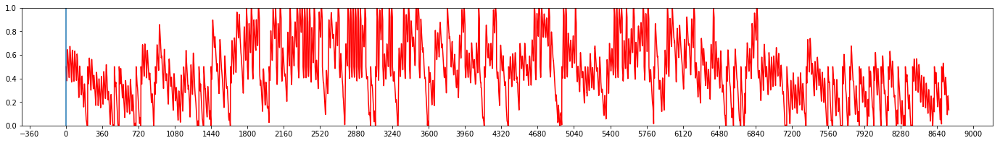

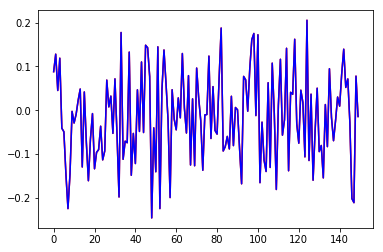

Iteration 1:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.007
Violation Counter 	= 89


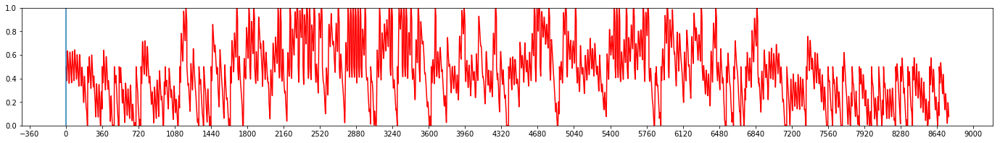

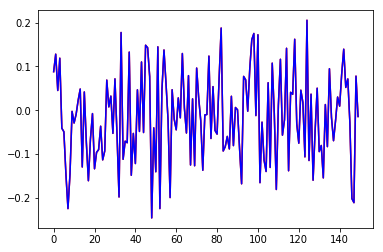

Iteration 2:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.459
Violation Counter 	= 129


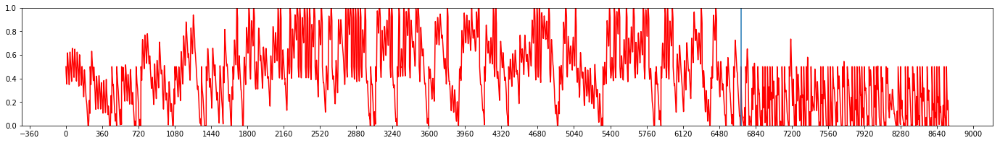

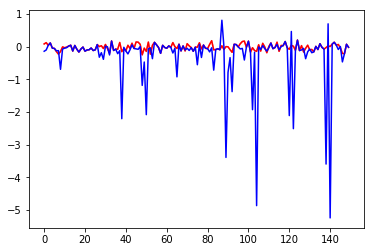

Iteration 3:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.232
Violation Counter 	= 110


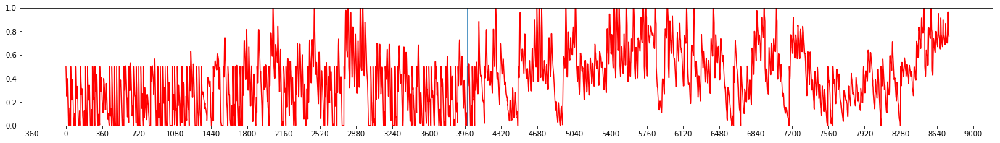

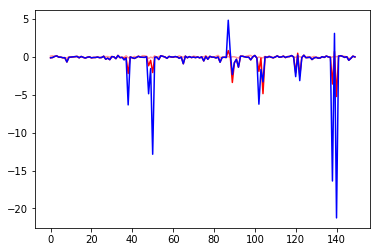

Iteration 4:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.071
Violation Counter 	= 89


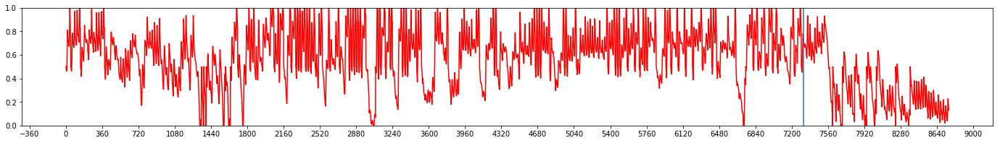

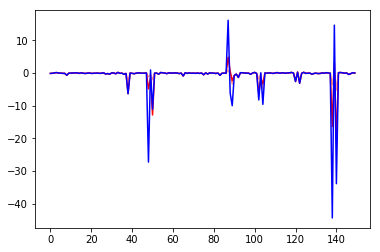

Iteration 5:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.084
Violation Counter 	= 75


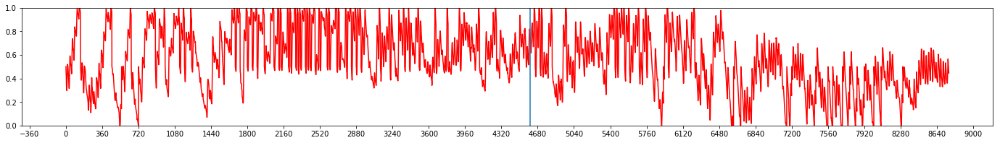

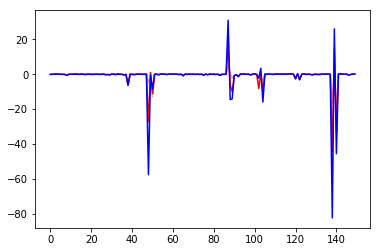

Iteration 6:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.396
Violation Counter 	= 56


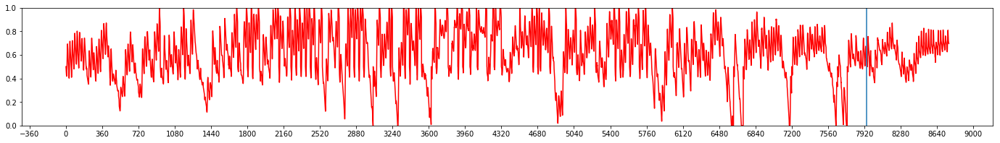

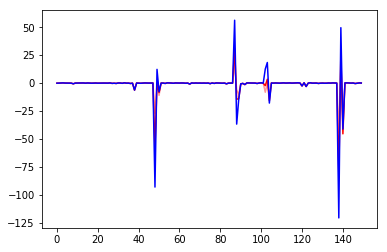

Iteration 7:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.421
Violation Counter 	= 58


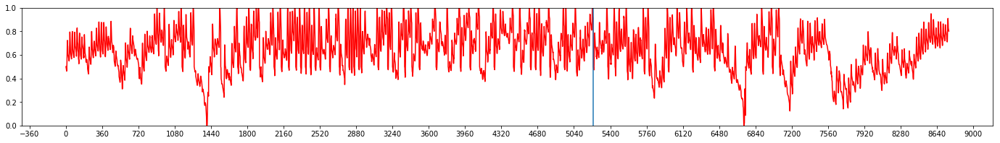

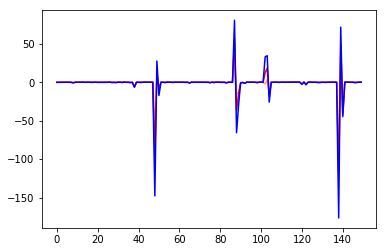

Iteration 8:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.842
Violation Counter 	= 36


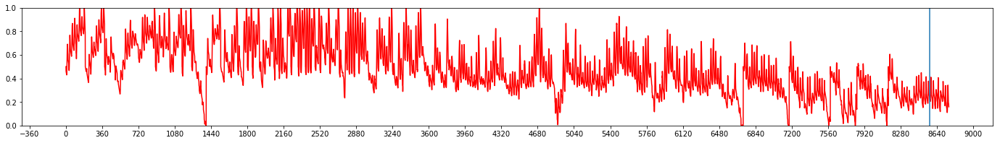

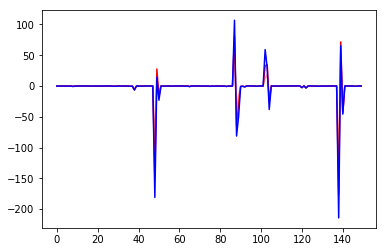

Iteration 9:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.625
Violation Counter 	= 47


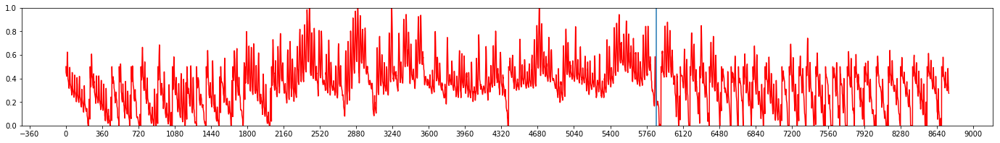

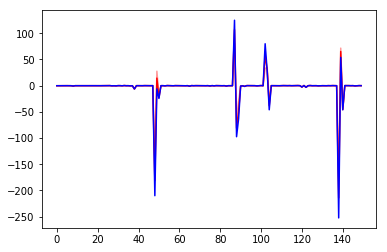

Iteration 10:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.953
Violation Counter 	= 32


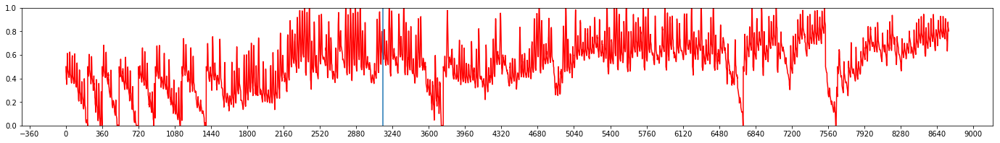

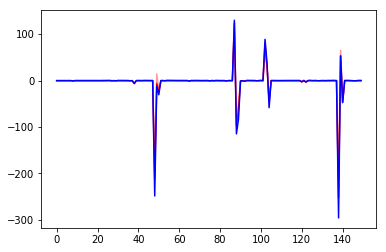

Iteration 11:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.752
Violation Counter 	= 61


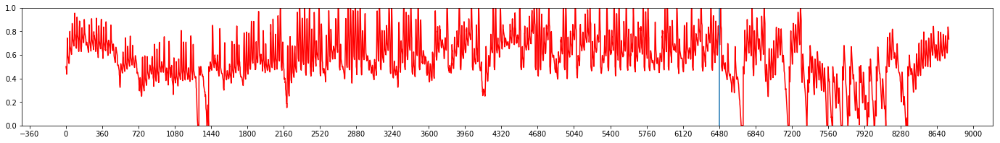

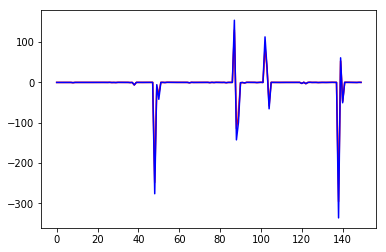

Iteration 12:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.687
Violation Counter 	= 65


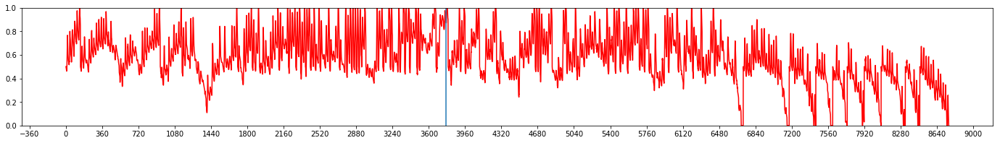

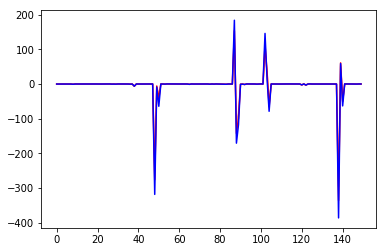

Iteration 13:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.068
Violation Counter 	= 33


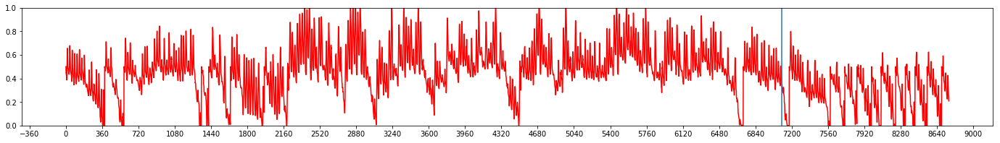

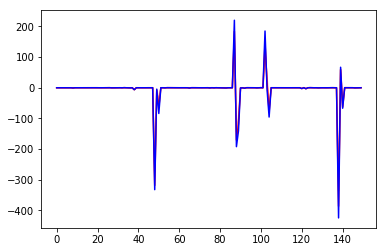

Iteration 14:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.163
Violation Counter 	= 35


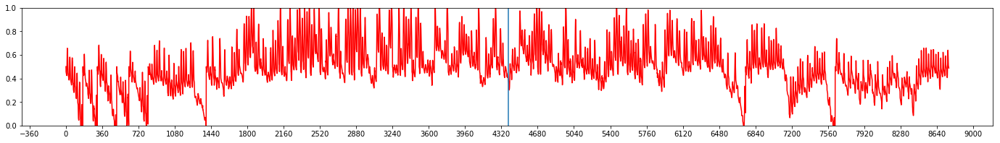

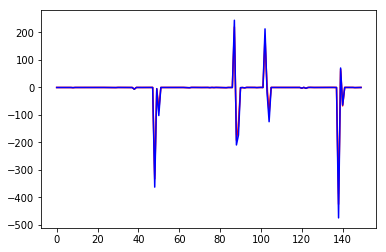

Iteration 15:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.006
Violation Counter 	= 45


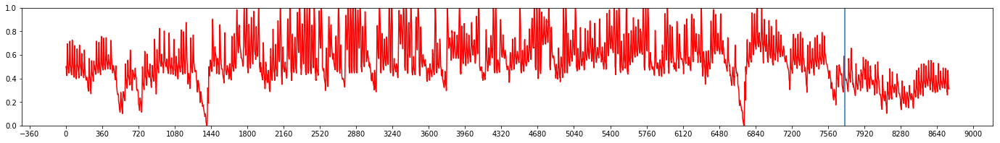

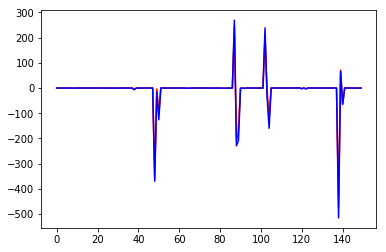

Iteration 16:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.862
Violation Counter 	= 60


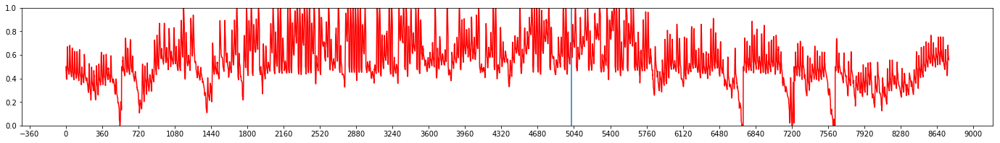

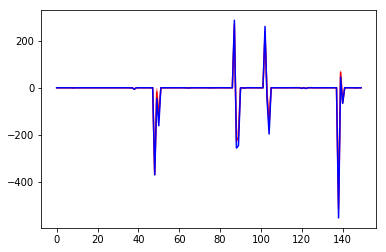

Iteration 17:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.160
Violation Counter 	= 34


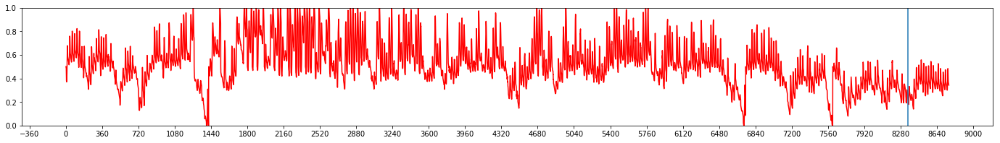

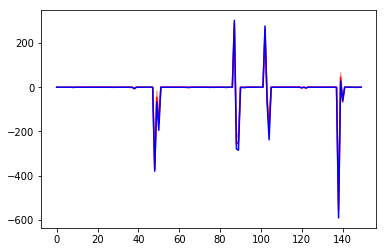

Iteration 18:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.244
Violation Counter 	= 21


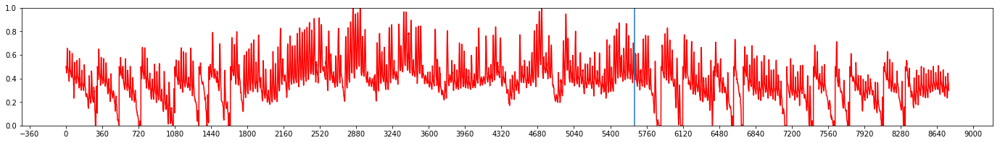

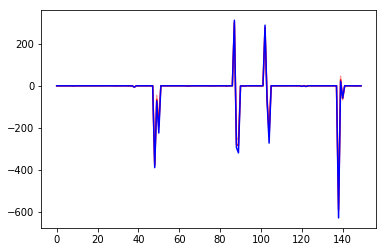

Iteration 19:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.099
Violation Counter 	= 17


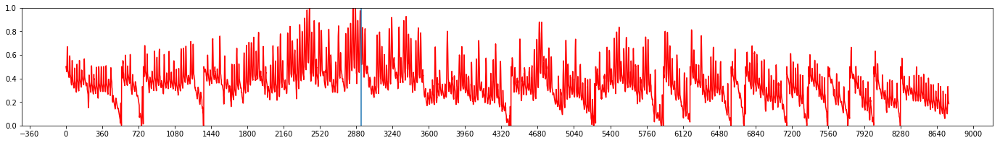

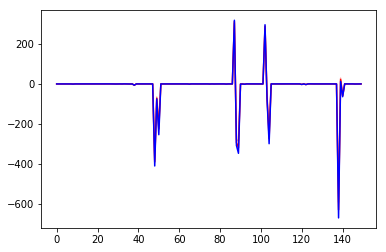

Iteration 20:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.013
Violation Counter 	= 20


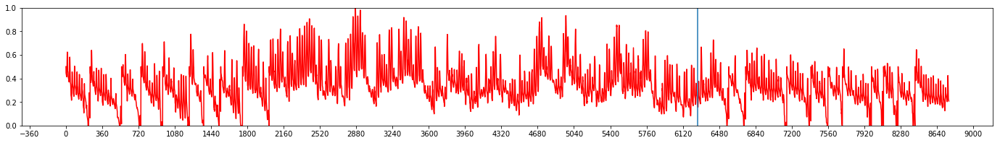

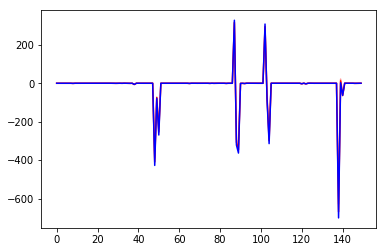

Iteration 21:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.344
Violation Counter 	= 13


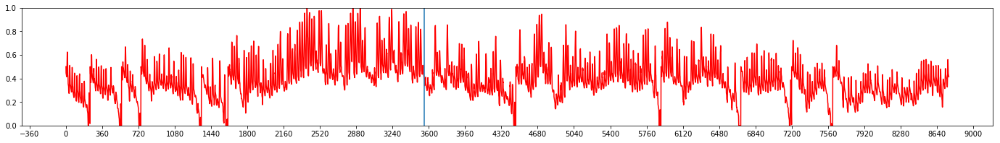

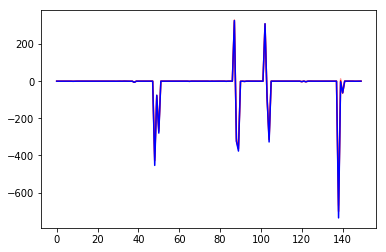

Iteration 22:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.479
Violation Counter 	= 20


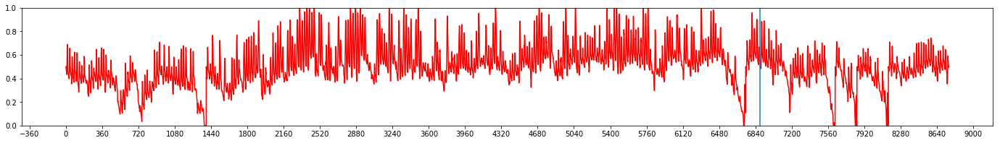

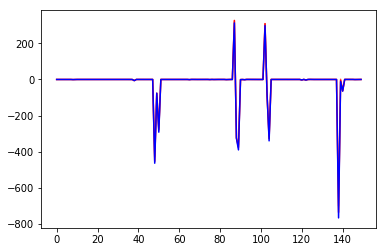

Iteration 23:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.299
Violation Counter 	= 39


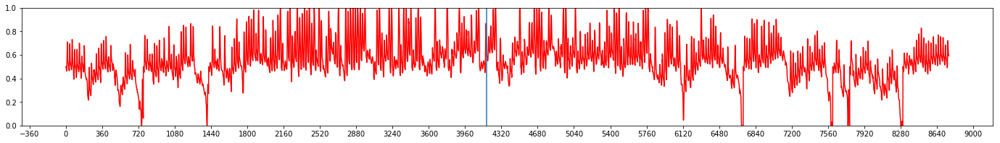

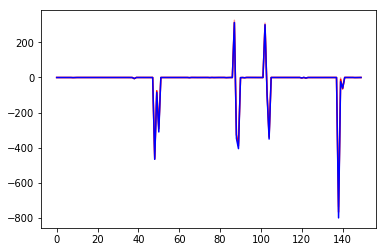

Iteration 24:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.244
Violation Counter 	= 35


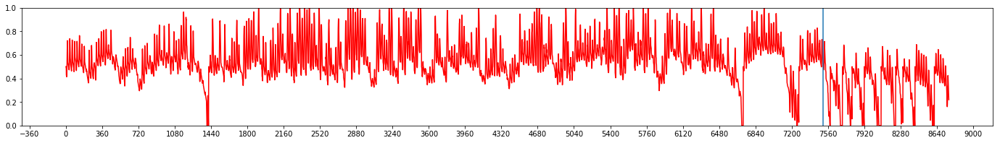

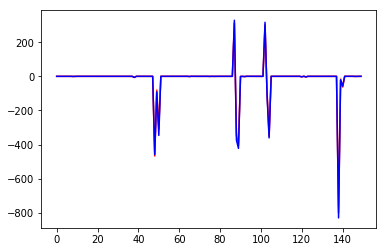

Iteration 25:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.533
Violation Counter 	= 74


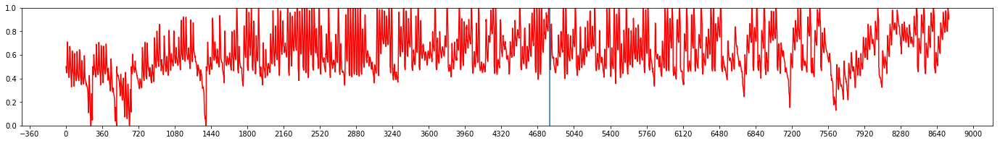

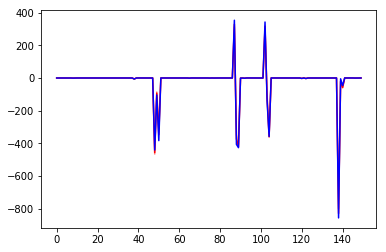

Iteration 26:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.935
Violation Counter 	= 53


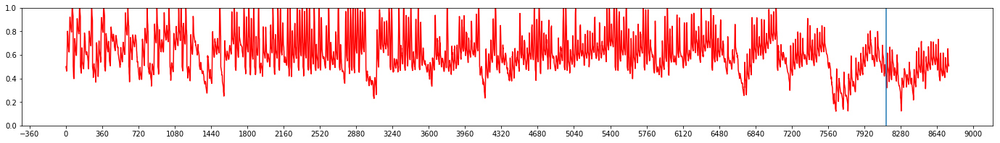

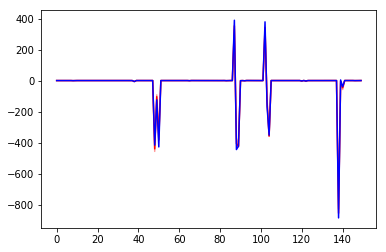

Iteration 27:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.843
Violation Counter 	= 52


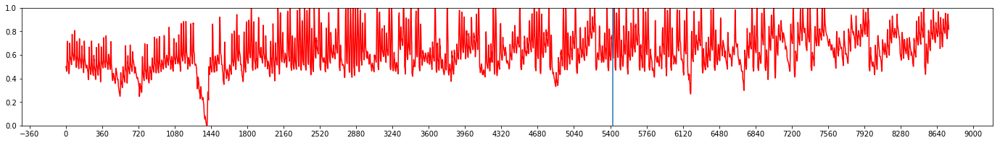

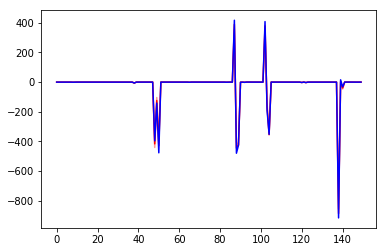

Iteration 28:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.196
Violation Counter 	= 94


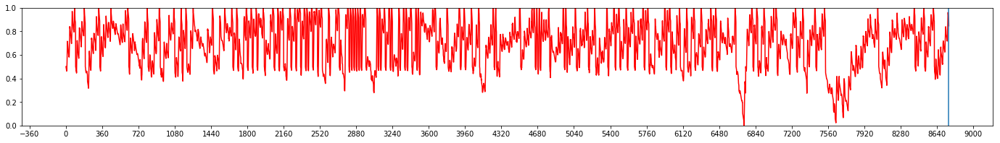

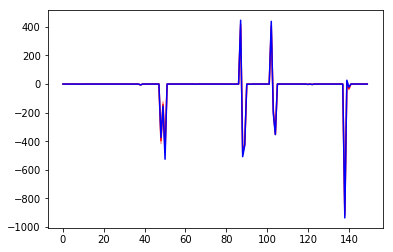

Iteration 29:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.155
Violation Counter 	= 79


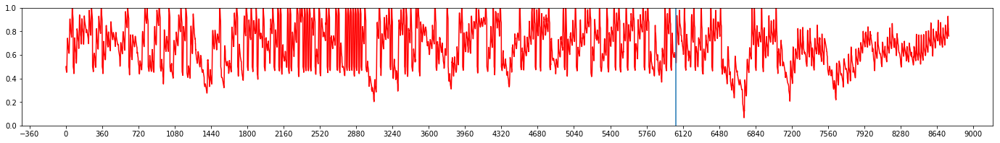

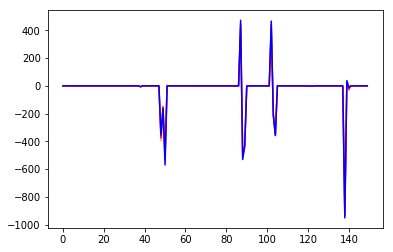

Iteration 30:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.937
Violation Counter 	= 45


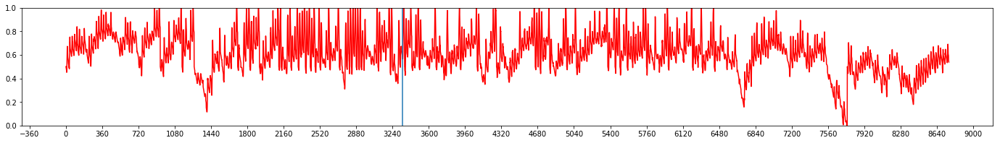

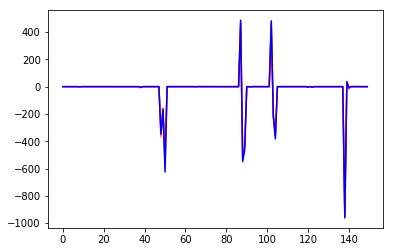

Iteration 31:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.344
Violation Counter 	= 22


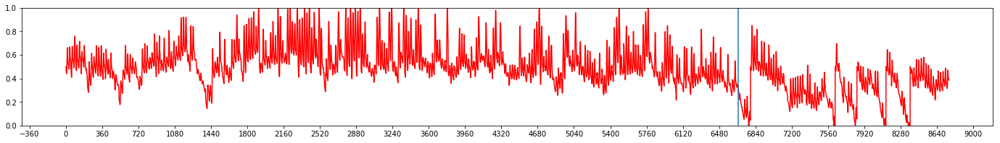

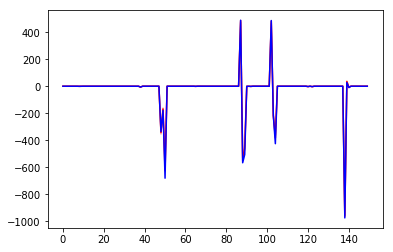

Iteration 32:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.968
Violation Counter 	= 39


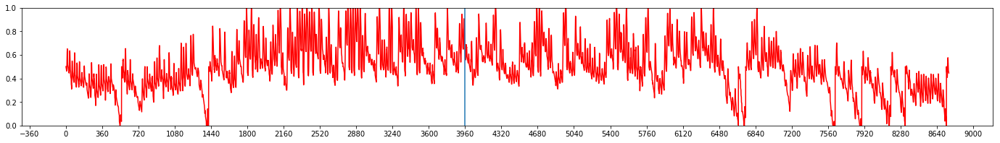

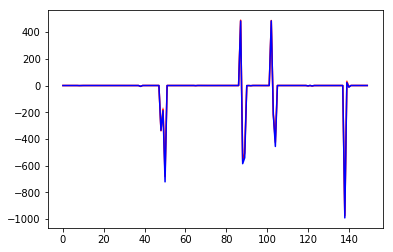

Iteration 33:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.919
Violation Counter 	= 45


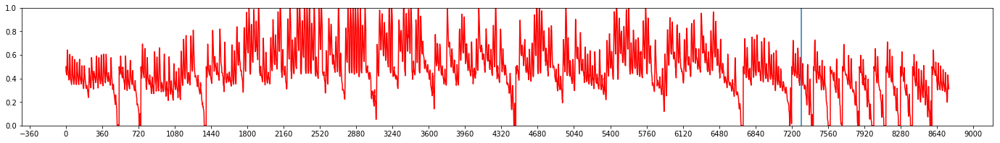

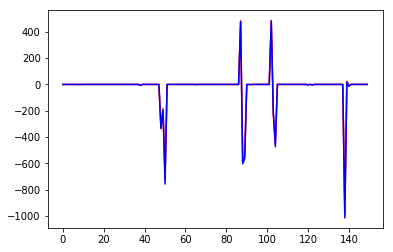

Iteration 34:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.962
Violation Counter 	= 43


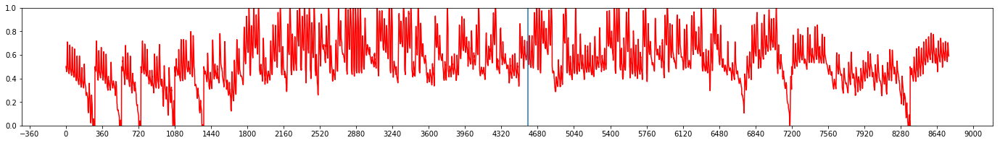

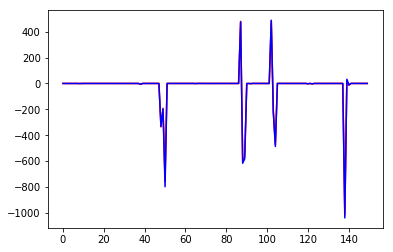

Iteration 35:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.446
Violation Counter 	= 77


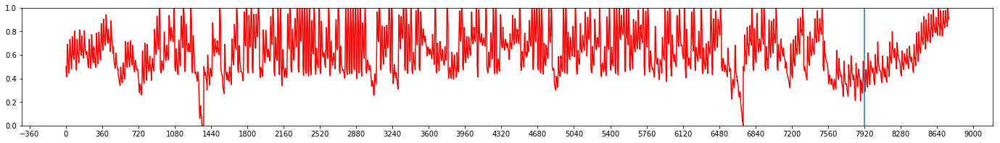

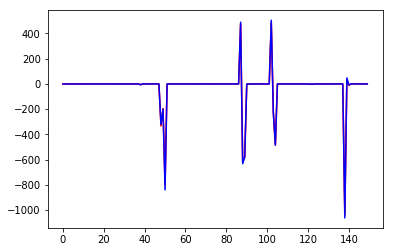

Iteration 36:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.401
Violation Counter 	= 79


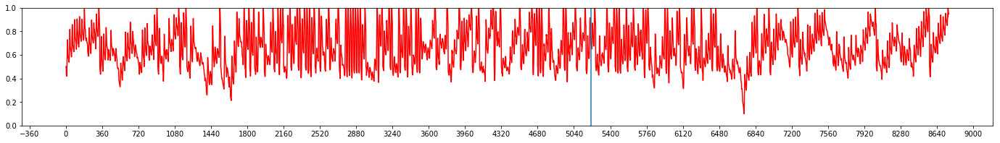

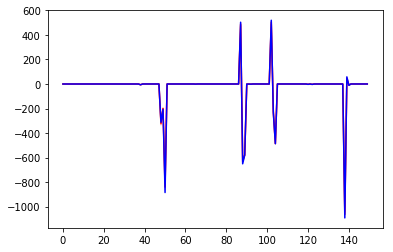

Iteration 37:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.291
Violation Counter 	= 74


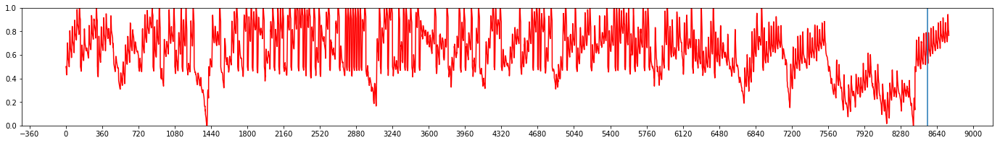

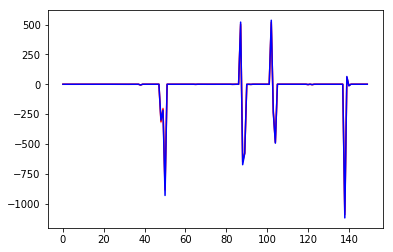

Iteration 38:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.765
Violation Counter 	= 50


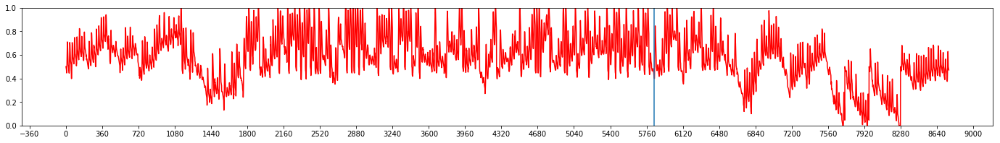

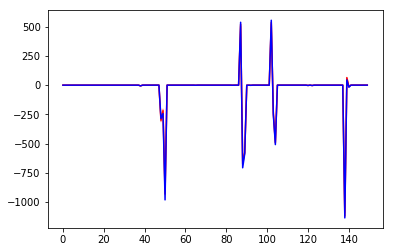

Iteration 39:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.098
Violation Counter 	= 27


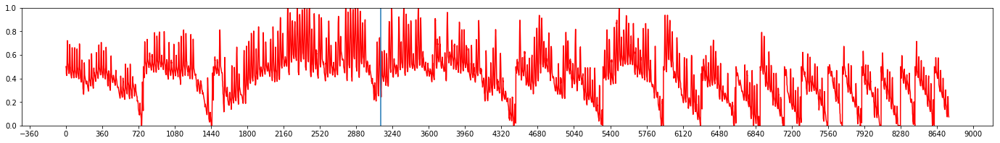

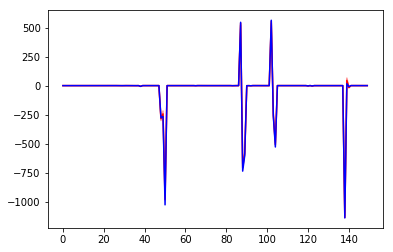

Iteration 40:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.892
Violation Counter 	= 38


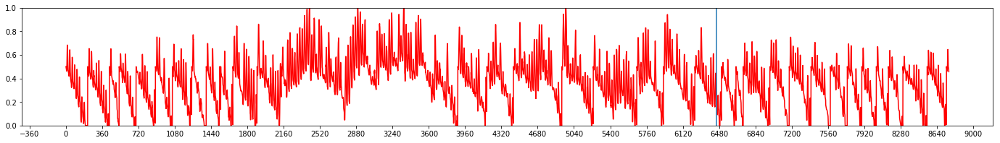

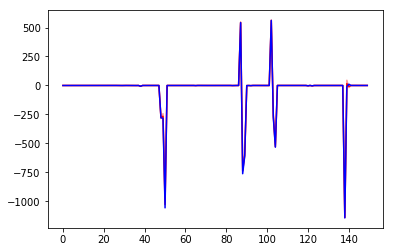

Iteration 41:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.893
Violation Counter 	= 38


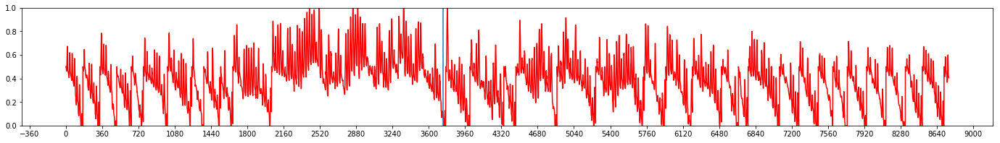

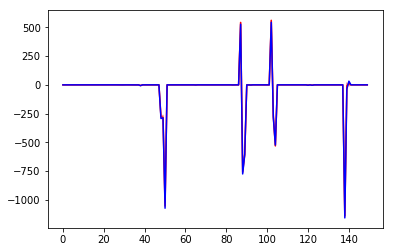

Iteration 42:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.781
Violation Counter 	= 42


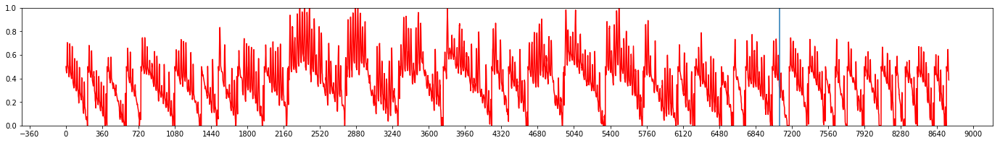

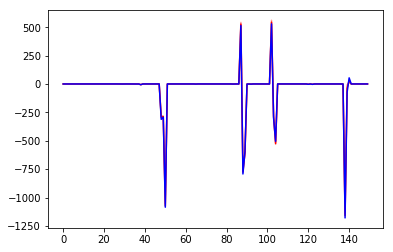

Iteration 43:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.867
Violation Counter 	= 44


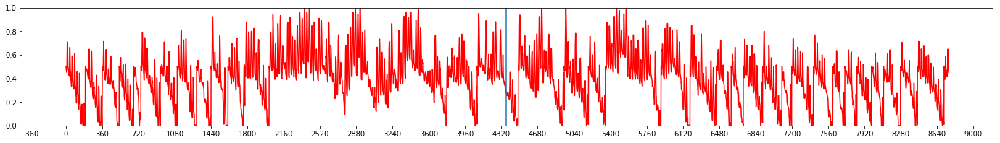

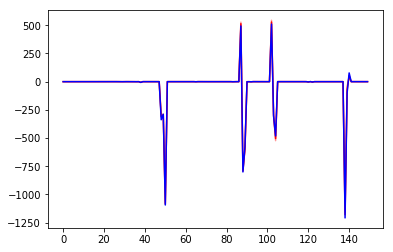

Iteration 44:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.034
Violation Counter 	= 32


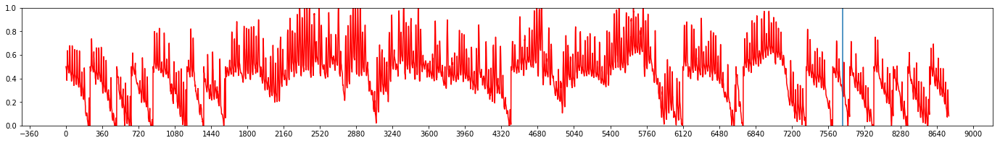

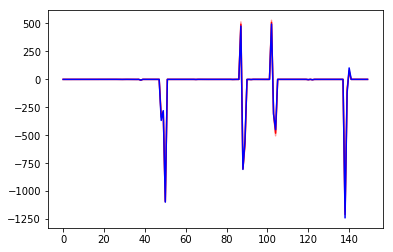

Iteration 45:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.903
Violation Counter 	= 46


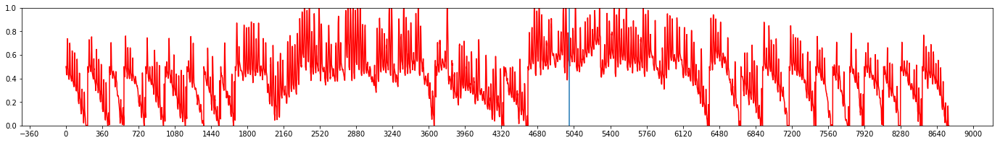

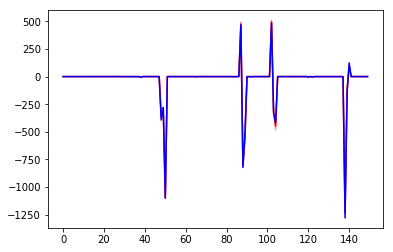

Iteration 46:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.948
Violation Counter 	= 47


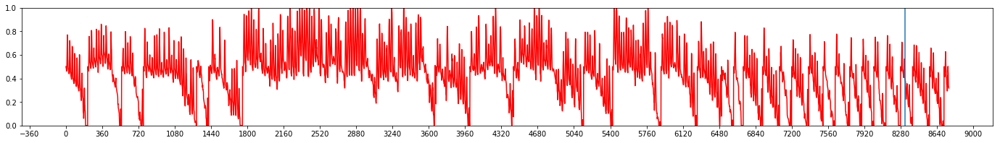

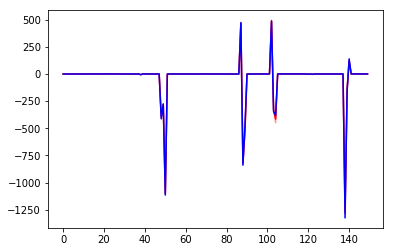

Iteration 47:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.415
Violation Counter 	= 62


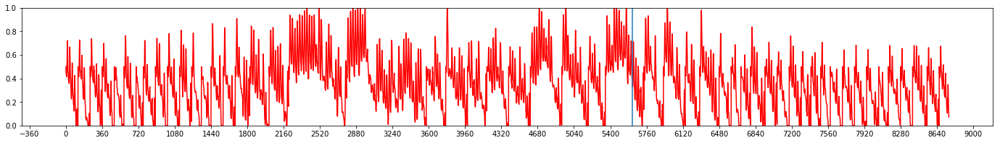

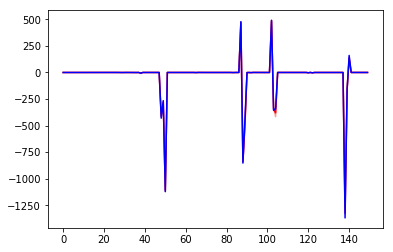

Iteration 48:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.661
Violation Counter 	= 54


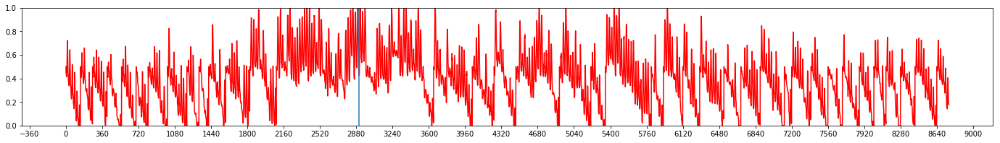

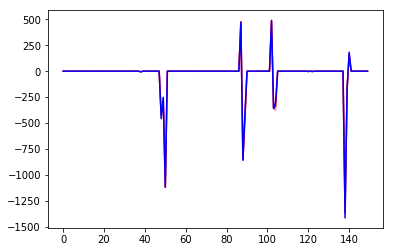

Iteration 49:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.571
Violation Counter 	= 60


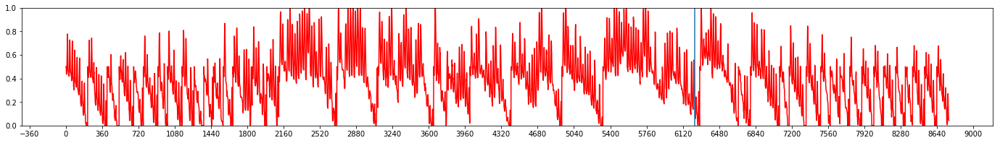

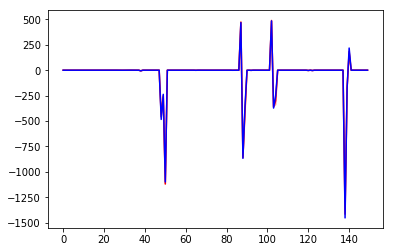

Iteration 50:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.778
Violation Counter 	= 54


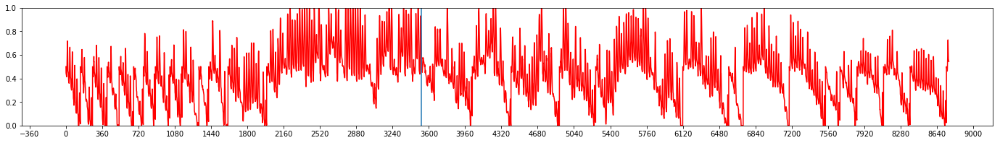

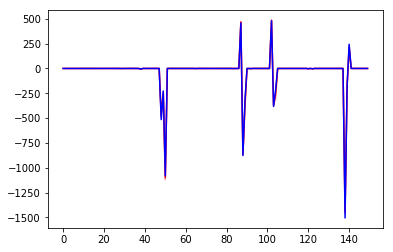

Iteration 51:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.884
Violation Counter 	= 71


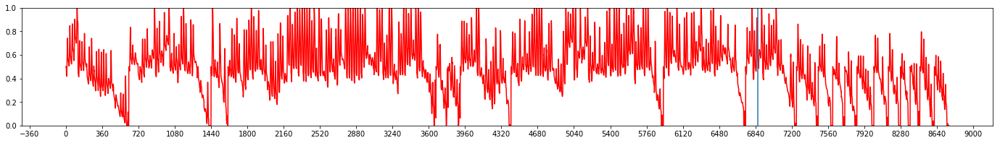

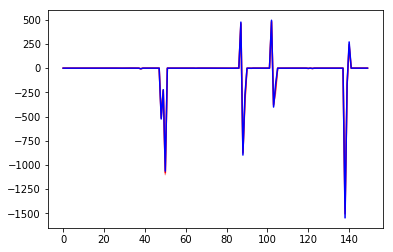

Iteration 52:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.716
Violation Counter 	= 76


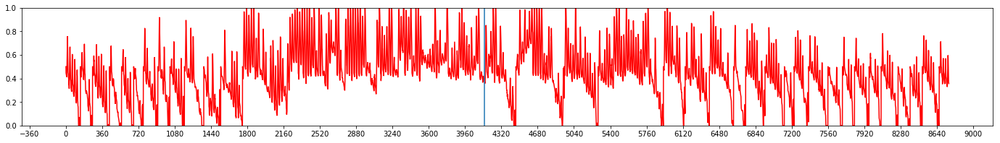

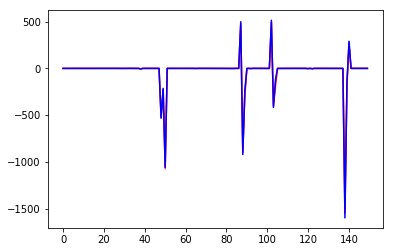

Iteration 53:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.960
Violation Counter 	= 63


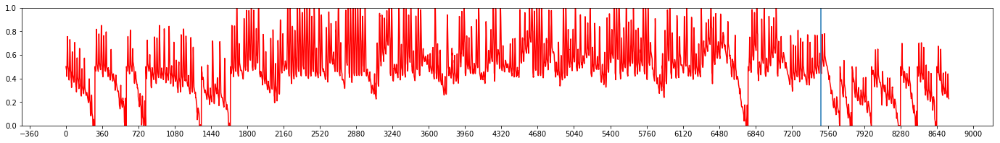

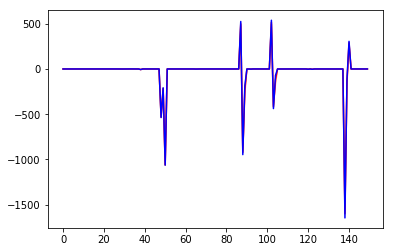

Iteration 54:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.814
Violation Counter 	= 56


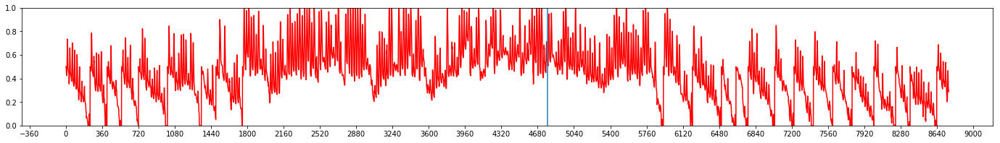

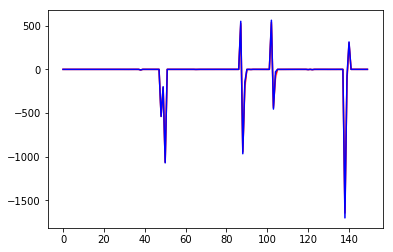

Iteration 55:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.384
Violation Counter 	= 46


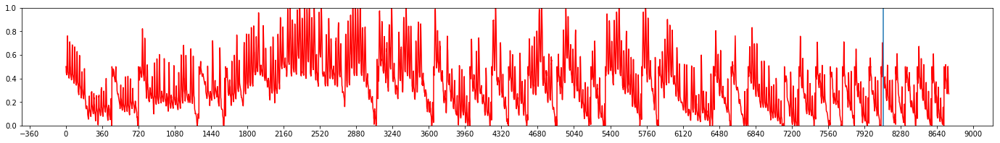

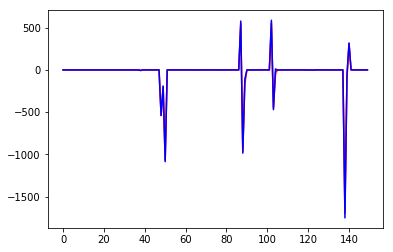

Iteration 56:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.228
Violation Counter 	= 70


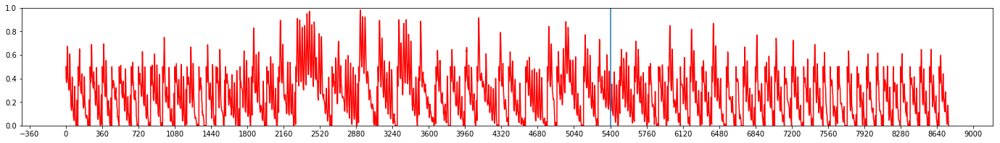

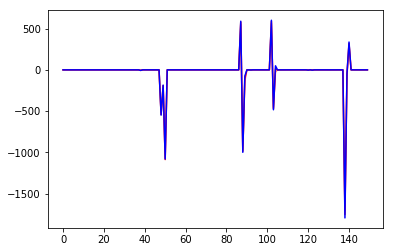

Iteration 57:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.378
Violation Counter 	= 89


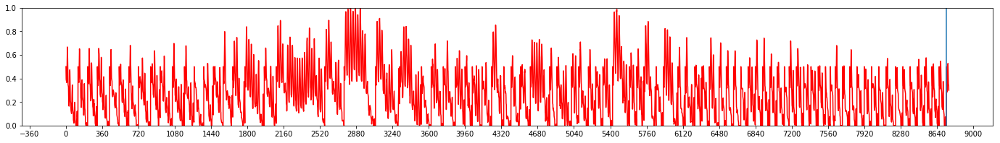

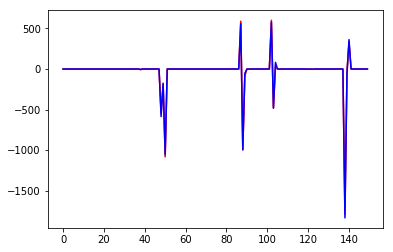

Iteration 58:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.616
Violation Counter 	= 119


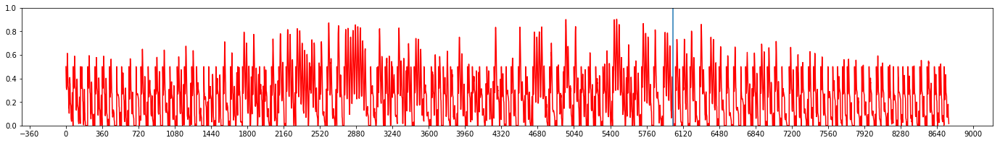

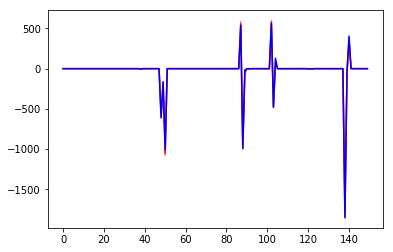

Iteration 59:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.350
Violation Counter 	= 89


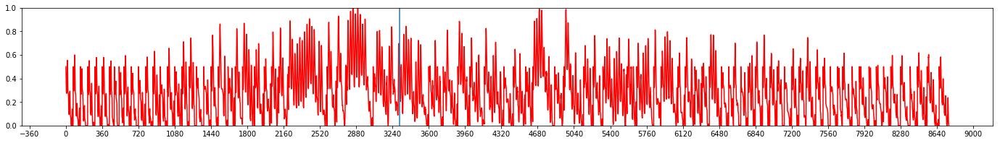

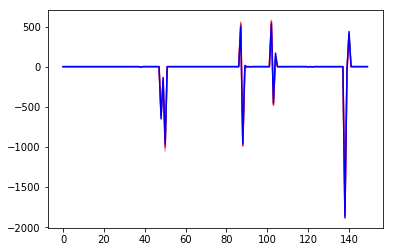

Iteration 60:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.041
Violation Counter 	= 63


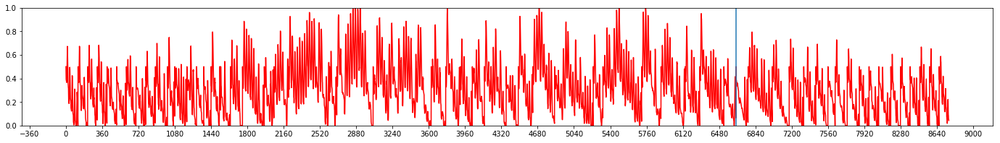

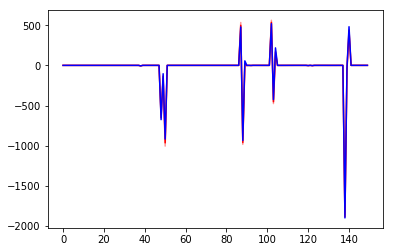

Iteration 61:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.097
Violation Counter 	= 61


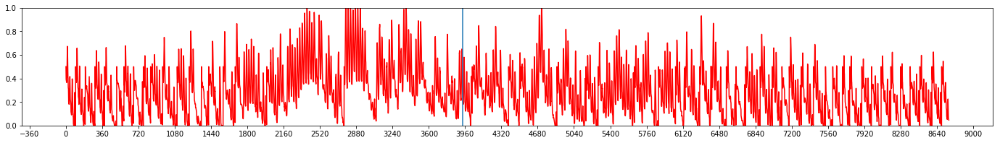

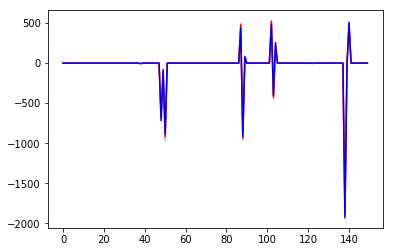

Iteration 62:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.305
Violation Counter 	= 88


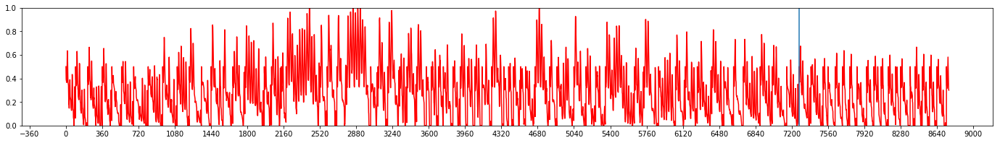

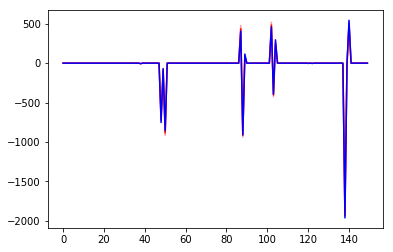

Iteration 63:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.264
Violation Counter 	= 99


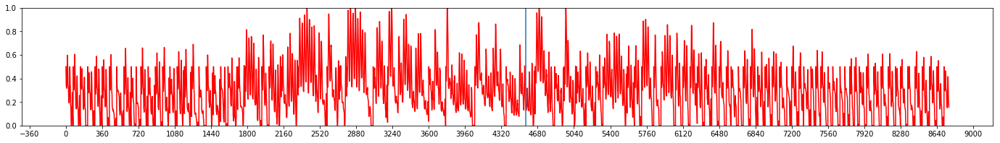

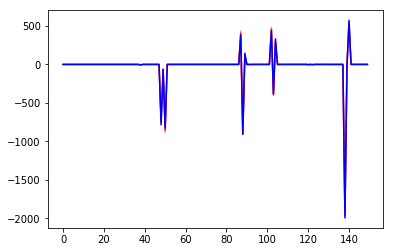

Iteration 64:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.267
Violation Counter 	= 86


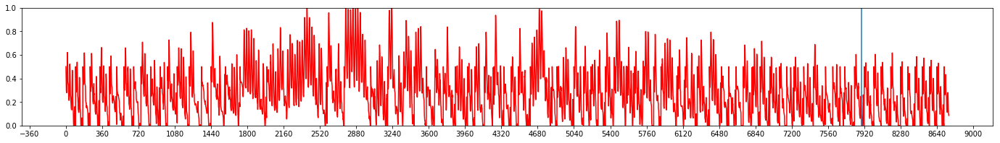

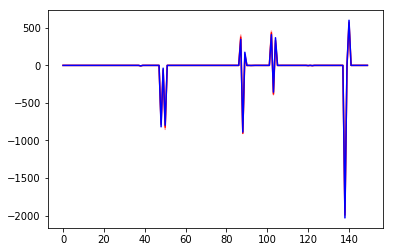

Iteration 65:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.260
Violation Counter 	= 73


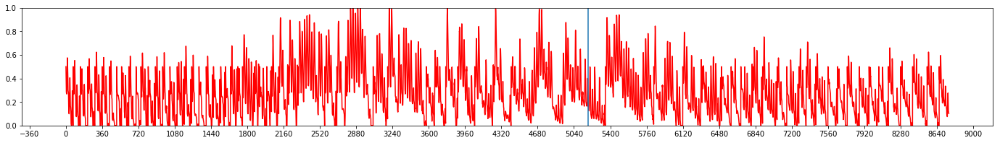

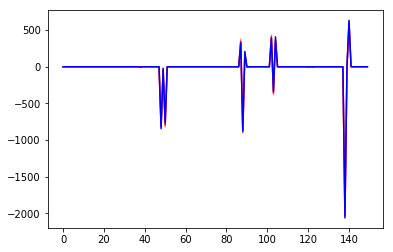

Iteration 66:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.028
Violation Counter 	= 32


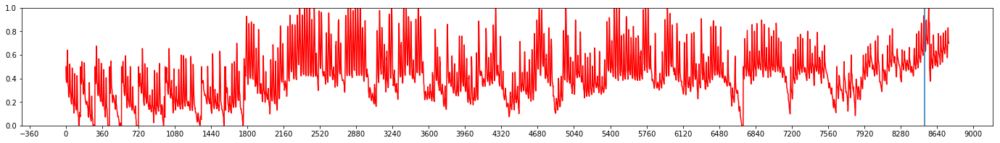

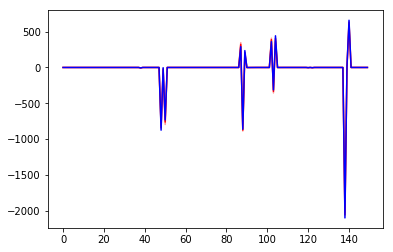

Iteration 67:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.534
Violation Counter 	= 102


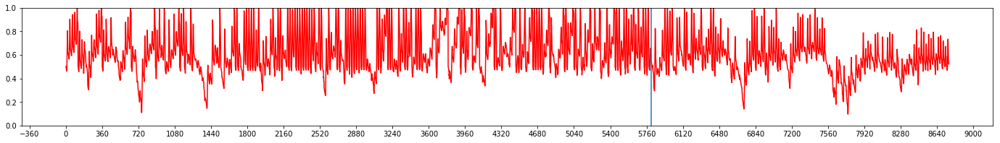

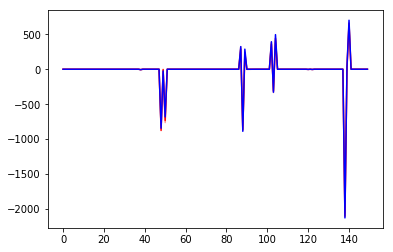

Iteration 68:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.680
Violation Counter 	= 83


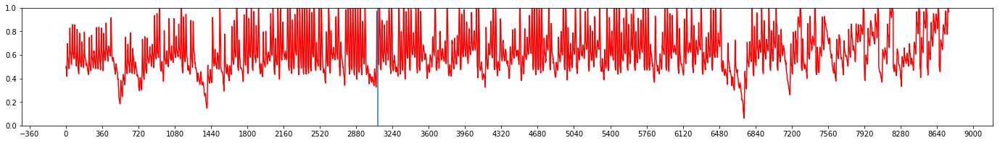

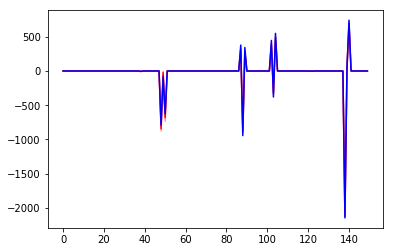

Iteration 69:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.269
Violation Counter 	= 112


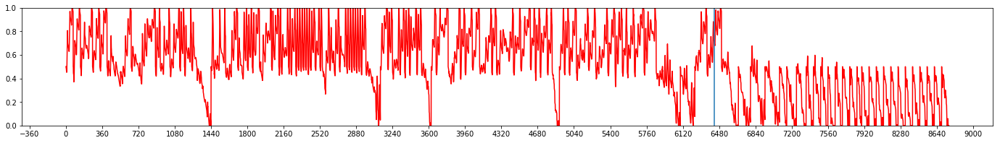

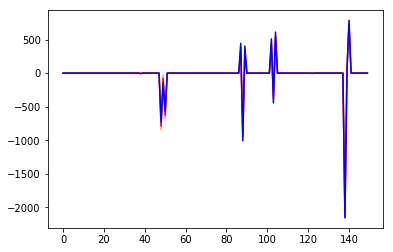

Iteration 70:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.501
Violation Counter 	= 87


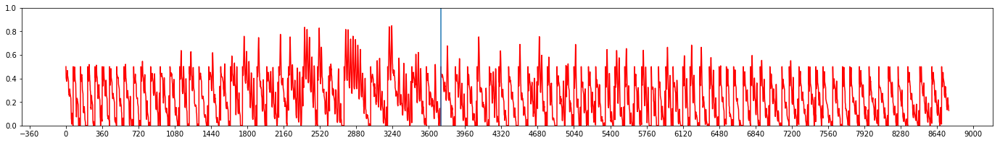

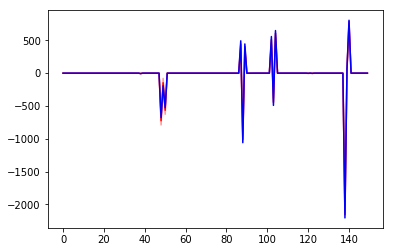

Iteration 71:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.978
Violation Counter 	= 128


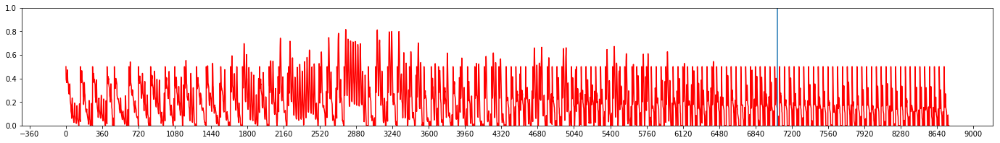

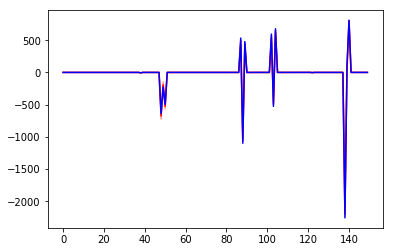

Iteration 72:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.570
Violation Counter 	= 181


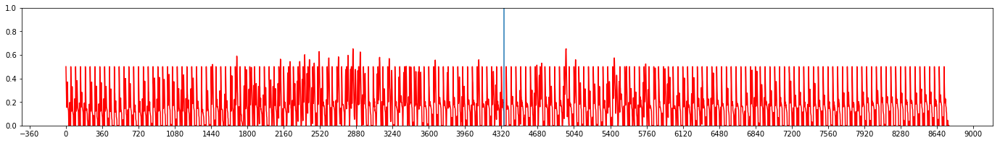

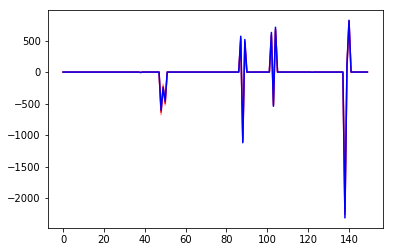

Iteration 73:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.256
Violation Counter 	= 145


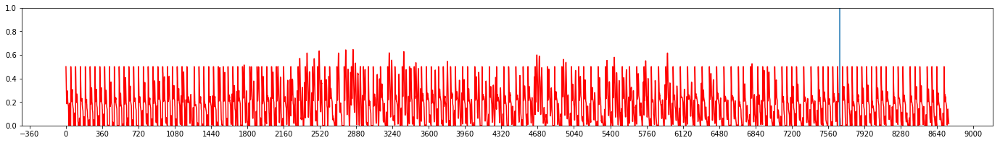

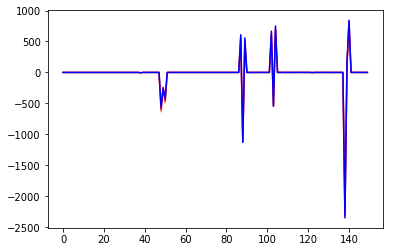

Iteration 74:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.321
Violation Counter 	= 157


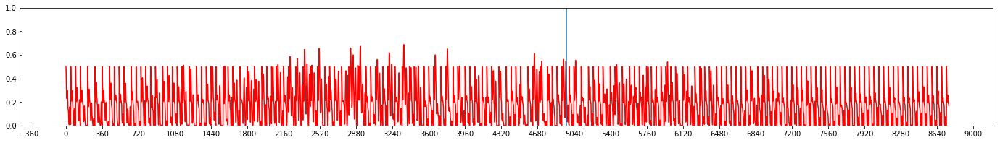

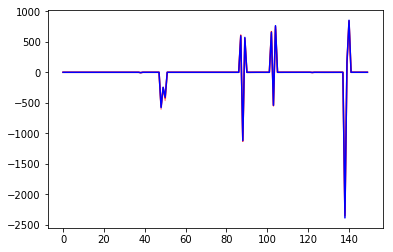

Iteration 75:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.977
Violation Counter 	= 110


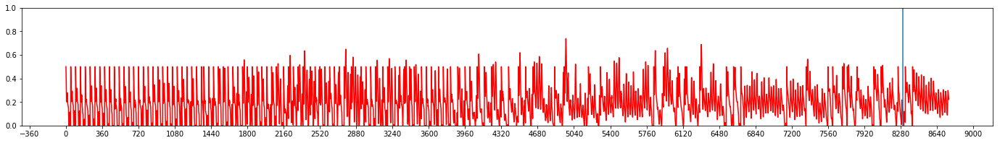

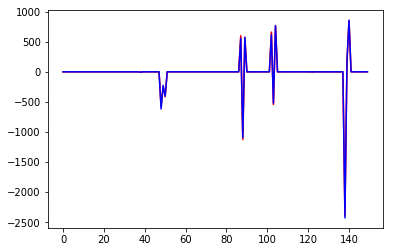

Iteration 76:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.466
Violation Counter 	= 53


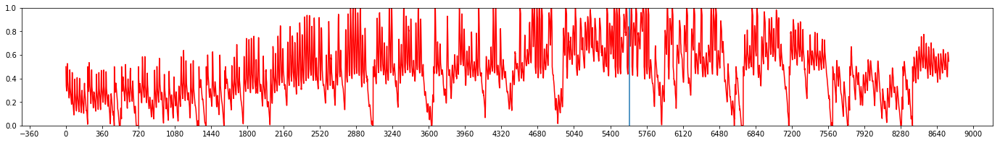

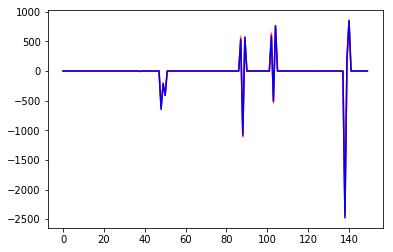

Iteration 77:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.510
Violation Counter 	= 59


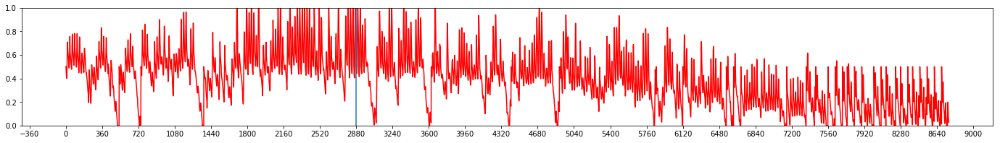

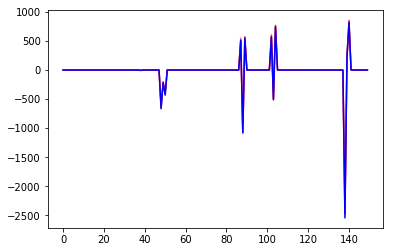

Iteration 78:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.724
Violation Counter 	= 210


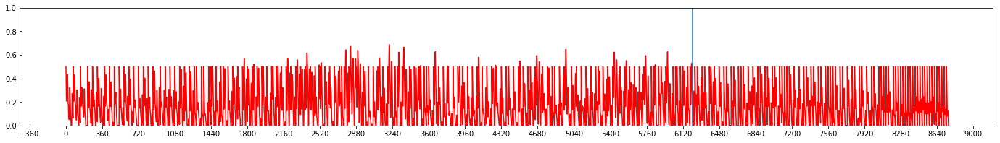

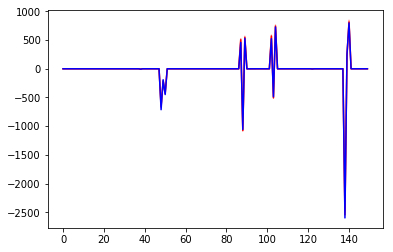

Iteration 79:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.586
Violation Counter 	= 188


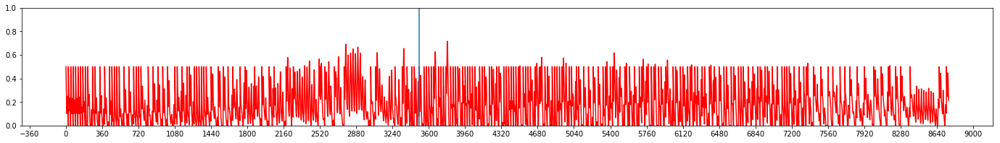

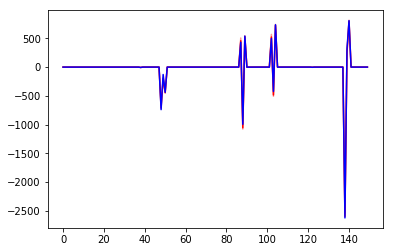

Iteration 80:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.300
Violation Counter 	= 157


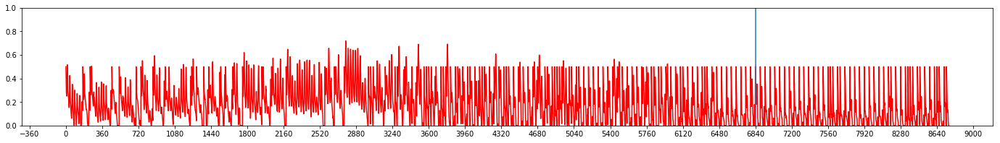

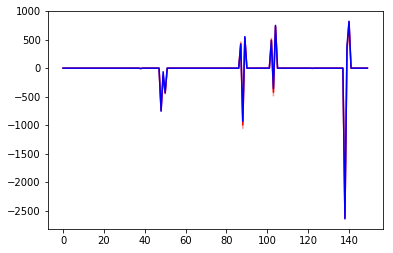

Iteration 81:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.131
Violation Counter 	= 103


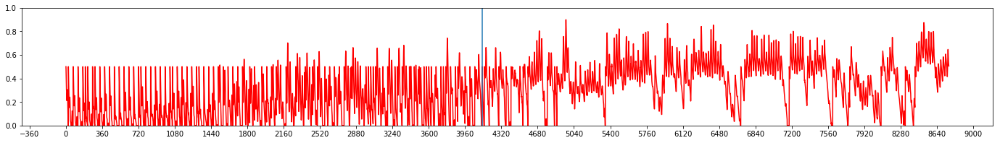

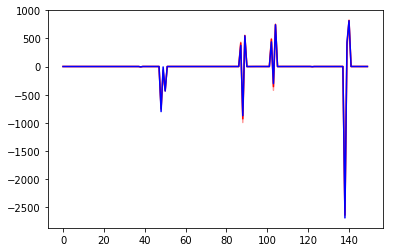

Iteration 82:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.563
Violation Counter 	= 58


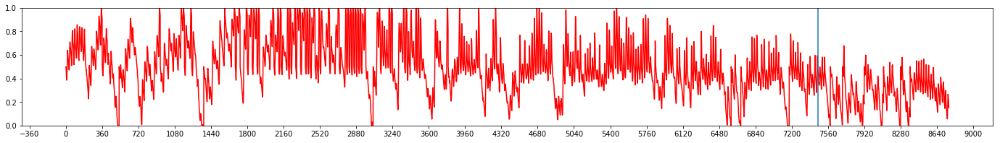

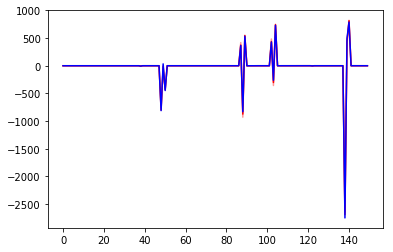

Iteration 83:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.143
Violation Counter 	= 44


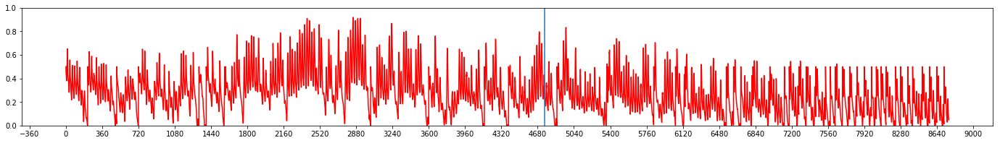

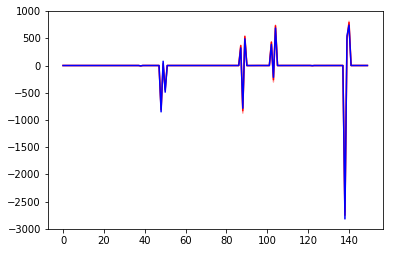

Iteration 84:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.575
Violation Counter 	= 190


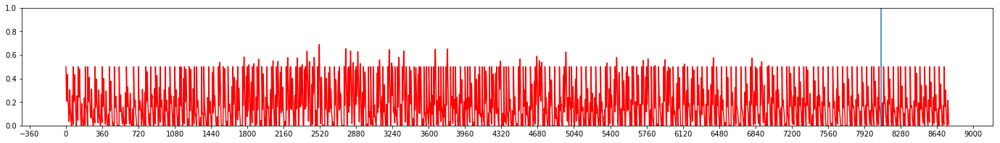

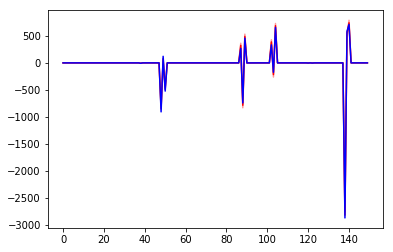

Iteration 85:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.428
Violation Counter 	= 178


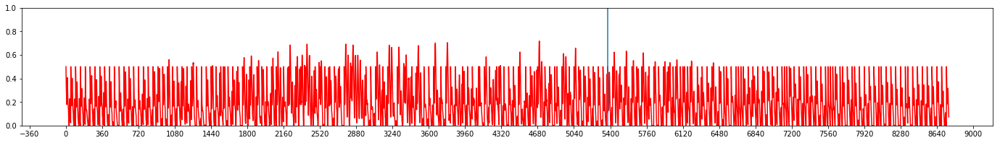

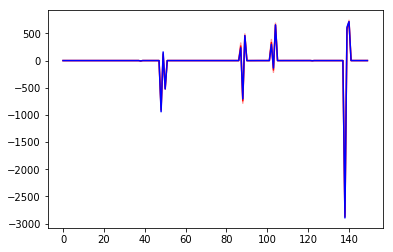

Iteration 86:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.375
Violation Counter 	= 85


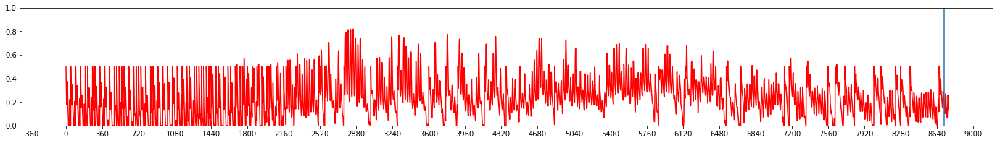

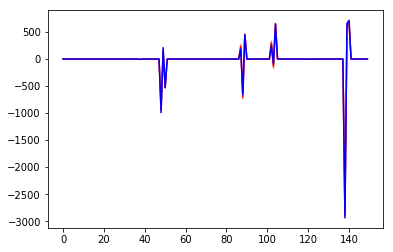

Iteration 87:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.992
Violation Counter 	= 108


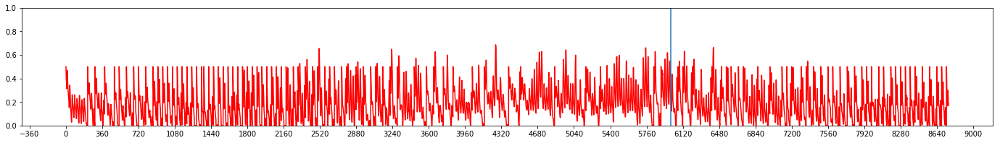

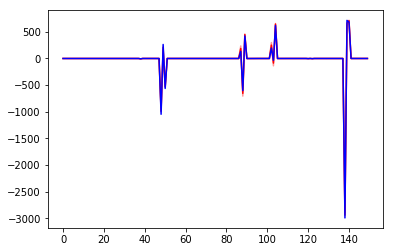

Iteration 88:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.153
Violation Counter 	= 126


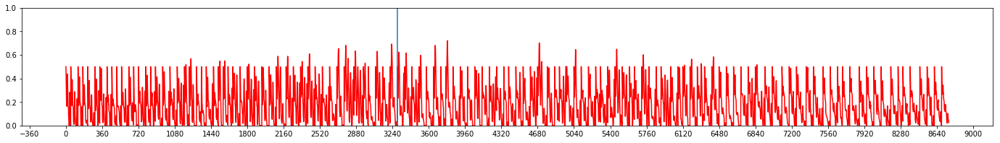

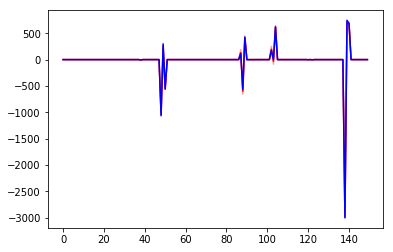

Iteration 89:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.743
Violation Counter 	= 99


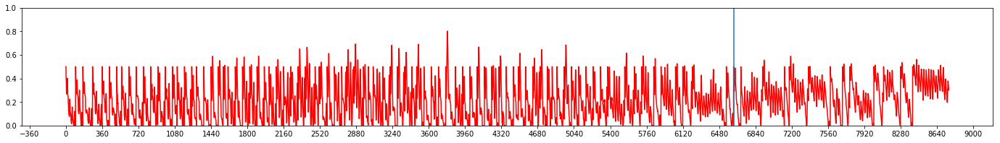

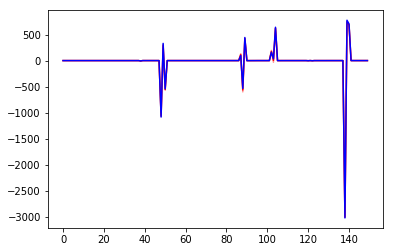

Iteration 90:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.231
Violation Counter 	= 69


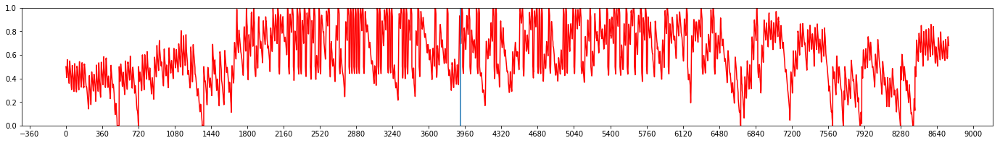

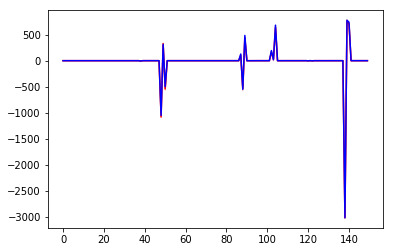

Iteration 91:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.069
Violation Counter 	= 29


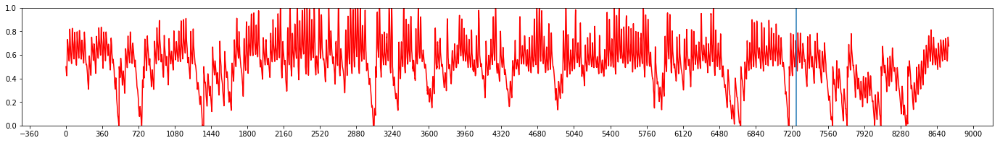

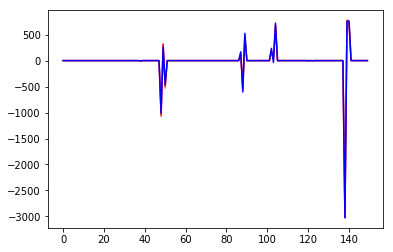

Iteration 92:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.017
Violation Counter 	= 98


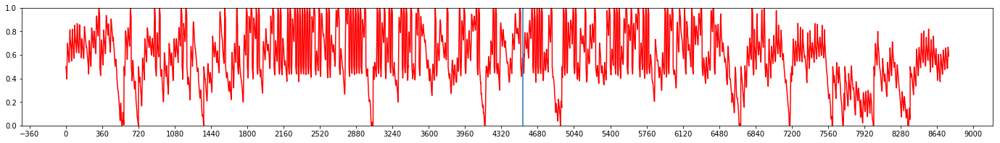

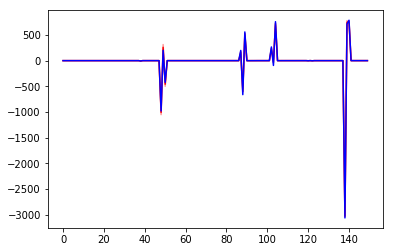

Iteration 93:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.346
Violation Counter 	= 70


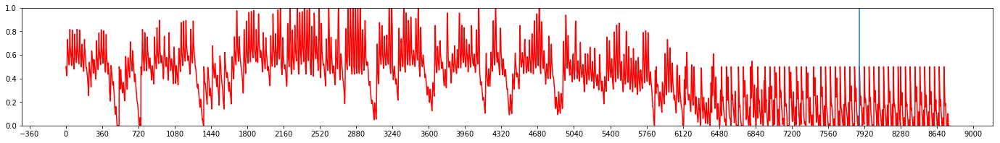

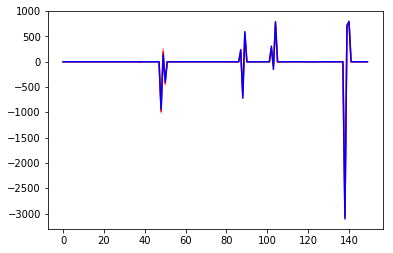

Iteration 94:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.784
Violation Counter 	= 114


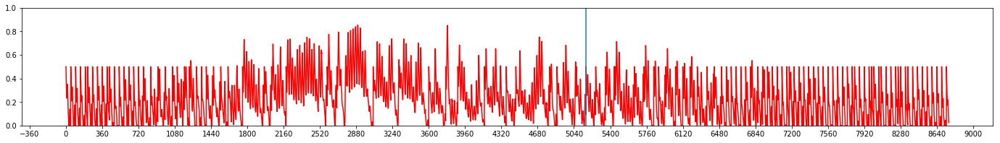

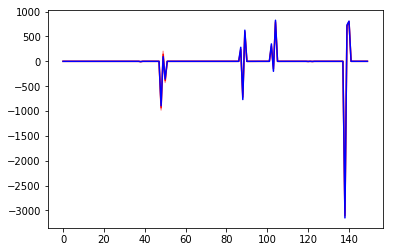

Iteration 95:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.166
Violation Counter 	= 130


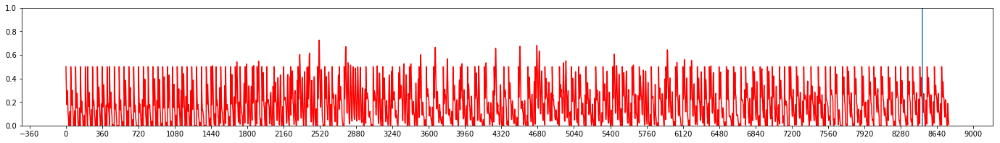

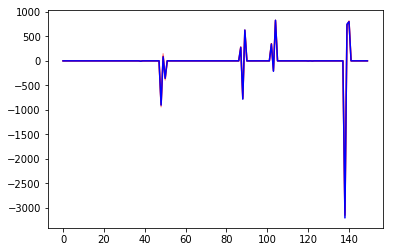

Iteration 96:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.795
Violation Counter 	= 85


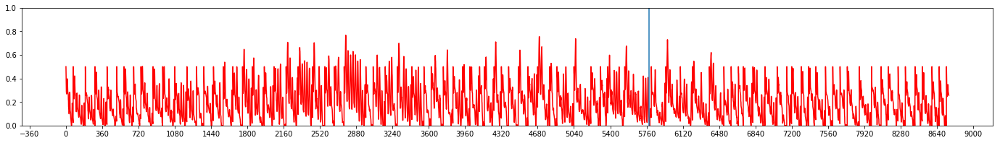

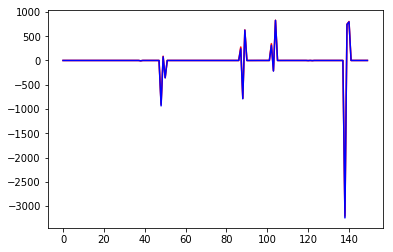

Iteration 97:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.097
Violation Counter 	= 122


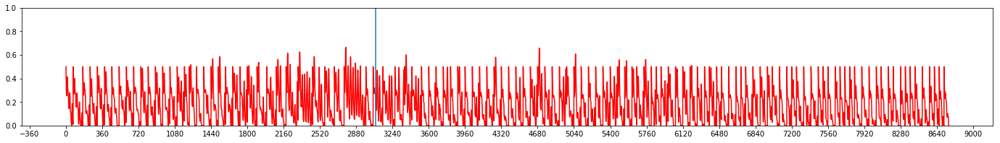

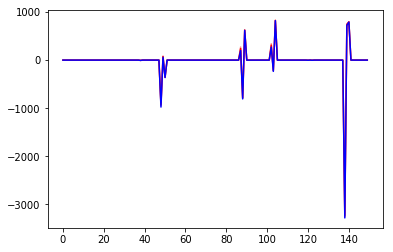

Iteration 98:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.331
Violation Counter 	= 148


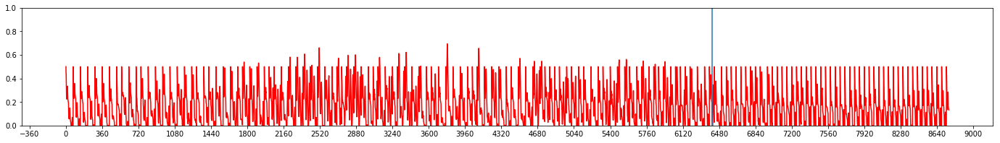

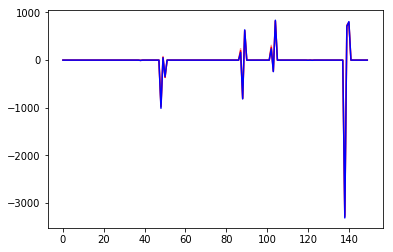

Iteration 99:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.528
Violation Counter 	= 174


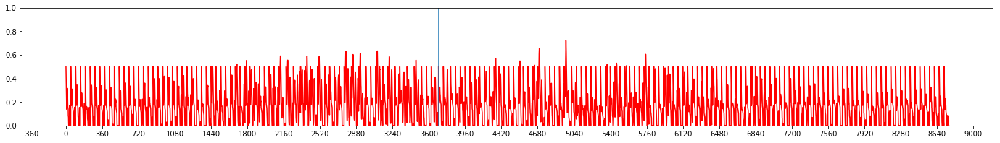

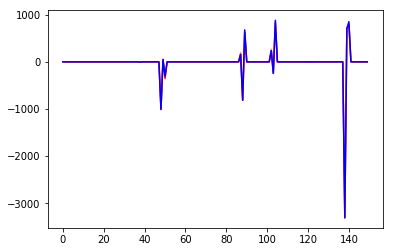

Iteration 100:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.324
Violation Counter 	= 151


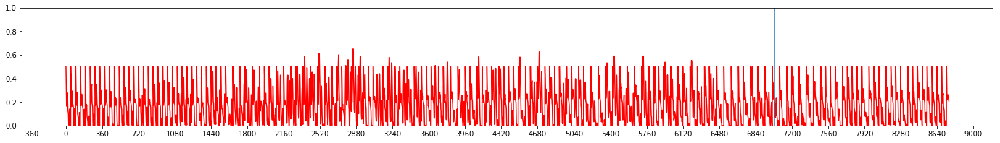

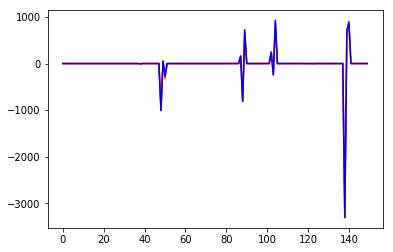

Iteration 101:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.467
Violation Counter 	= 173


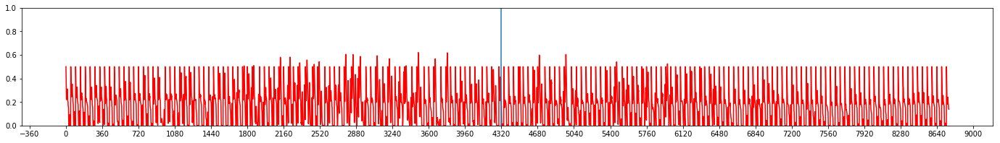

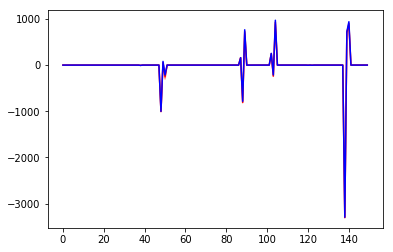

Iteration 102:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.368
Violation Counter 	= 160


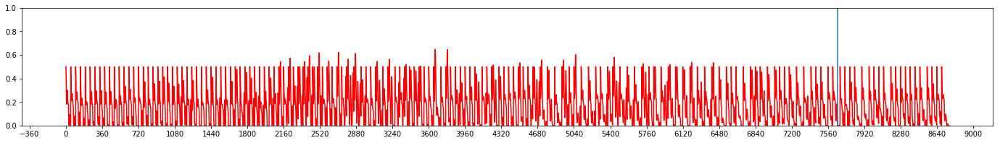

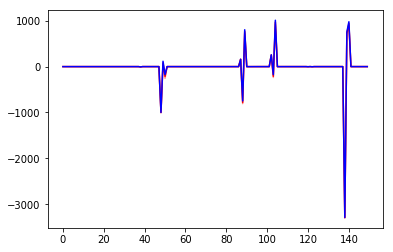

Iteration 103:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.289
Violation Counter 	= 147


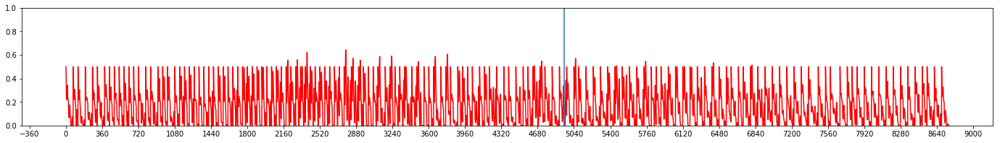

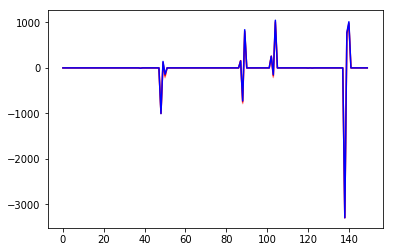

Iteration 104:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.246
Violation Counter 	= 139


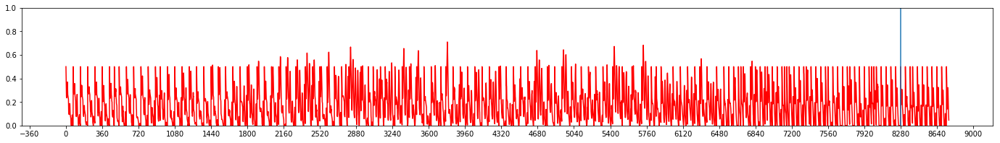

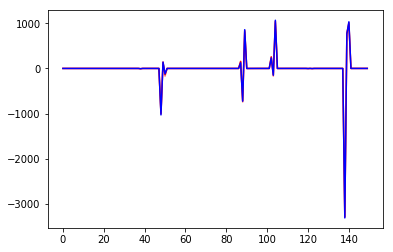

Iteration 105:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.565
Violation Counter 	= 179


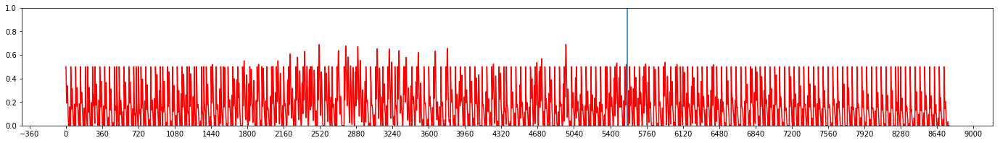

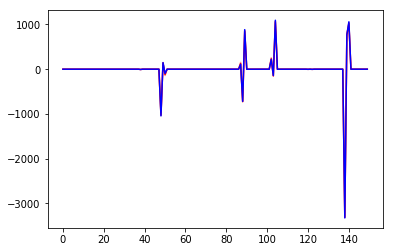

Iteration 106:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.312
Violation Counter 	= 146


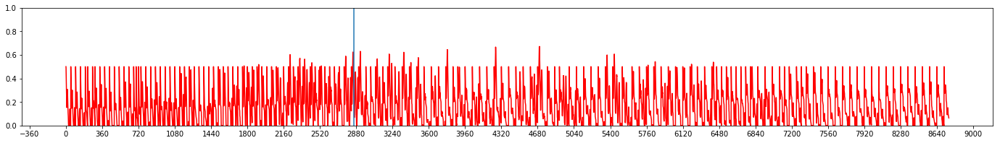

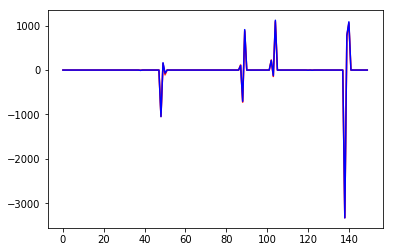

Iteration 107:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.240
Violation Counter 	= 140


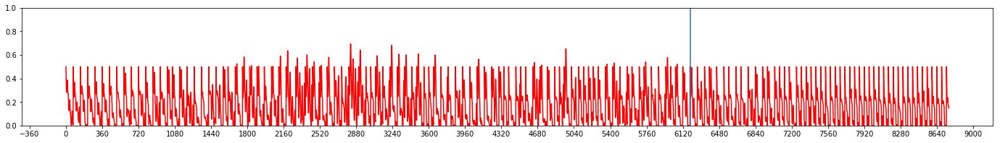

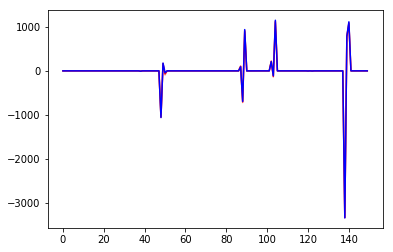

Iteration 108:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.247
Violation Counter 	= 138


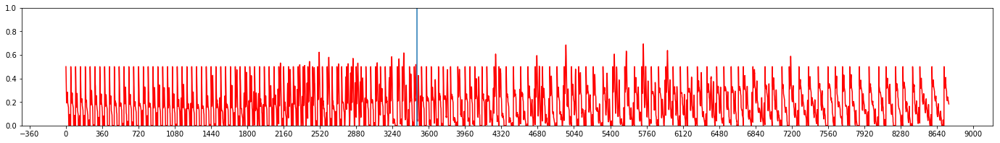

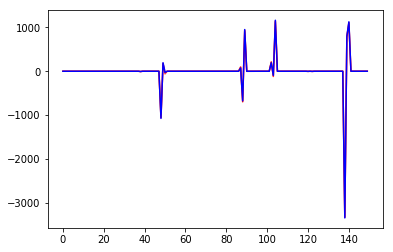

Iteration 109:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.800
Violation Counter 	= 108


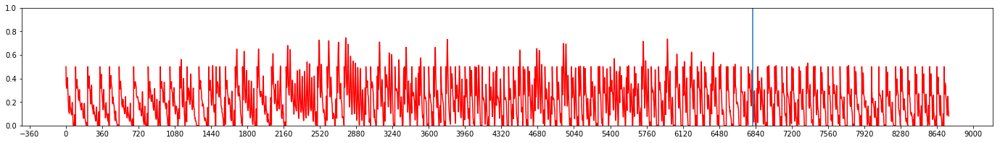

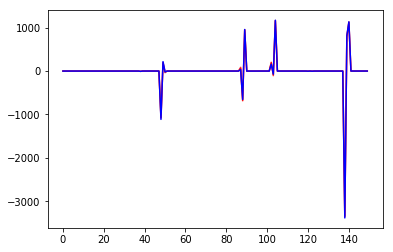

Iteration 110:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.502
Violation Counter 	= 169


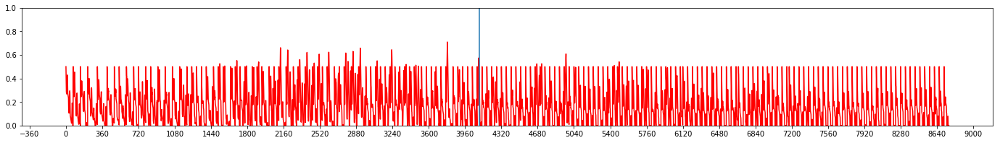

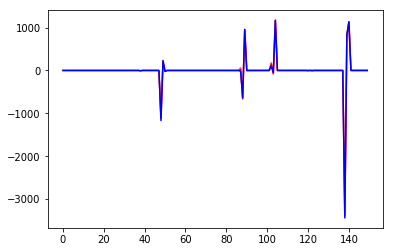

Iteration 111:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.988
Violation Counter 	= 113


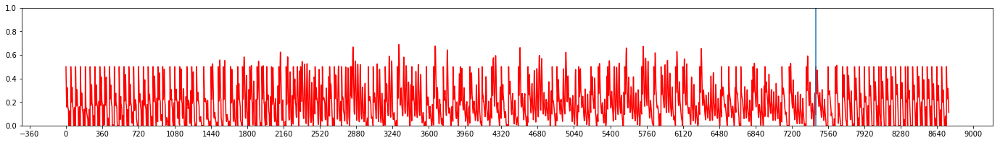

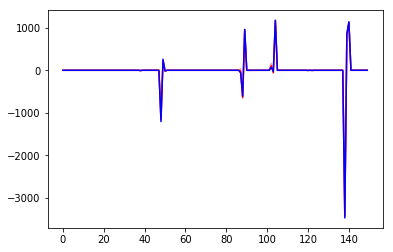

Iteration 112:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.199
Violation Counter 	= 162


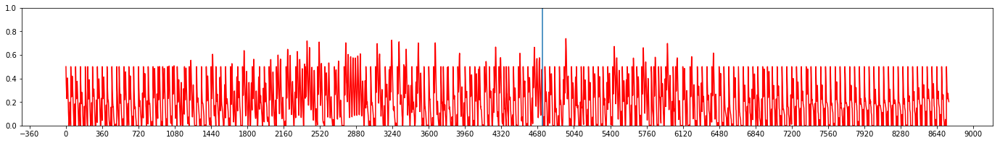

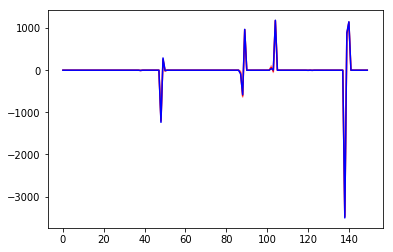

Iteration 113:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.472
Violation Counter 	= 50


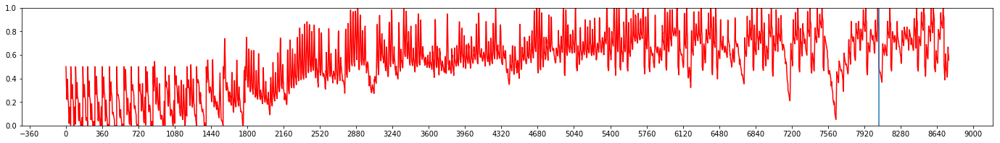

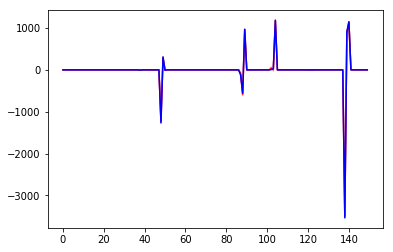

Iteration 114:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.620
Violation Counter 	= 127


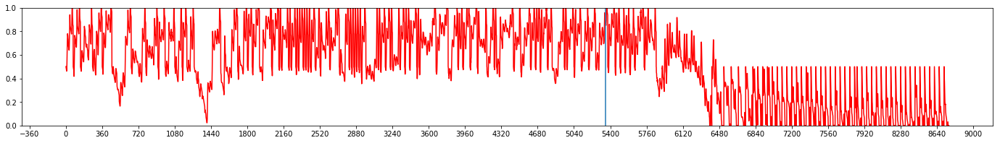

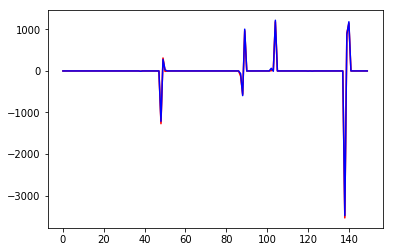

Iteration 115:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.106
Violation Counter 	= 144


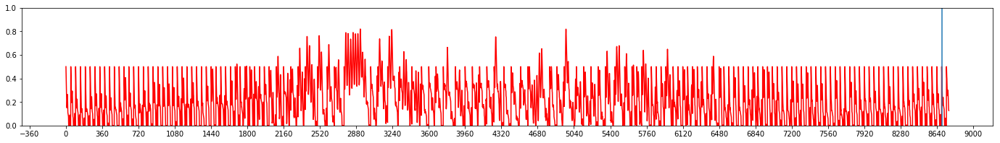

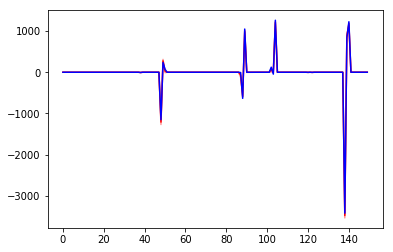

Iteration 116:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.217
Violation Counter 	= 164


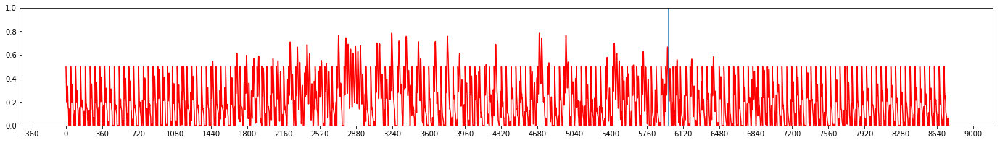

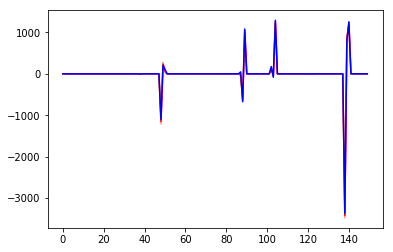

Iteration 117:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.624
Violation Counter 	= 93


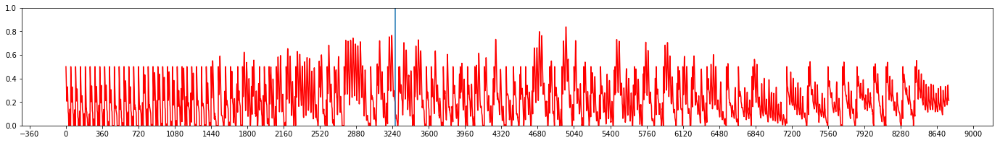

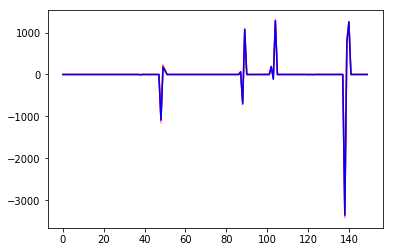

Iteration 118:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.277
Violation Counter 	= 70


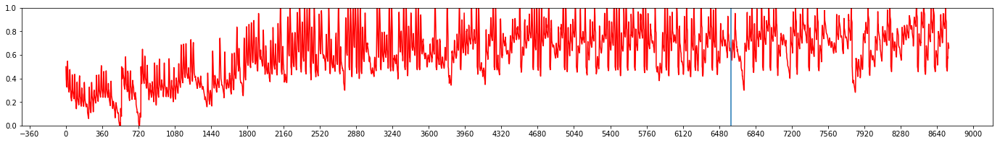

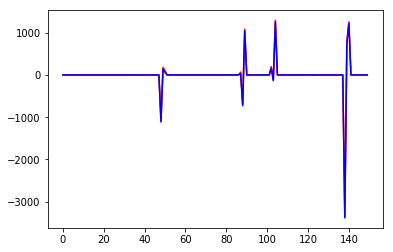

Iteration 119:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.199
Violation Counter 	= 87


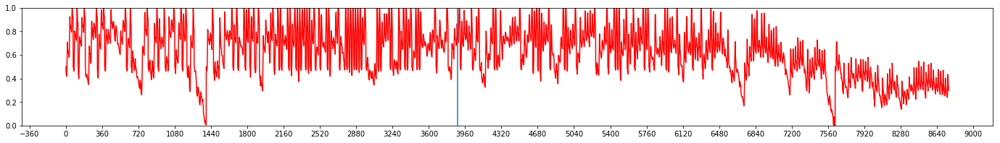

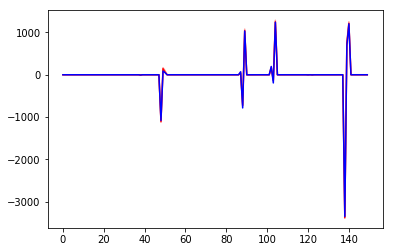

Iteration 120:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.905
Violation Counter 	= 122


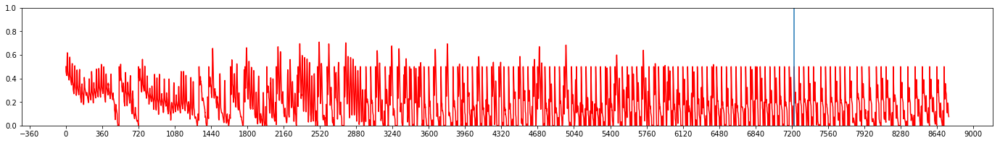

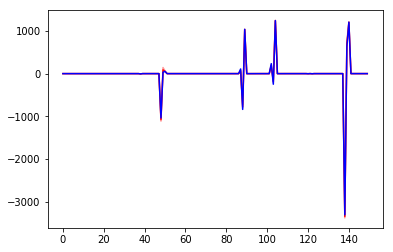

Iteration 121:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.298
Violation Counter 	= 23


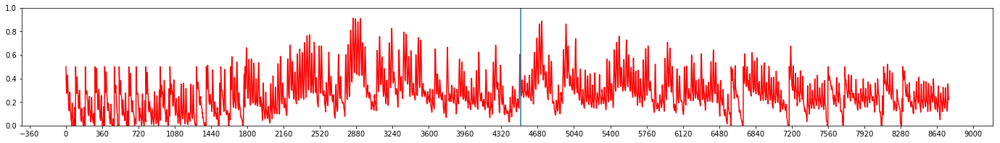

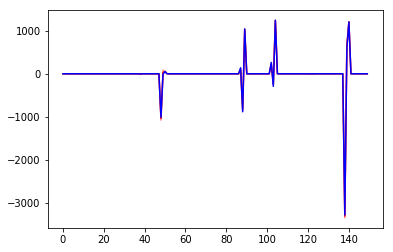

Iteration 122:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.784
Violation Counter 	= 16


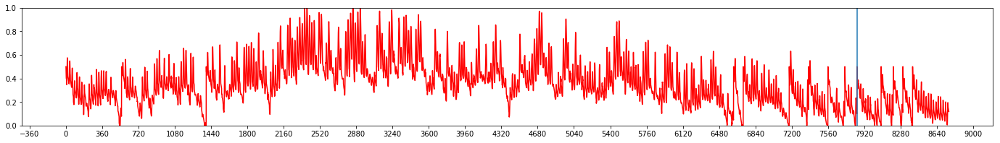

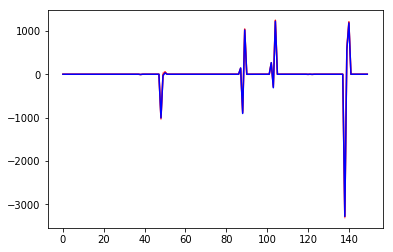

Iteration 123:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.177
Violation Counter 	= 135


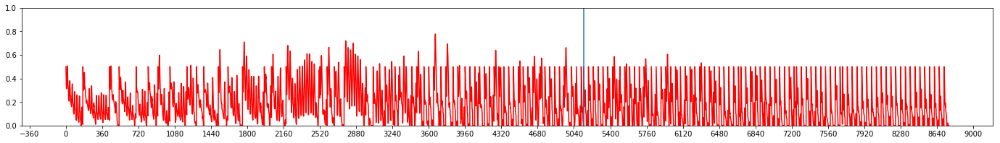

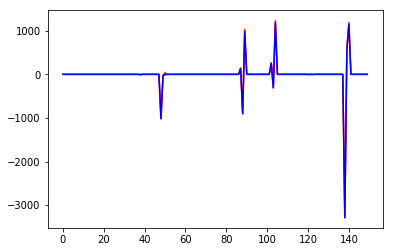

Iteration 124:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.208
Violation Counter 	= 45


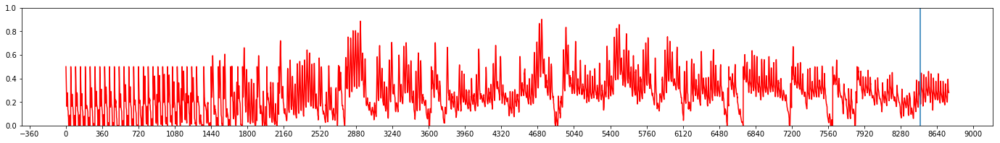

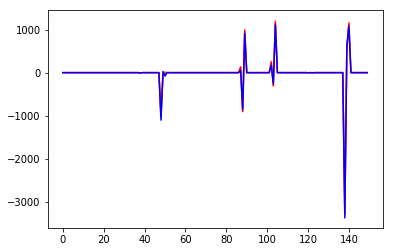

Iteration 125:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.025
Violation Counter 	= 7


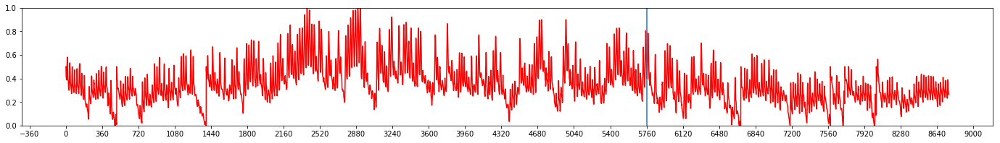

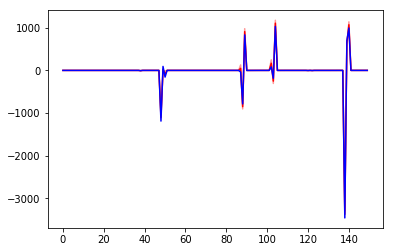

Iteration 126:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.892
Violation Counter 	= 9


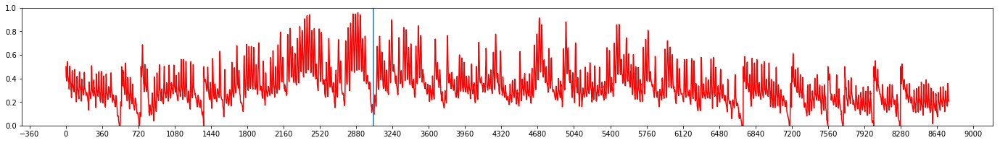

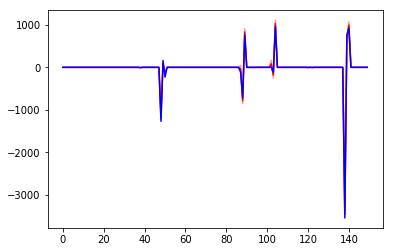

Iteration 127:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.383
Violation Counter 	= 13


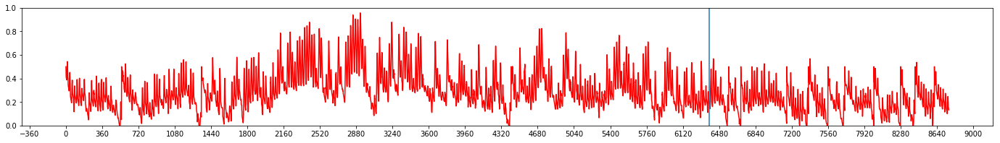

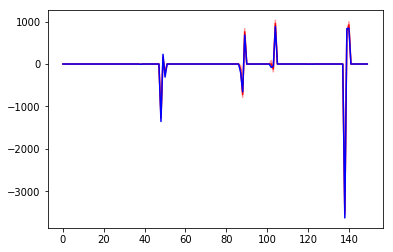

Iteration 128:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.669
Violation Counter 	= 76


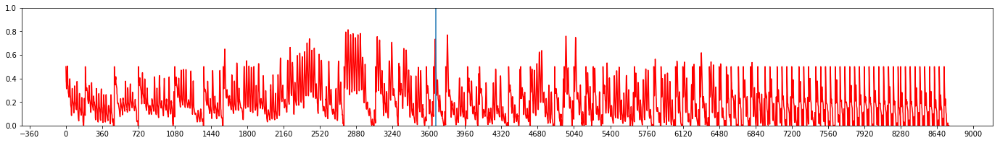

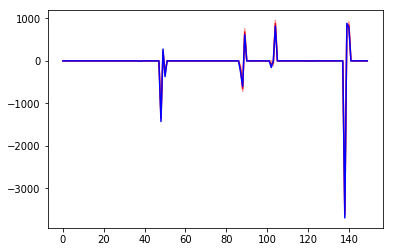

Iteration 129:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.199
Violation Counter 	= 143


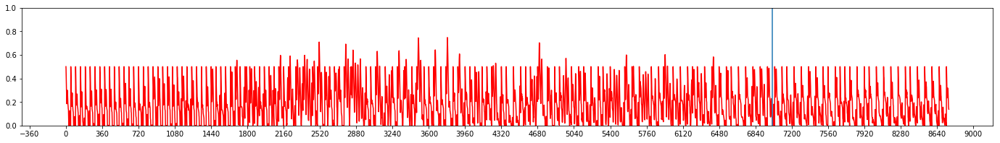

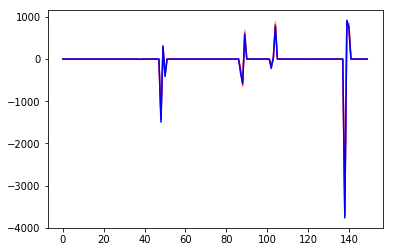

Iteration 130:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.033
Violation Counter 	= 120


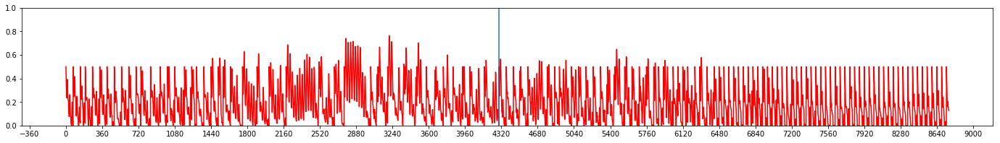

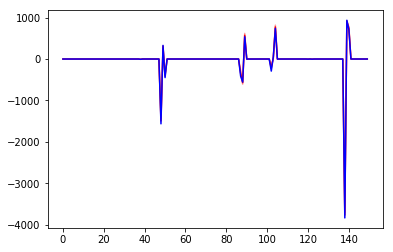

Iteration 131:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.132
Violation Counter 	= 133


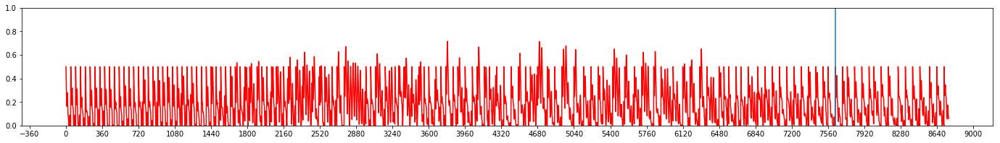

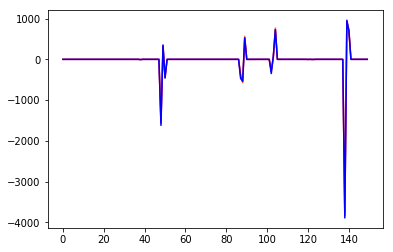

Iteration 132:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.792
Violation Counter 	= 82


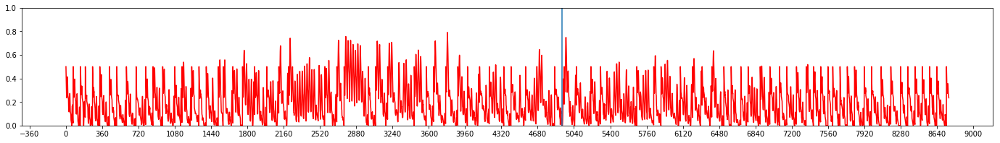

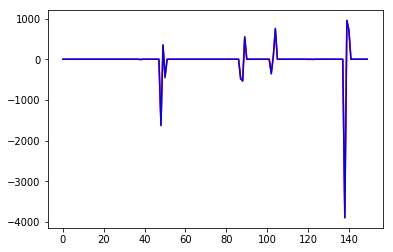

Iteration 133:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.741
Violation Counter 	= 77


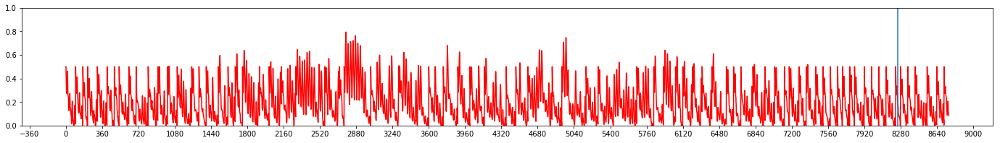

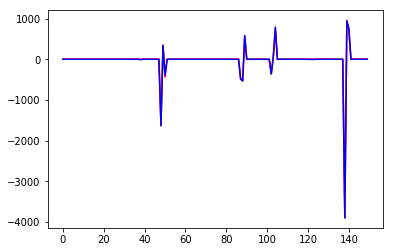

Iteration 134:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.651
Violation Counter 	= 110


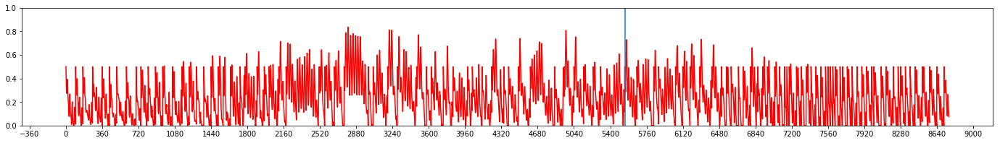

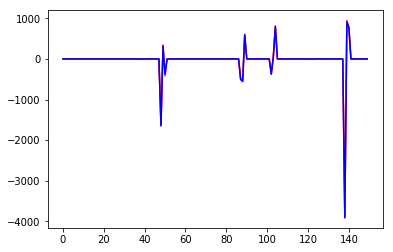

Iteration 135:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.614
Violation Counter 	= 35


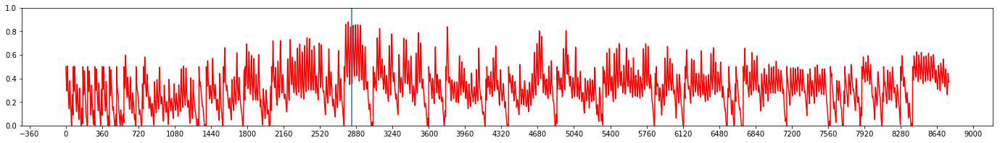

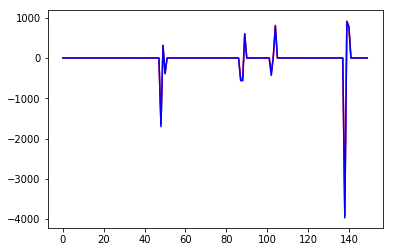

Iteration 136:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.237
Violation Counter 	= 73


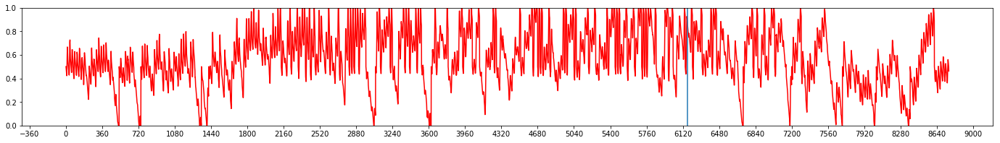

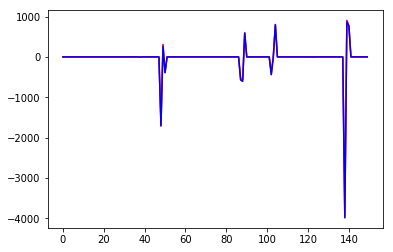

Iteration 137:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.007
Violation Counter 	= 72


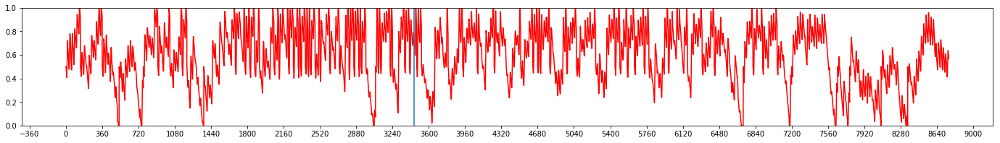

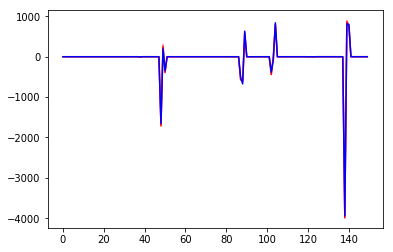

Iteration 138:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.597
Violation Counter 	= 49


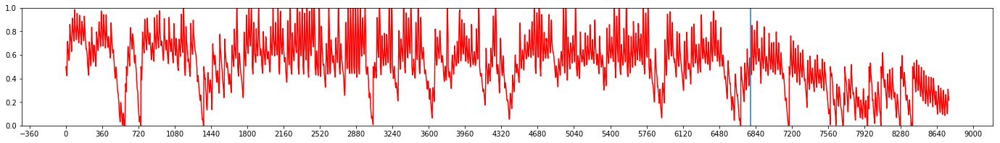

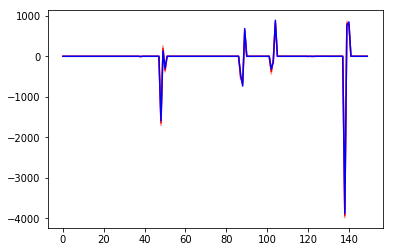

Iteration 139:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.195
Violation Counter 	= 76


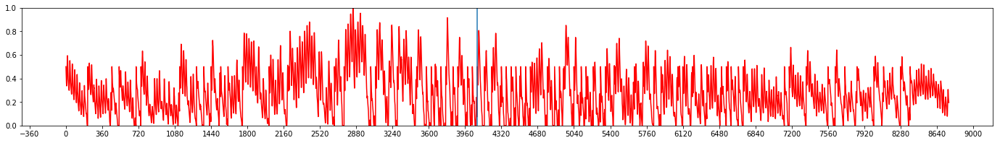

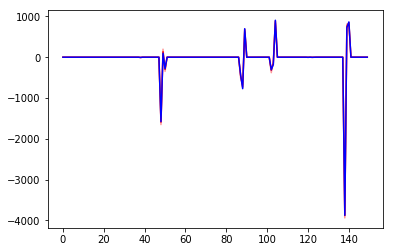

Iteration 140:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.253
Violation Counter 	= 78


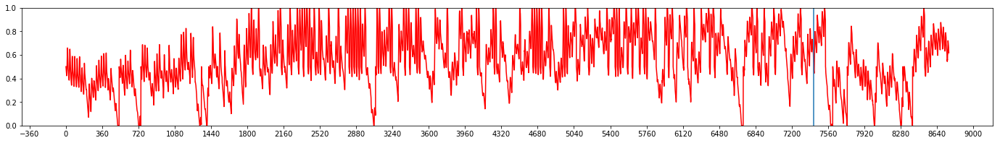

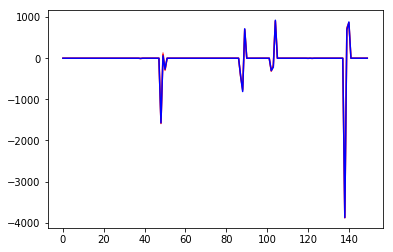

Iteration 141:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.107
Violation Counter 	= 85


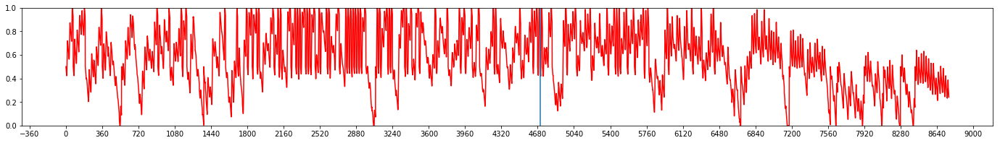

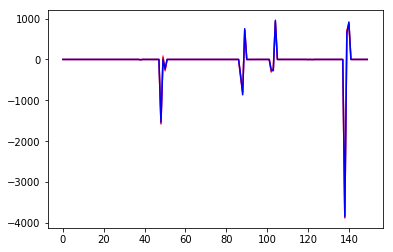

Iteration 142:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.087
Violation Counter 	= 76


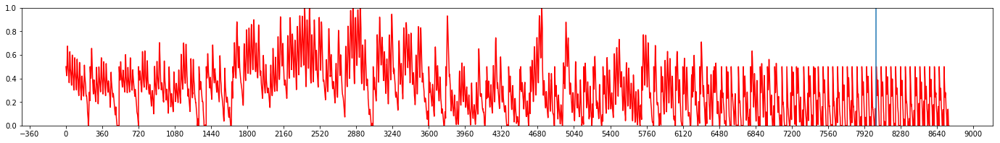

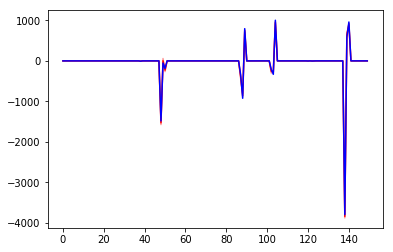

Iteration 143:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.944
Violation Counter 	= 160


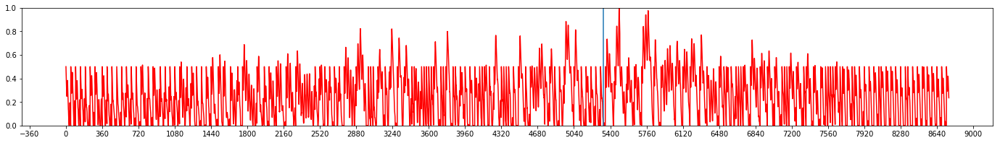

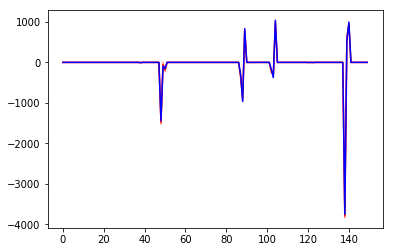

Iteration 144:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.289
Violation Counter 	= 74


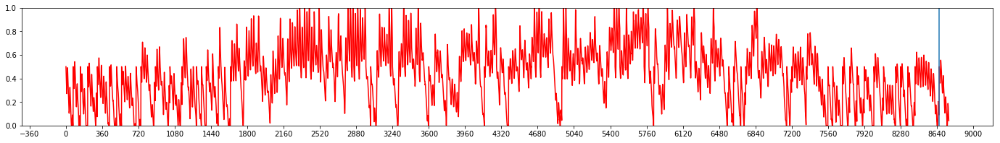

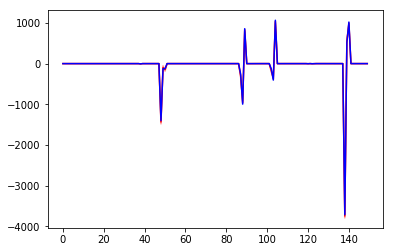

Iteration 145:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.023
Violation Counter 	= 88


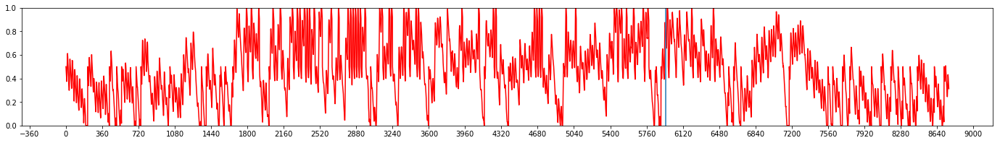

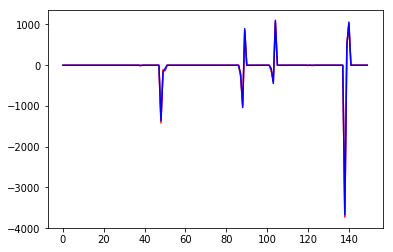

Iteration 146:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.011
Violation Counter 	= 84


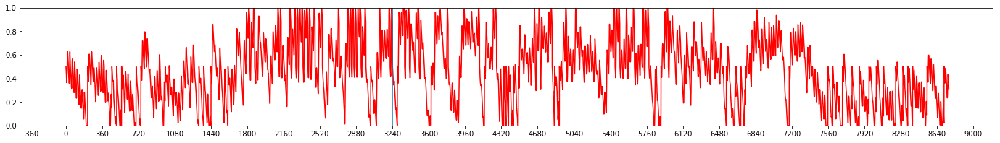

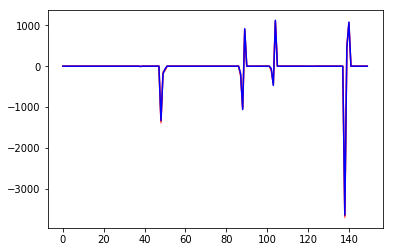

Iteration 147:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.016
Violation Counter 	= 92


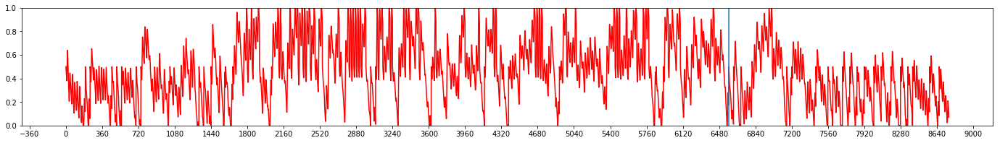

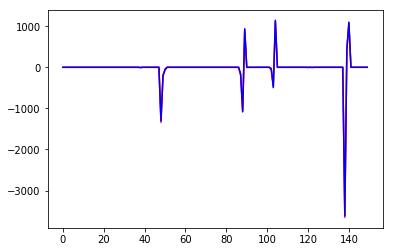

Iteration 148:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.090
Violation Counter 	= 94


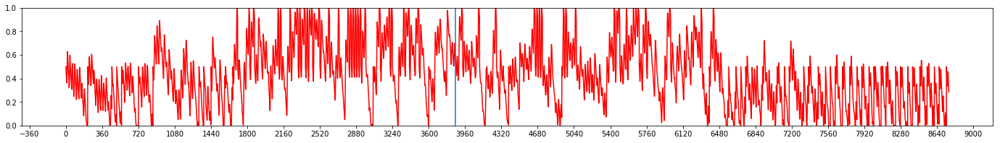

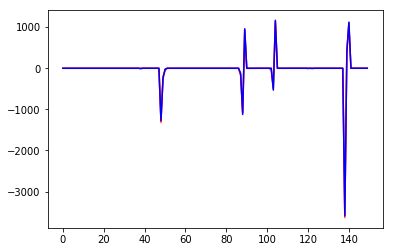

Iteration 149:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.189
Violation Counter 	= 96


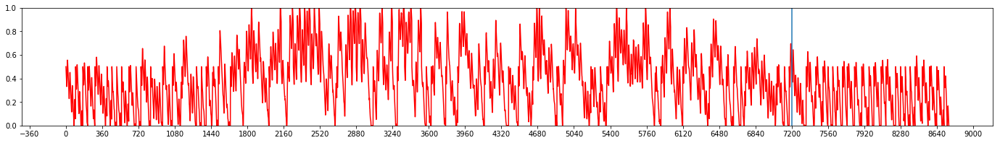

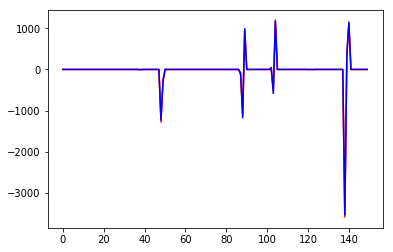

Iteration 150:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.004
Violation Counter 	= 90


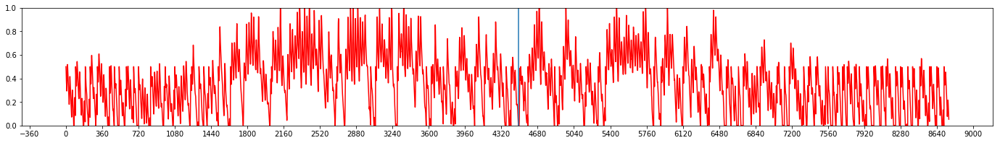

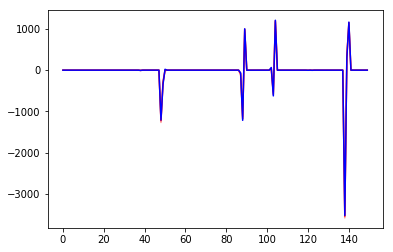

Iteration 151:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.269
Violation Counter 	= 107


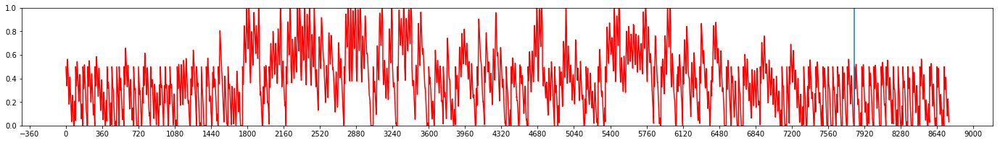

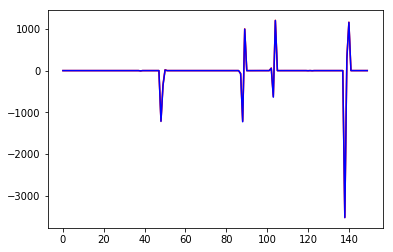

Iteration 152:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.294
Violation Counter 	= 106


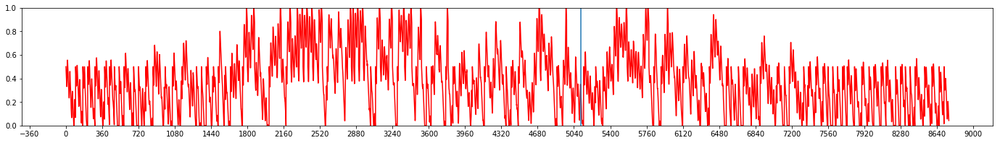

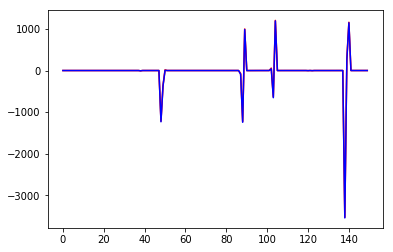

Iteration 153:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.006
Violation Counter 	= 82


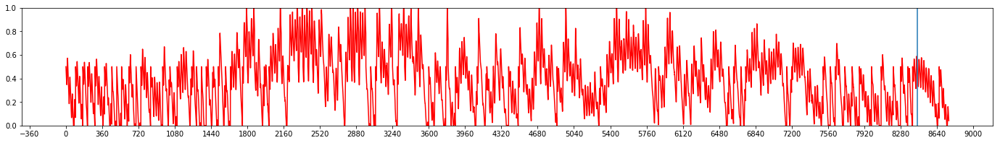

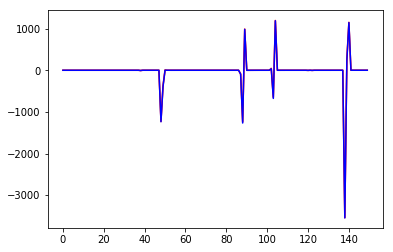

Iteration 154:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.015
Violation Counter 	= 93


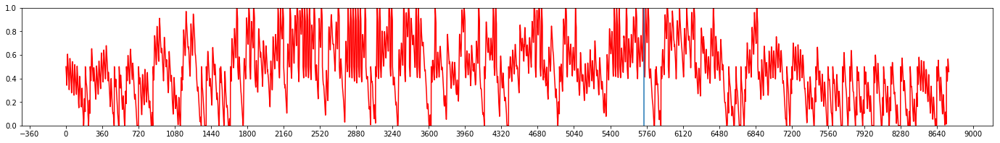

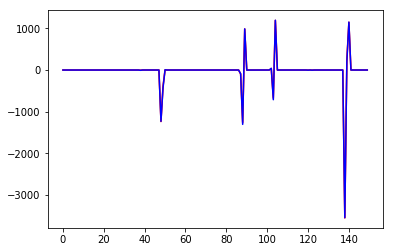

Iteration 155:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.066
Violation Counter 	= 90


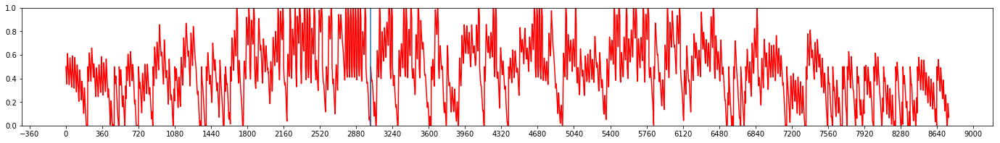

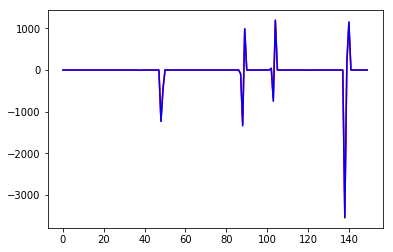

Iteration 156:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.069
Violation Counter 	= 79


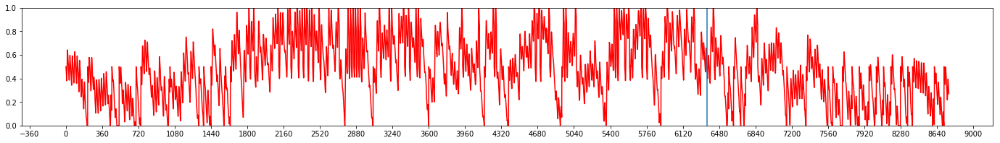

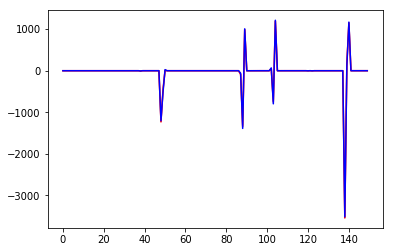

Iteration 157:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.028
Violation Counter 	= 88


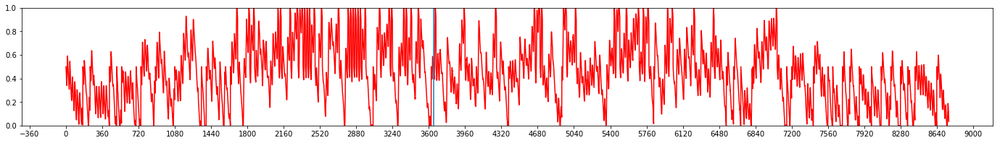

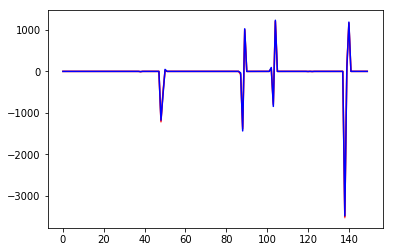

Iteration 158:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.053
Violation Counter 	= 88


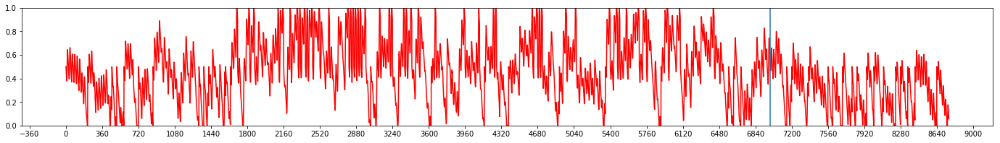

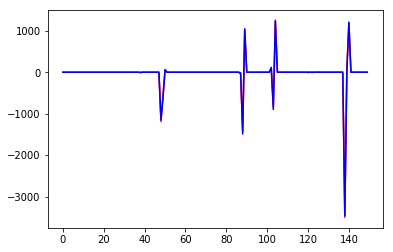

Iteration 159:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.054
Violation Counter 	= 87


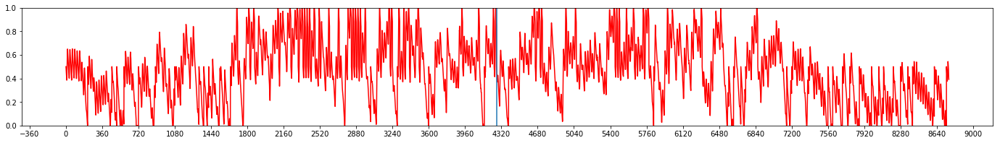

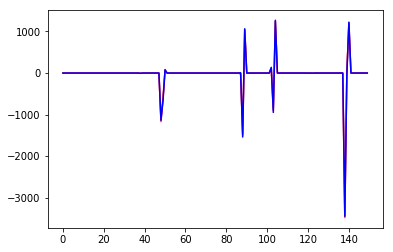

Iteration 160:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.017
Violation Counter 	= 89


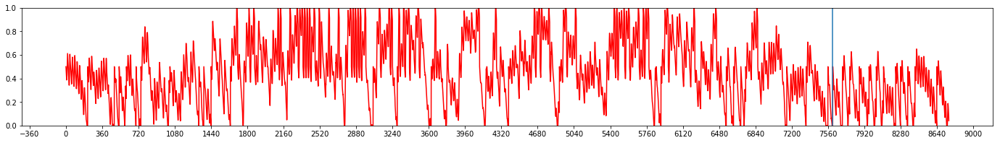

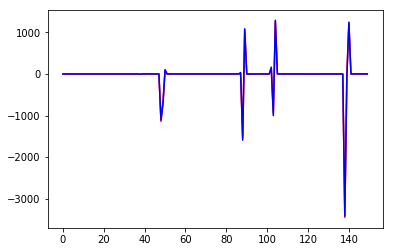

Iteration 161:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.040
Violation Counter 	= 91


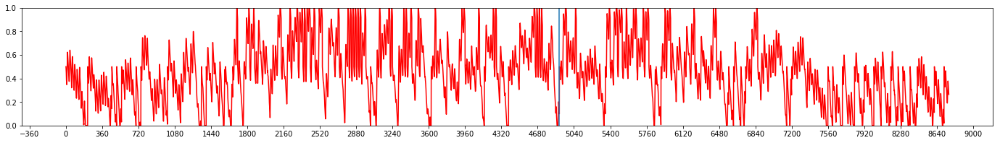

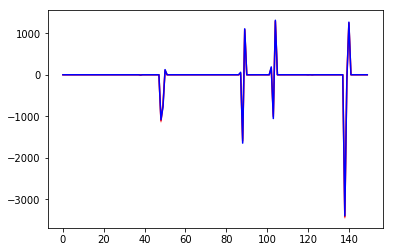

Iteration 162:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.067
Violation Counter 	= 87


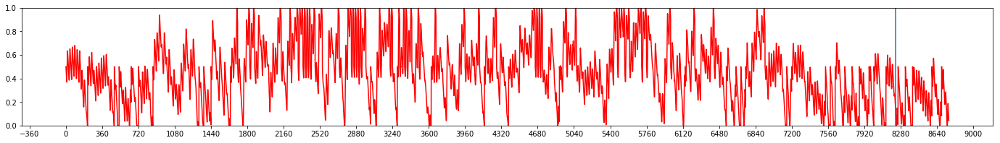

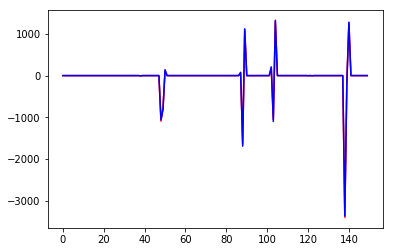

Iteration 163:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.064
Violation Counter 	= 82


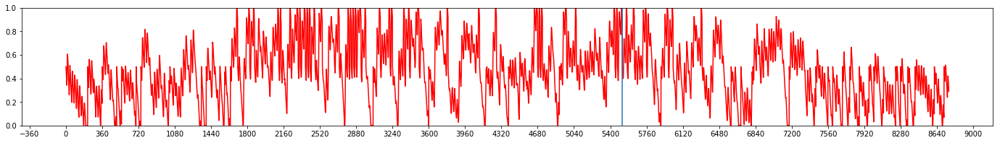

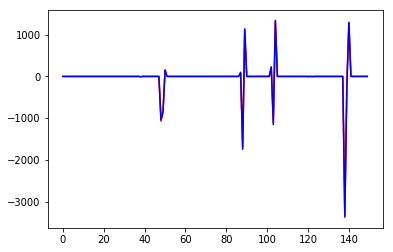

Iteration 164:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.022
Violation Counter 	= 94


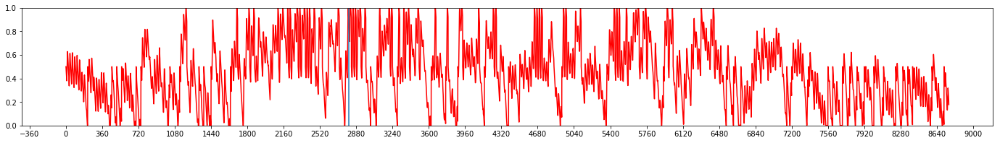

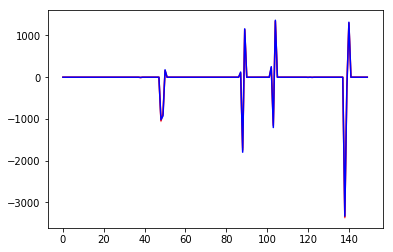

Iteration 165:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.030
Violation Counter 	= 89


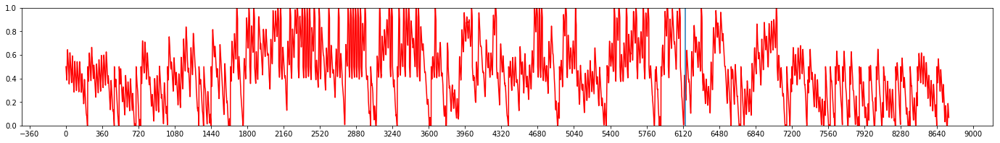

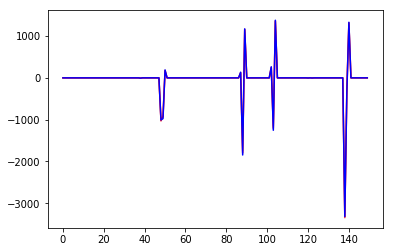

Iteration 166:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.061
Violation Counter 	= 91


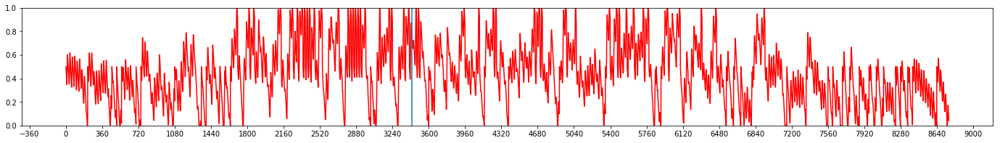

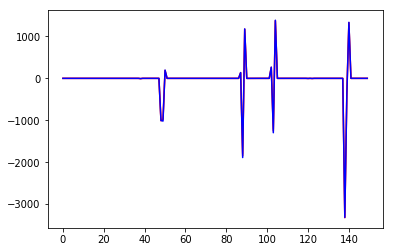

Iteration 167:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.060
Violation Counter 	= 89


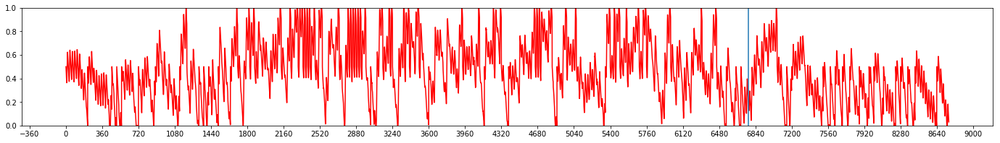

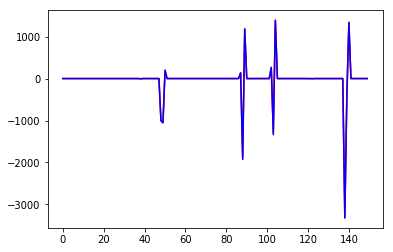

Iteration 168:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.013
Violation Counter 	= 94


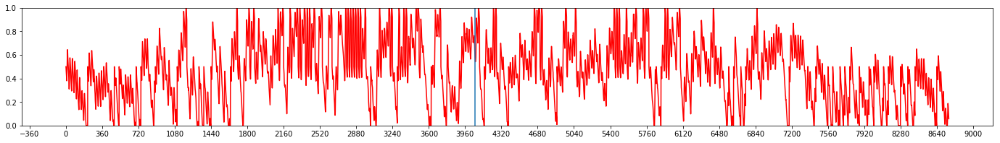

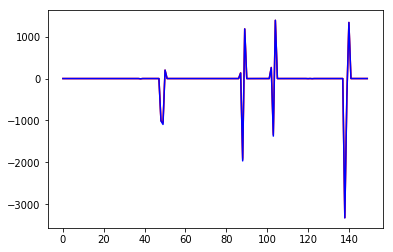

Iteration 169:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.008
Violation Counter 	= 90


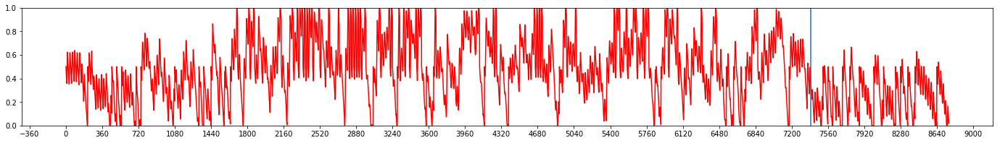

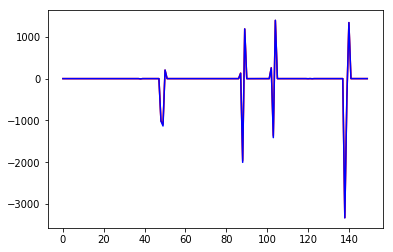

Iteration 170:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.020
Violation Counter 	= 90


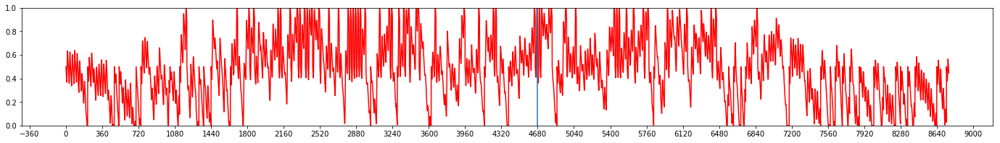

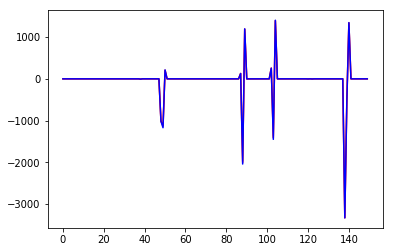

Iteration 171:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.064
Violation Counter 	= 87


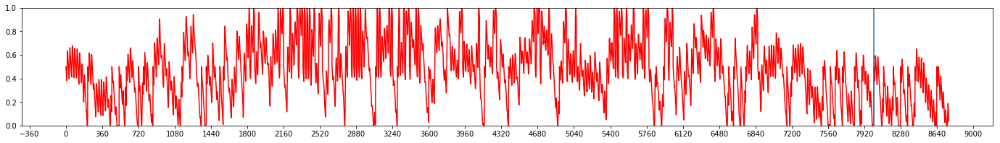

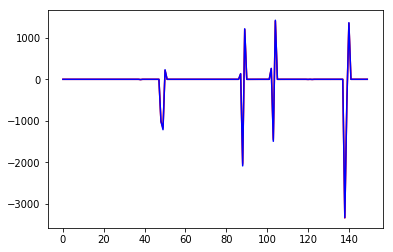

Iteration 172:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.033
Violation Counter 	= 89


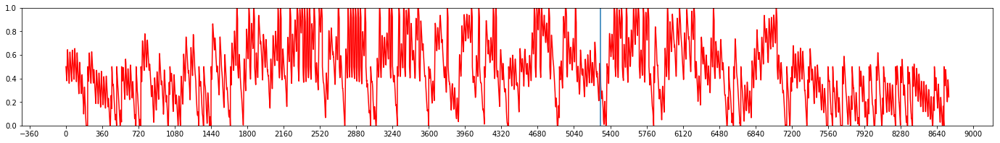

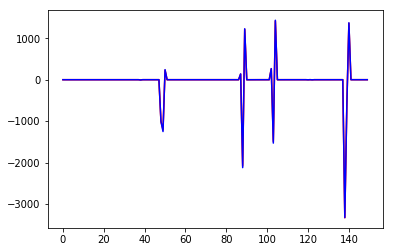

Iteration 173:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.055
Violation Counter 	= 86


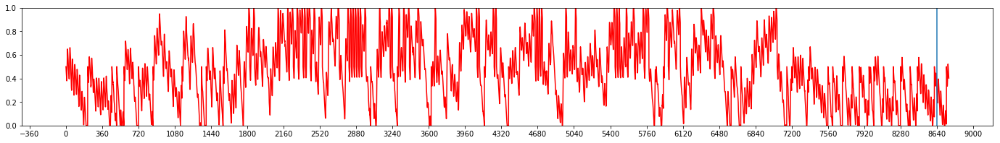

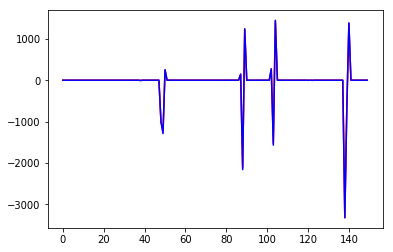

Iteration 174:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.038
Violation Counter 	= 85


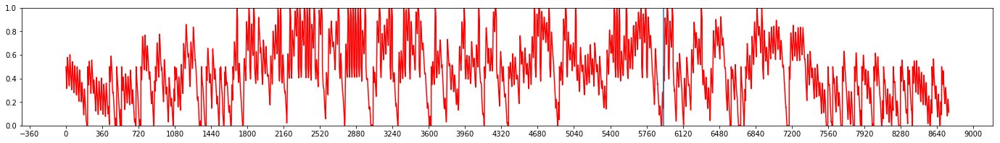

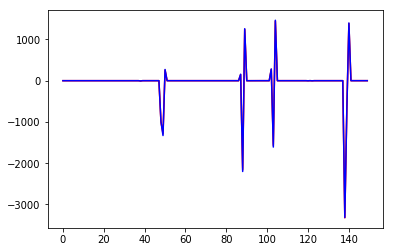

Iteration 175:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.009
Violation Counter 	= 92


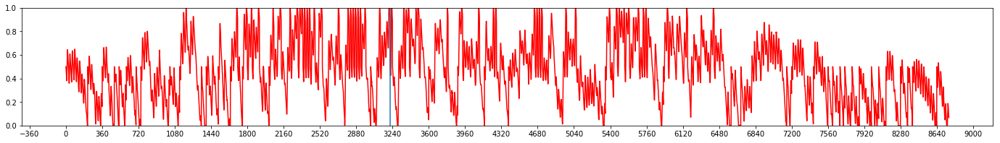

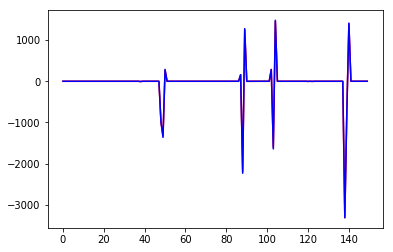

Iteration 176:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.015
Violation Counter 	= 89


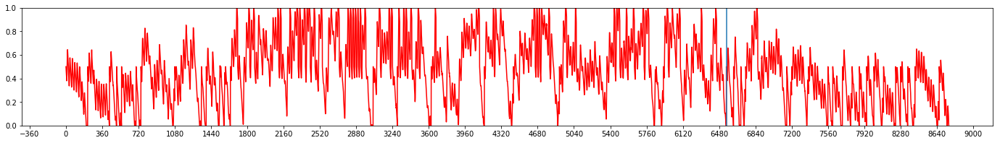

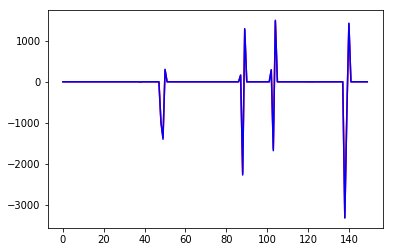

Iteration 177:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.097
Violation Counter 	= 92


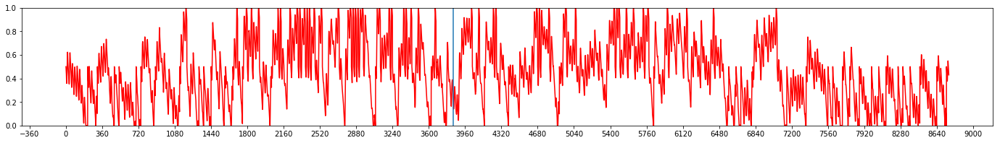

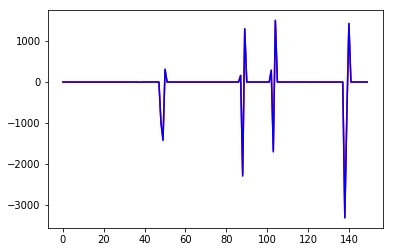

Iteration 178:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.059
Violation Counter 	= 88


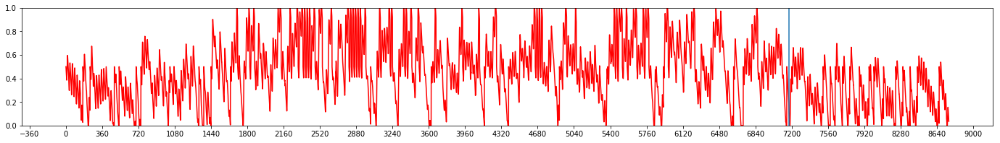

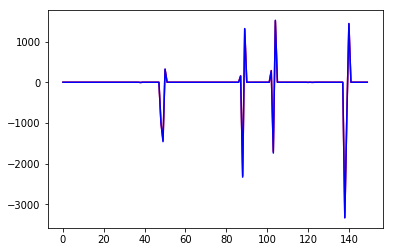

Iteration 179:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.011
Violation Counter 	= 89


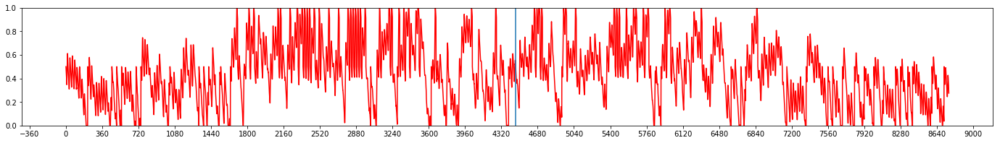

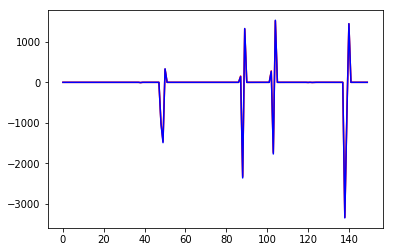

Iteration 180:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.003
Violation Counter 	= 88


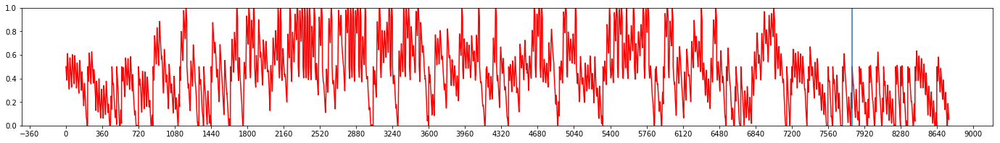

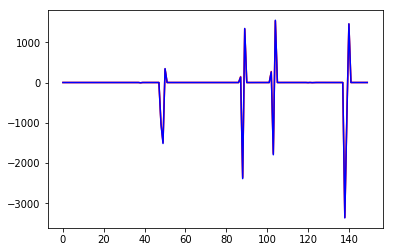

Iteration 181:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.029
Violation Counter 	= 87


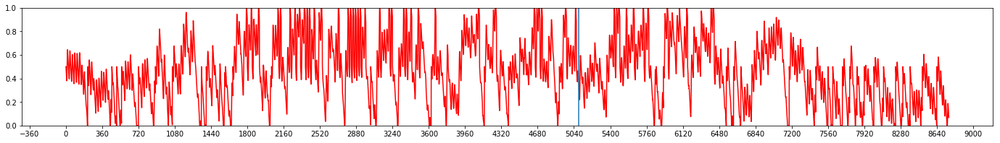

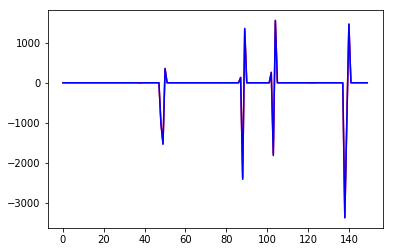

Iteration 182:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.057
Violation Counter 	= 94


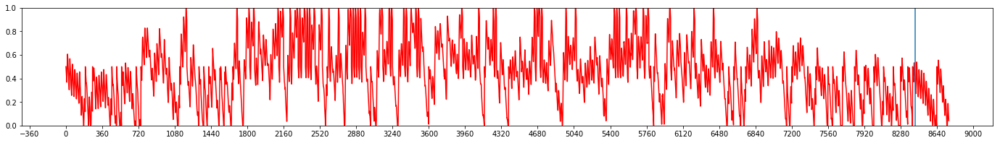

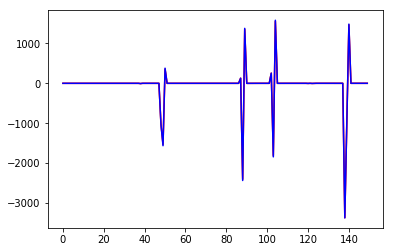

Iteration 183:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.024
Violation Counter 	= 88


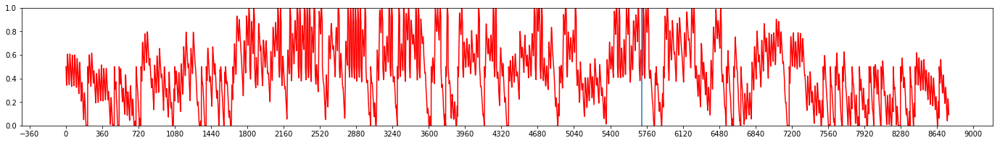

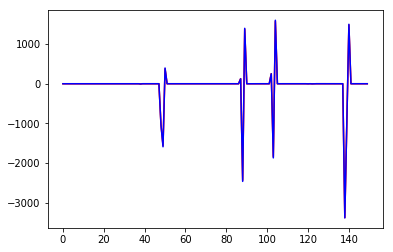

Iteration 184:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.038
Violation Counter 	= 84


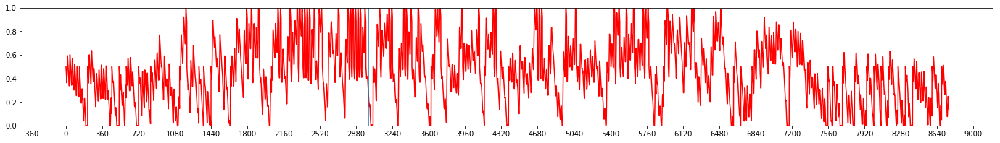

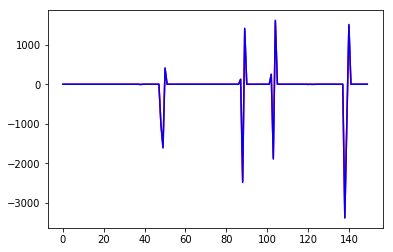

Iteration 185:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.027
Violation Counter 	= 91


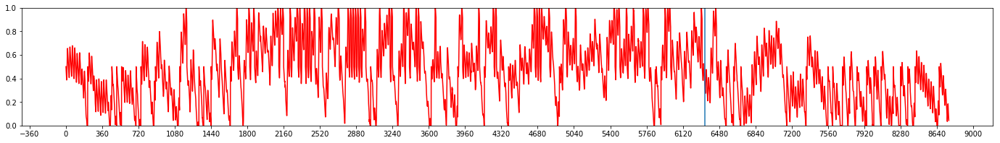

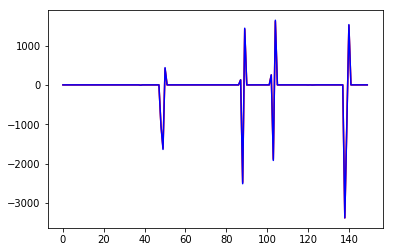

Iteration 186:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.026
Violation Counter 	= 92


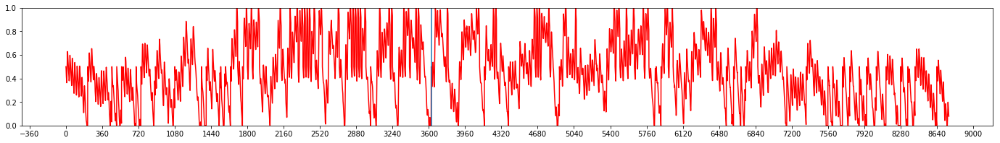

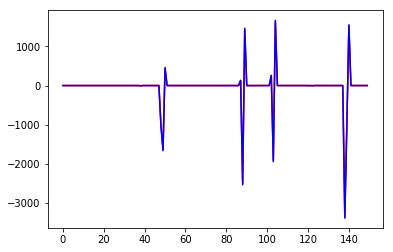

Iteration 187:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.032
Violation Counter 	= 85


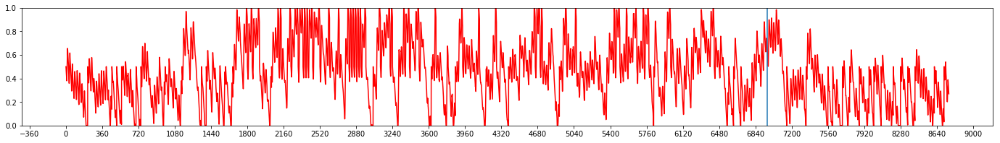

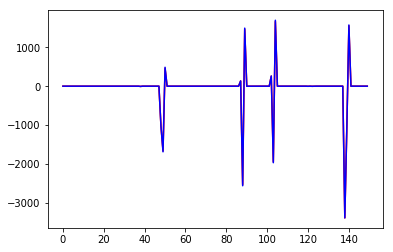

Iteration 188:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.009
Violation Counter 	= 91


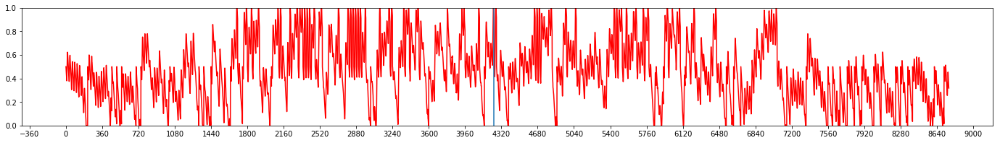

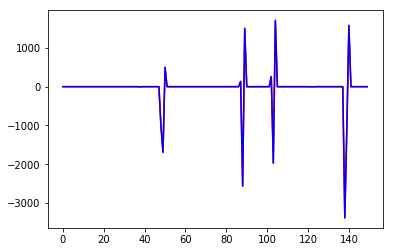

Iteration 189:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.036
Violation Counter 	= 95


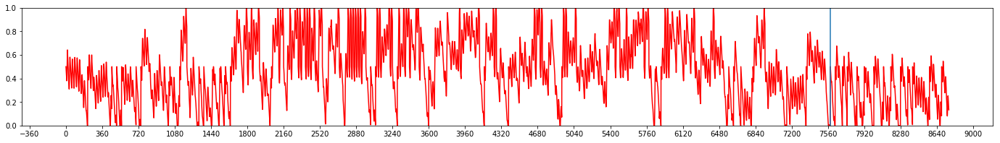

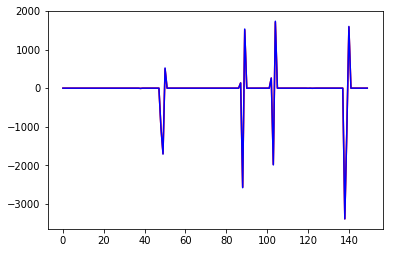

Iteration 190:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.004
Violation Counter 	= 90


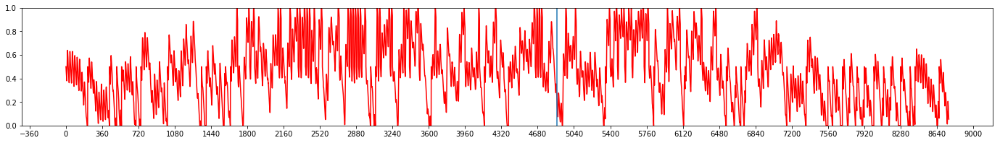

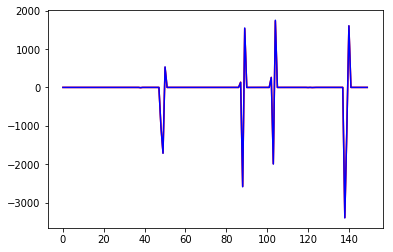

Iteration 191:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.010
Violation Counter 	= 93


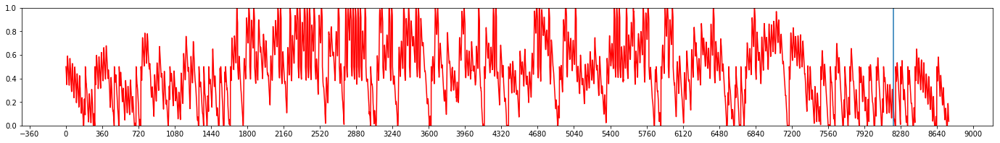

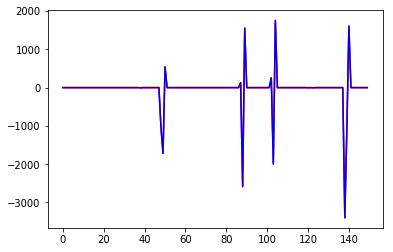

Iteration 192:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.076
Violation Counter 	= 87


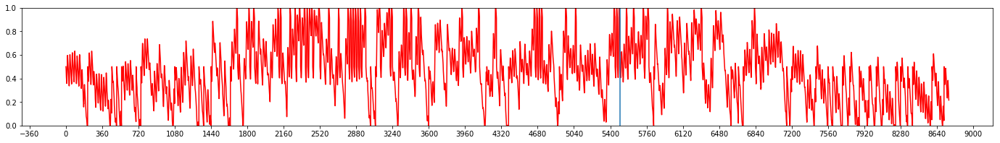

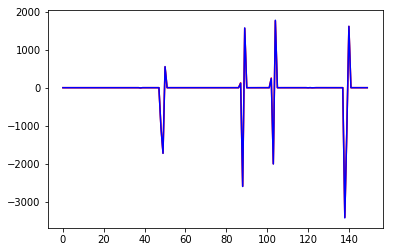

Iteration 193:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.013
Violation Counter 	= 88


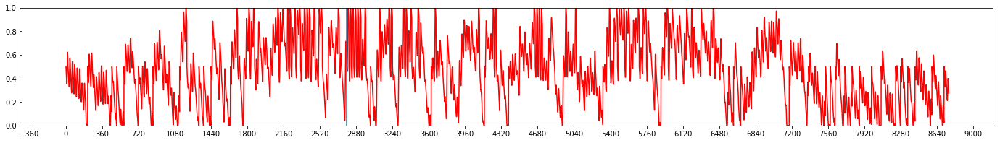

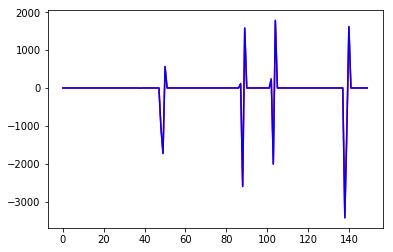

Iteration 194:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.073
Violation Counter 	= 91


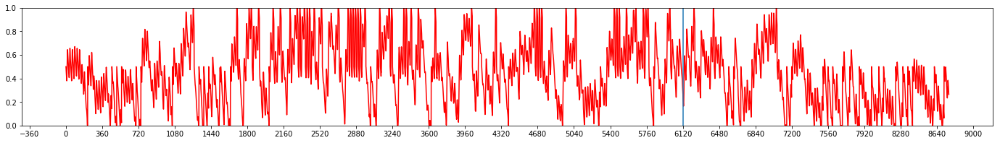

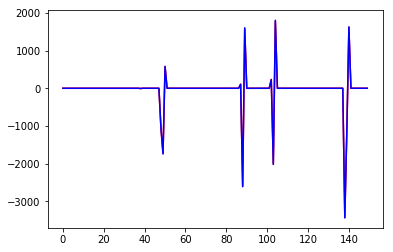

Iteration 195:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.020
Violation Counter 	= 92


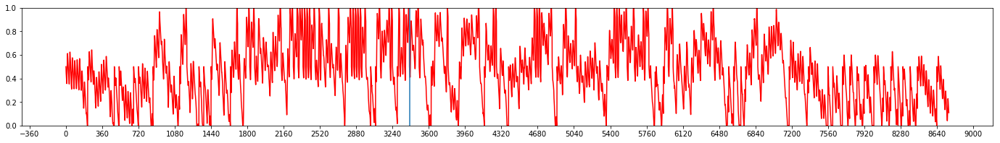

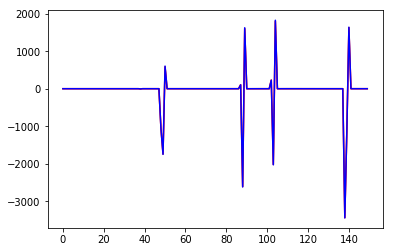

Iteration 196:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.087
Violation Counter 	= 87


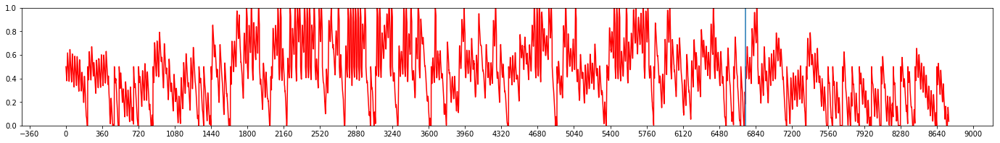

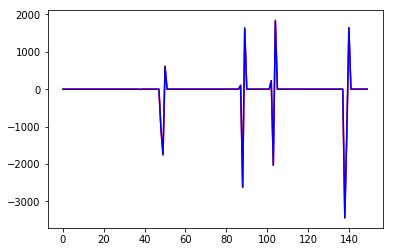

Iteration 197:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.049
Violation Counter 	= 91


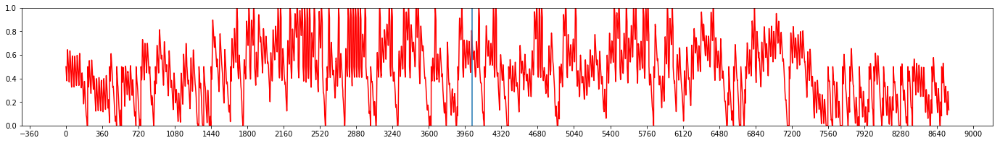

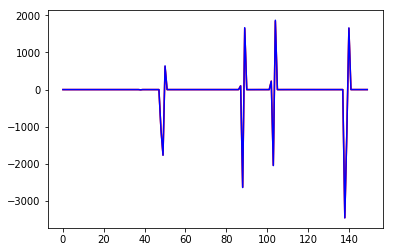

Iteration 198:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.010
Violation Counter 	= 90


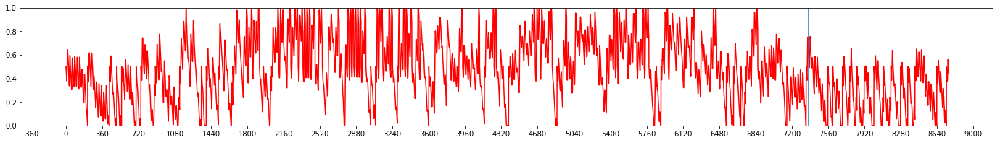

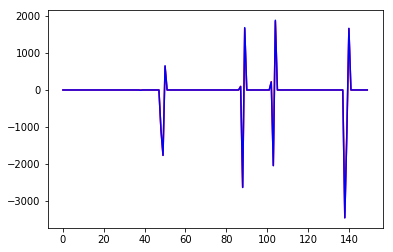

Iteration 199:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.077
Violation Counter 	= 89


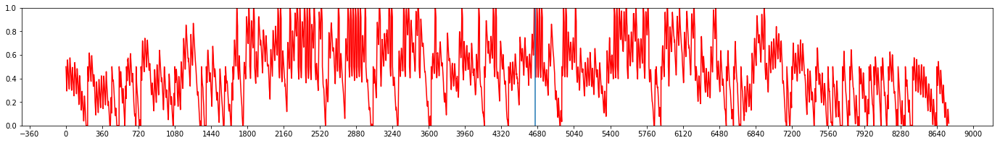

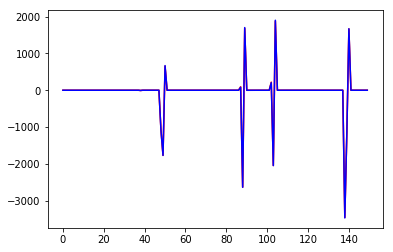

Iteration 200:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.037
Violation Counter 	= 88


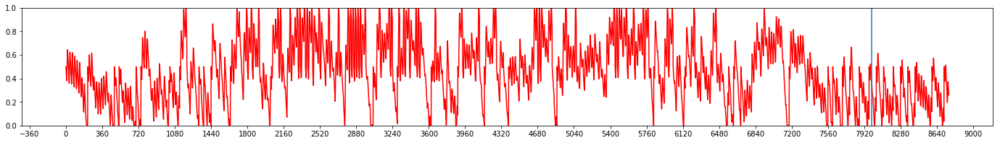

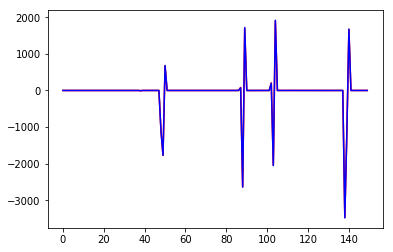

Iteration 201:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.004
Violation Counter 	= 91


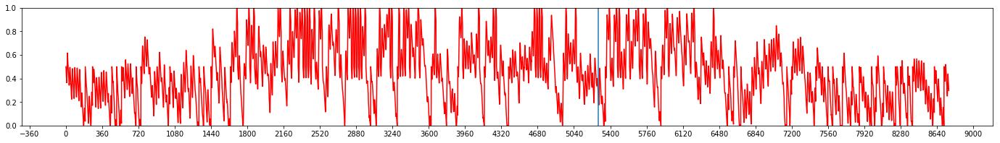

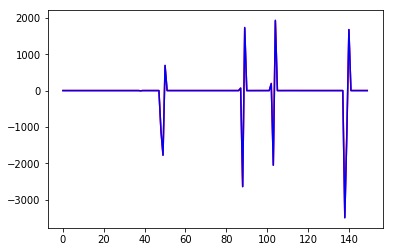

Iteration 202:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.076
Violation Counter 	= 87


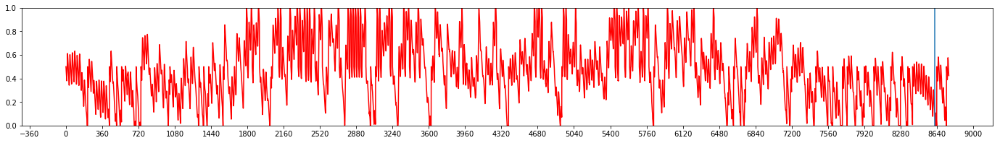

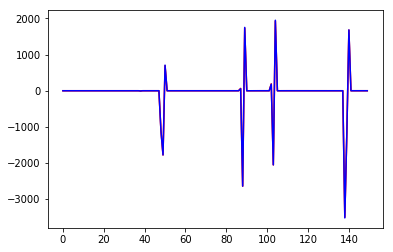

Iteration 203:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.063
Violation Counter 	= 89


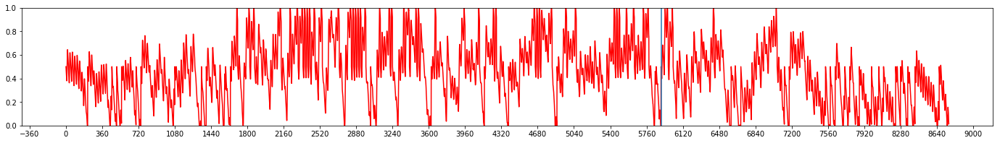

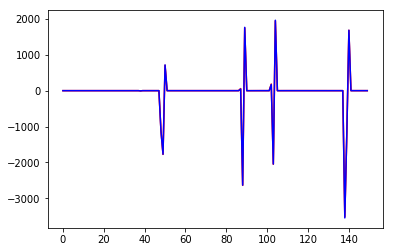

Iteration 204:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.066
Violation Counter 	= 85


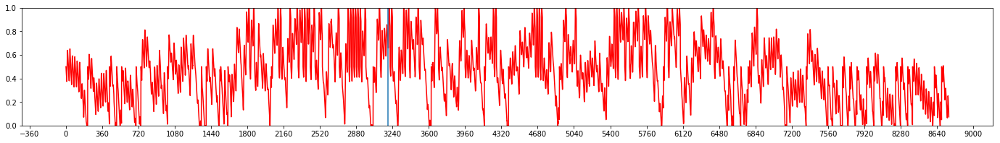

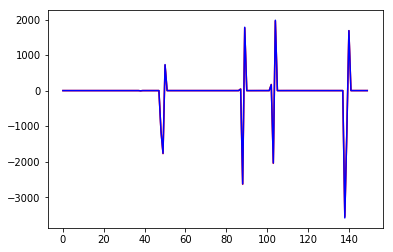

Iteration 205:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.026
Violation Counter 	= 96


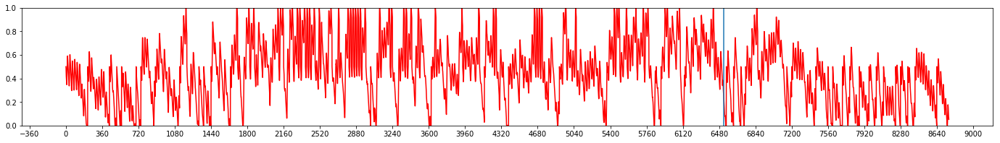

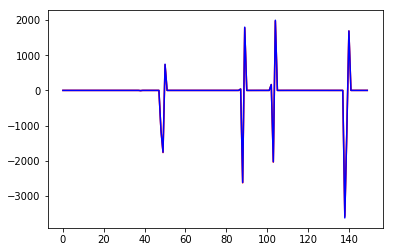

Iteration 206:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.007
Violation Counter 	= 91


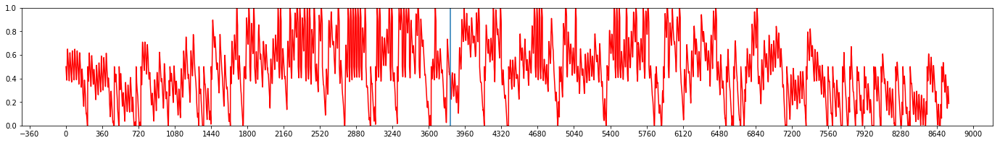

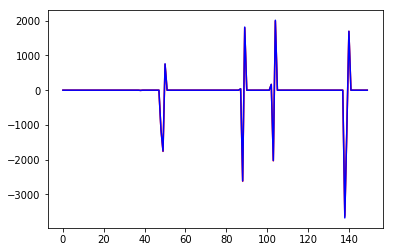

Iteration 207:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.046
Violation Counter 	= 83


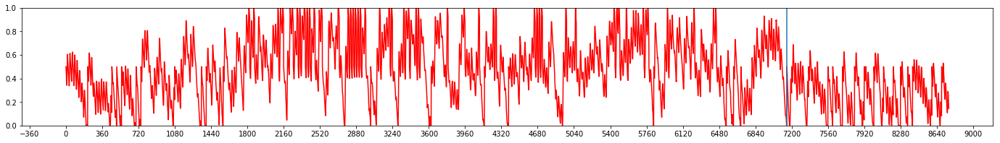

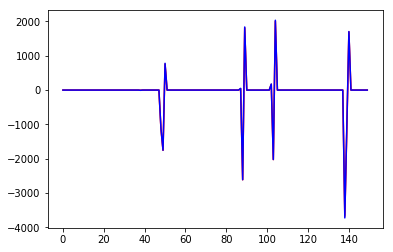

Iteration 208:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.091
Violation Counter 	= 89


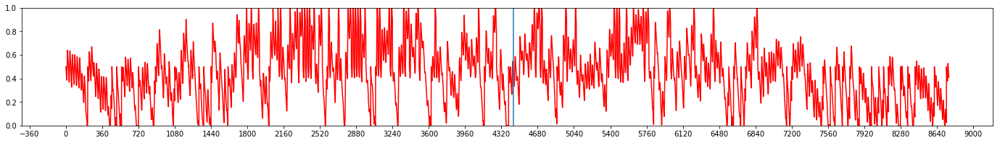

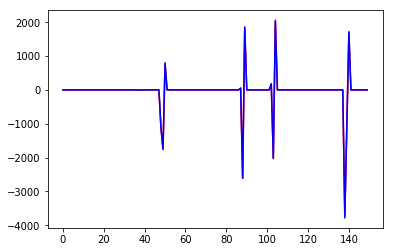

Iteration 209:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.012
Violation Counter 	= 89


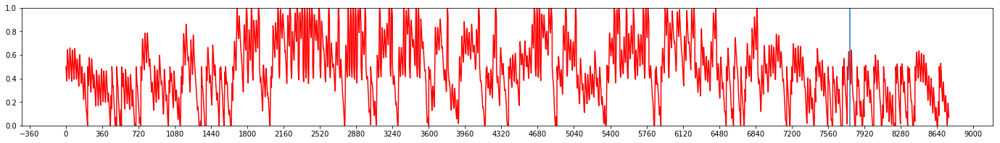

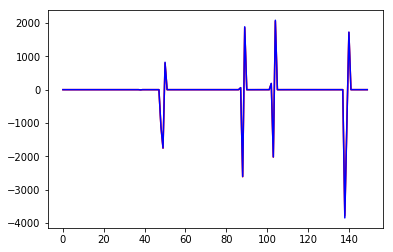

Iteration 210:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.048
Violation Counter 	= 87


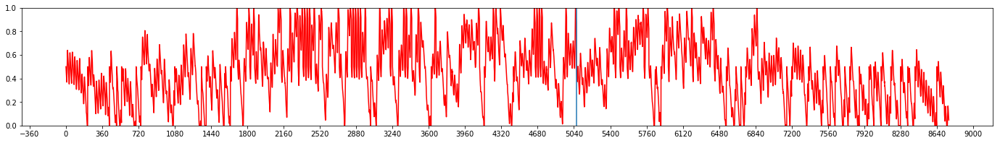

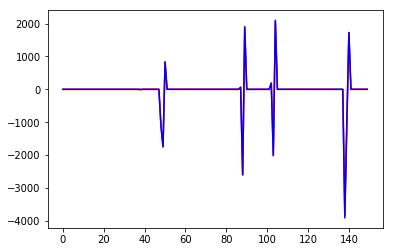

Iteration 211:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.139
Violation Counter 	= 76


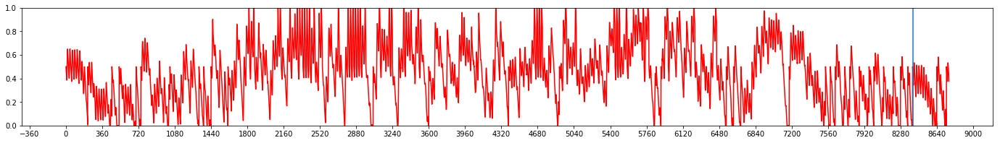

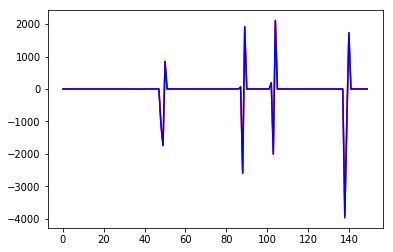

Iteration 212:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.004
Violation Counter 	= 84


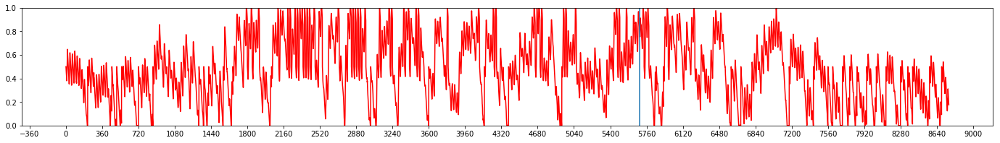

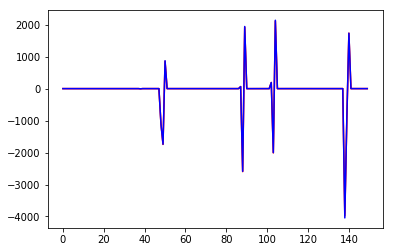

Iteration 213:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.065
Violation Counter 	= 85


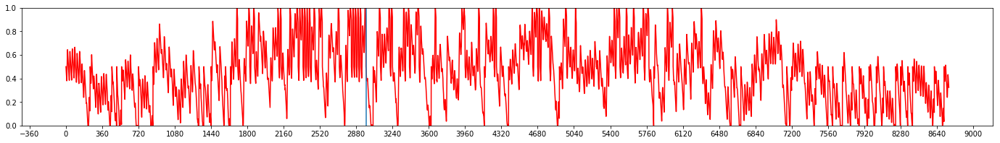

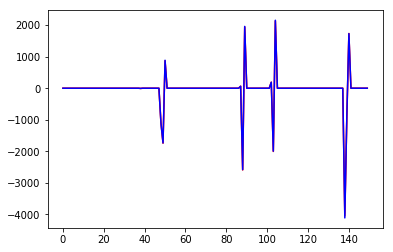

Iteration 214:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.128
Violation Counter 	= 77


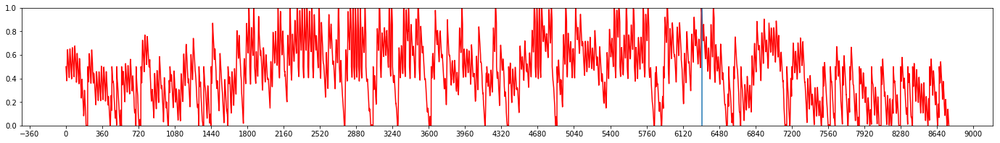

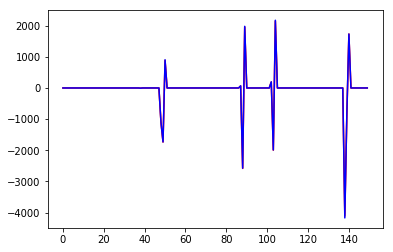

Iteration 215:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.208
Violation Counter 	= 70


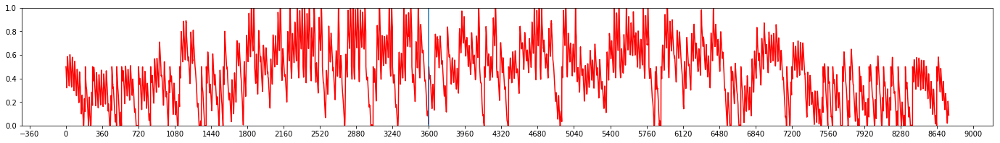

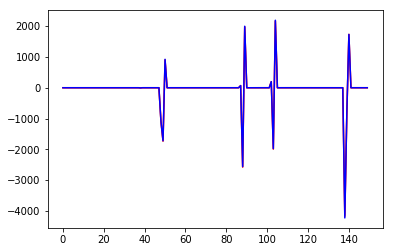

Iteration 216:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.041
Violation Counter 	= 79


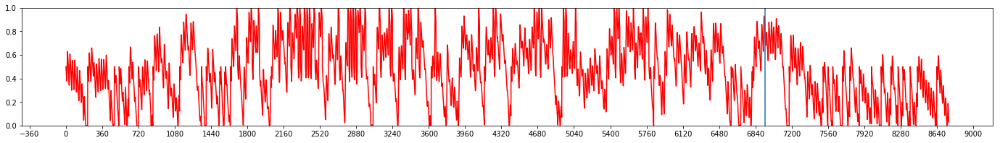

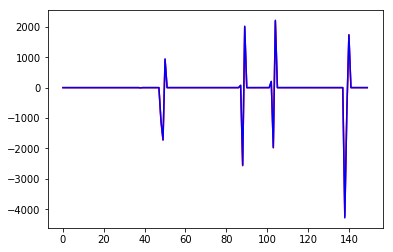

Iteration 217:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.010
Violation Counter 	= 80


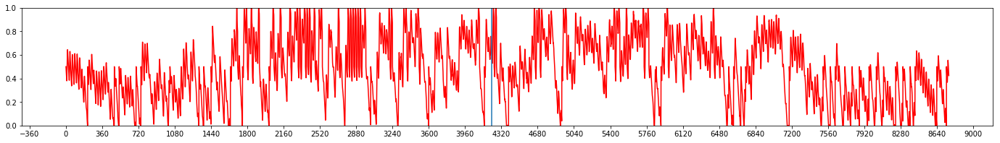

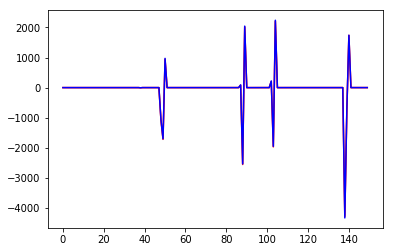

Iteration 218:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.055
Violation Counter 	= 89


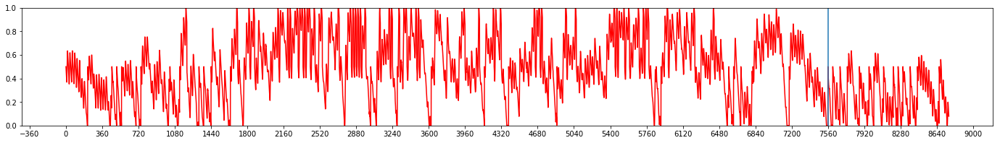

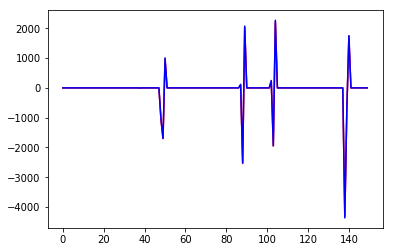

Iteration 219:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.126
Violation Counter 	= 83


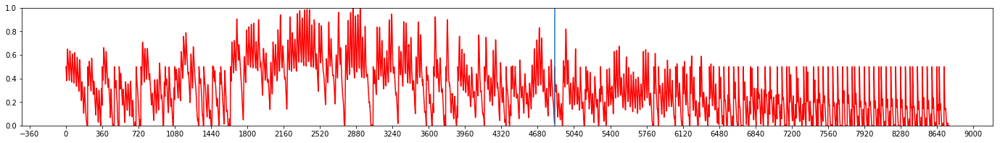

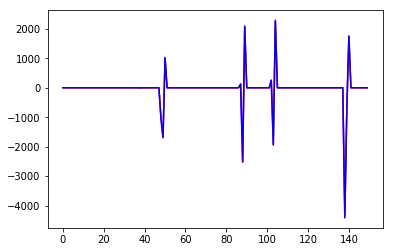

Iteration 220:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.073
Violation Counter 	= 252


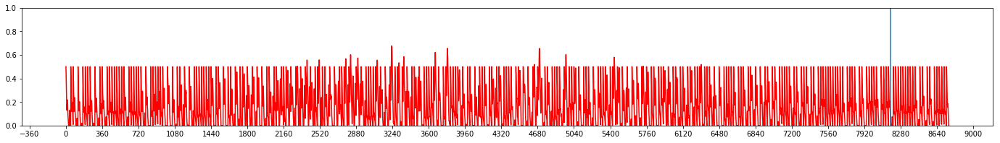

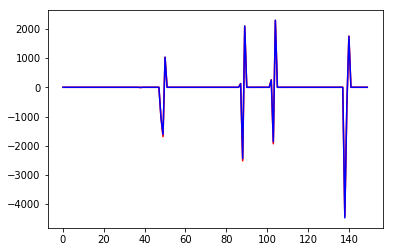

Iteration 221:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.806
Violation Counter 	= 205


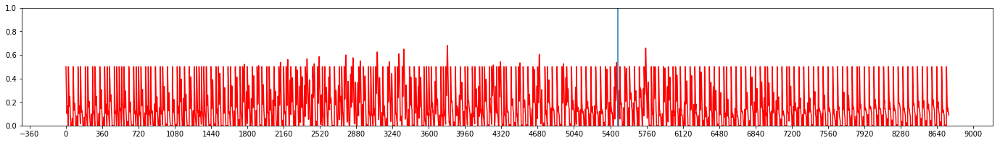

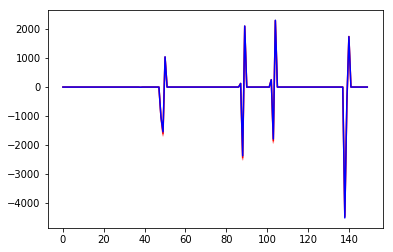

Iteration 222:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.751
Violation Counter 	= 209


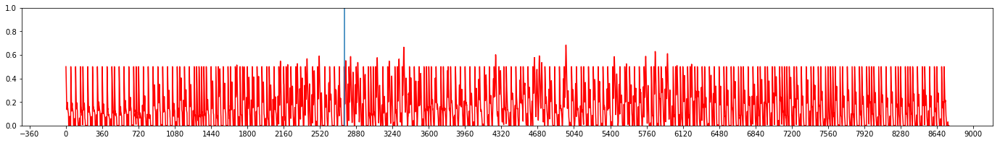

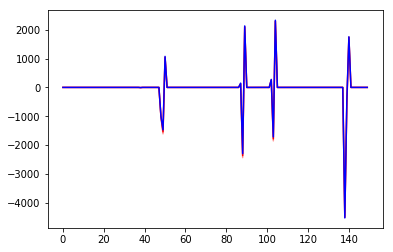

Iteration 223:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.442
Violation Counter 	= 212


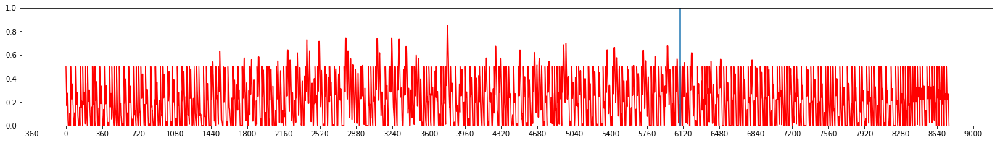

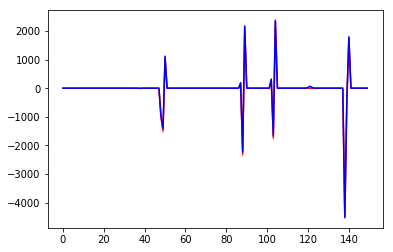

Iteration 224:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.819
Violation Counter 	= 248


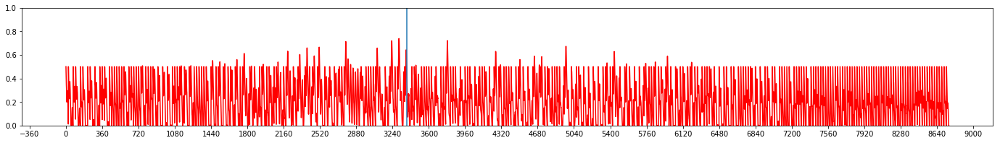

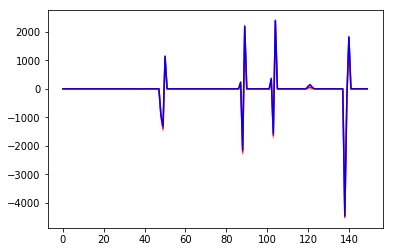

Iteration 225:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.743
Violation Counter 	= 249


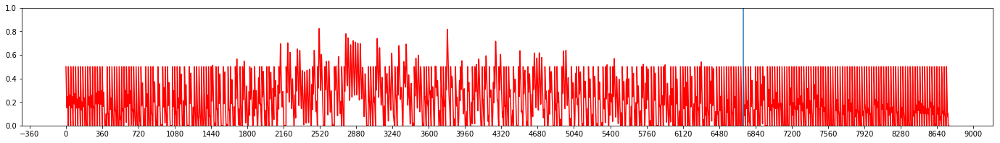

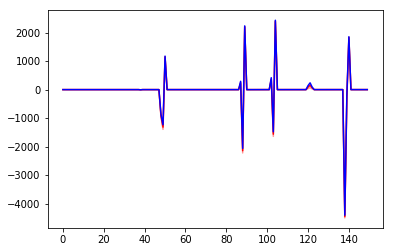

Iteration 226:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.294
Violation Counter 	= 295


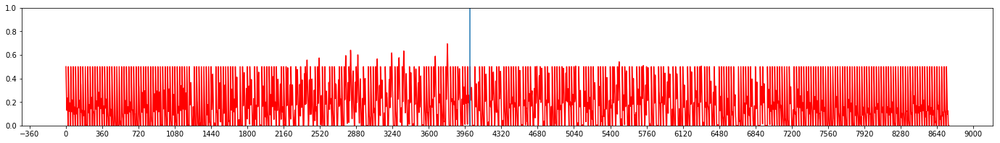

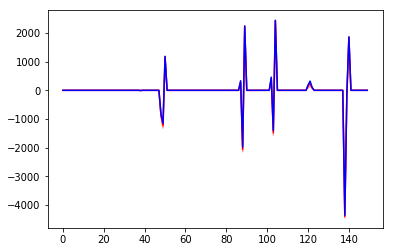

Iteration 227:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.299
Violation Counter 	= 294


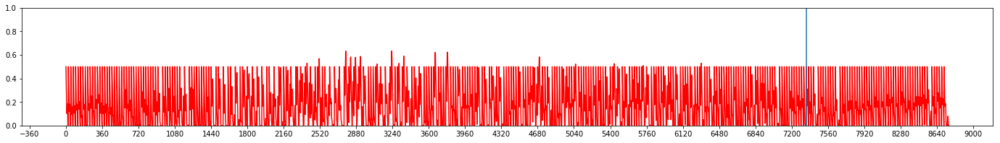

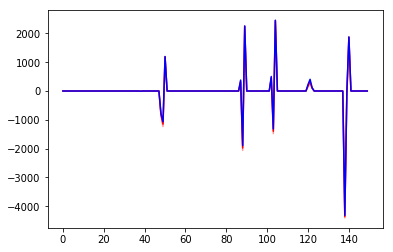

Iteration 228:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.953
Violation Counter 	= 263


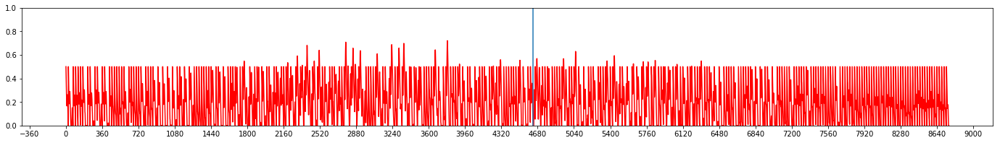

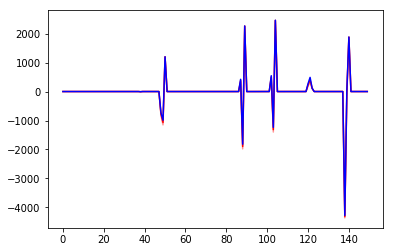

Iteration 229:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.873
Violation Counter 	= 247


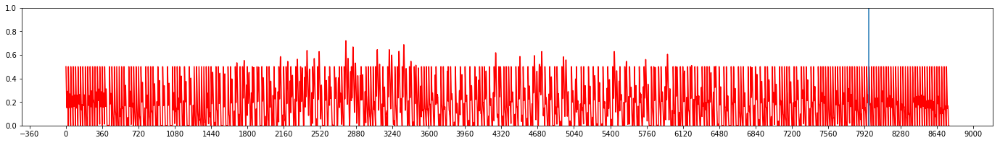

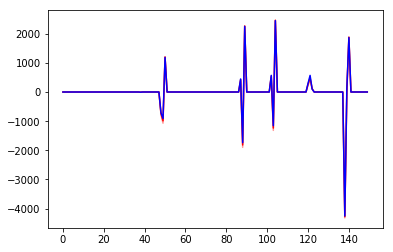

Iteration 230:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.117
Violation Counter 	= 282


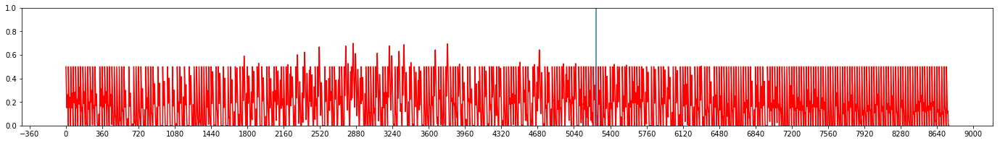

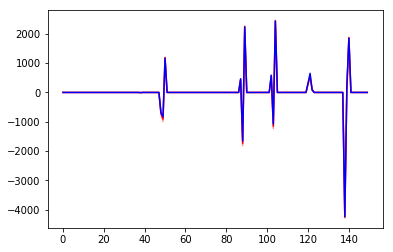

Iteration 231:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.802
Violation Counter 	= 226


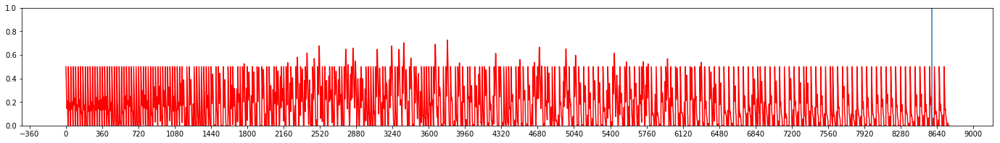

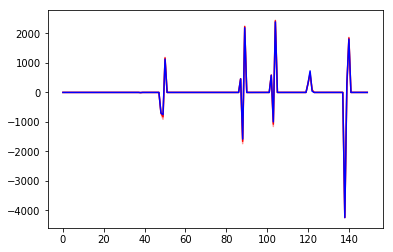

Iteration 232:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.211
Violation Counter 	= 137


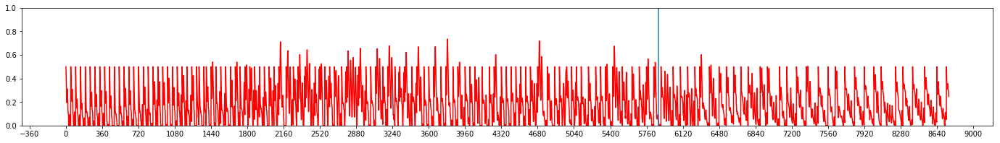

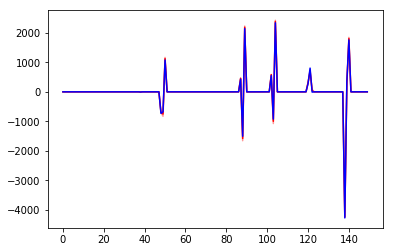

Iteration 233:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.082
Violation Counter 	= 122


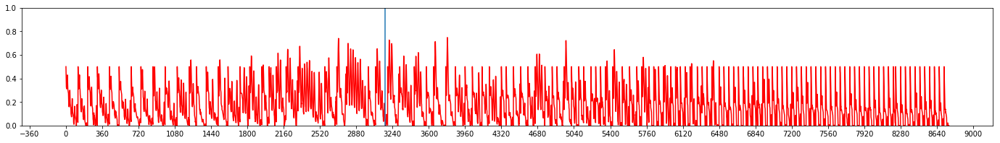

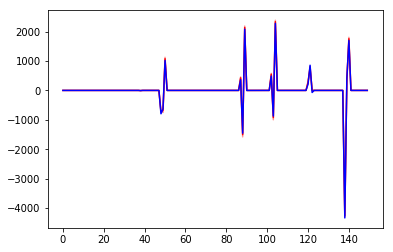

Iteration 234:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.813
Violation Counter 	= 234


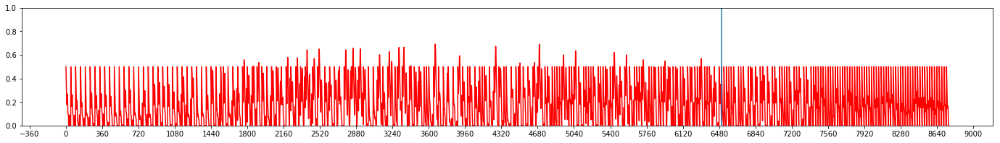

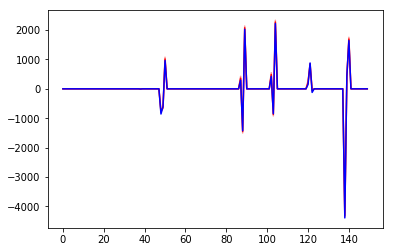

Iteration 235:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.888
Violation Counter 	= 246


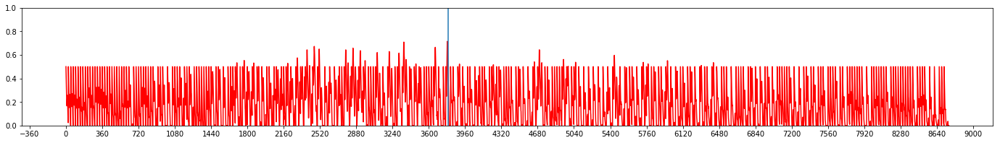

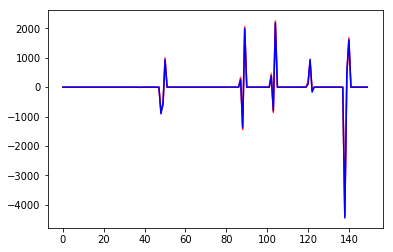

Iteration 236:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.557
Violation Counter 	= 186


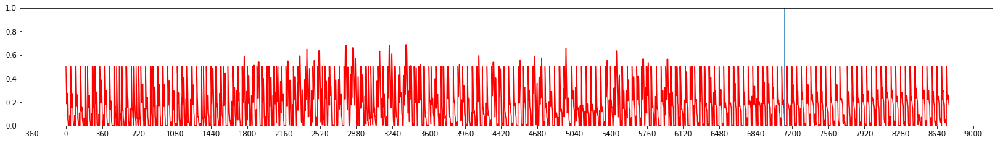

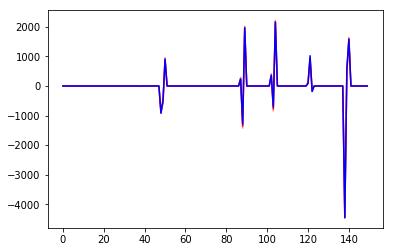

Iteration 237:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.210
Violation Counter 	= 157


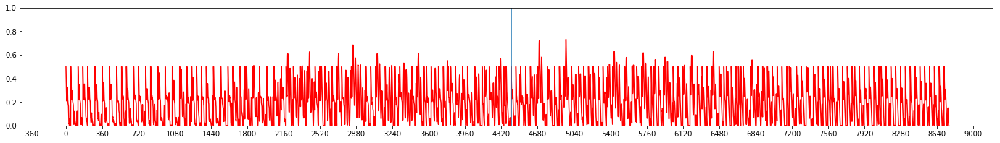

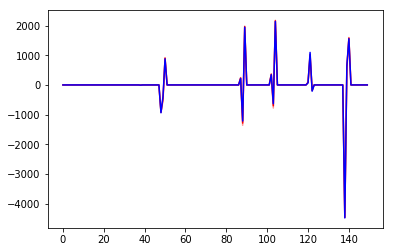

Iteration 238:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.266
Violation Counter 	= 191


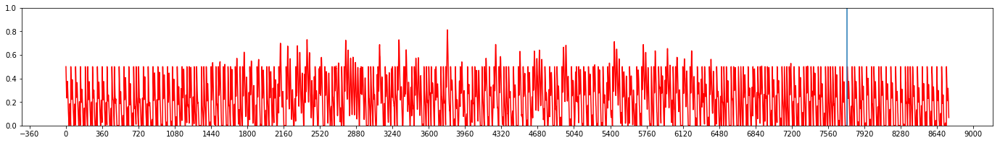

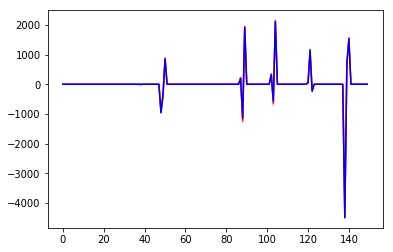

Iteration 239:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.019
Violation Counter 	= 124


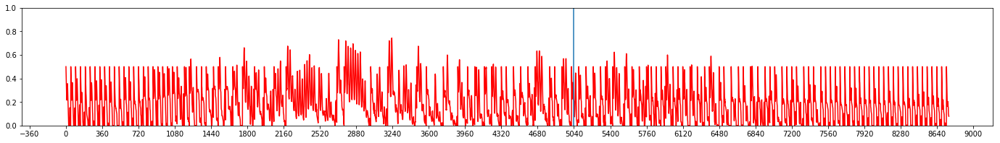

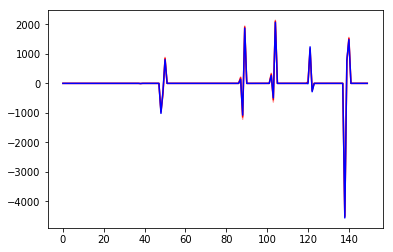

Iteration 240:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.747
Violation Counter 	= 216


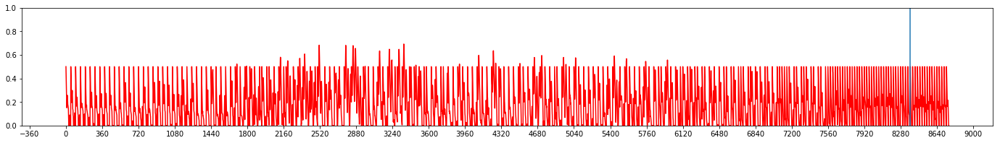

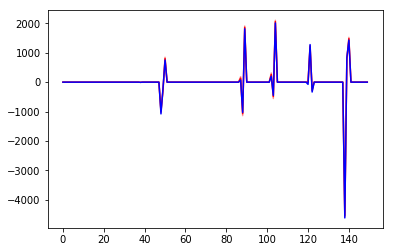

Iteration 241:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.723
Violation Counter 	= 214


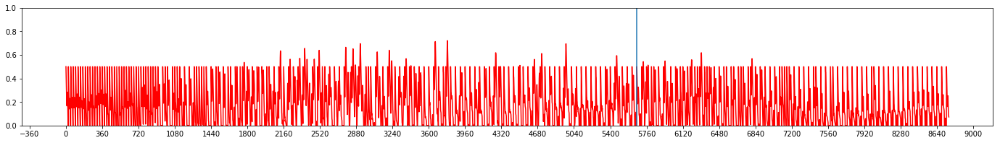

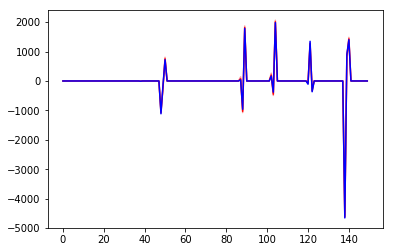

Iteration 242:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.562
Violation Counter 	= 87


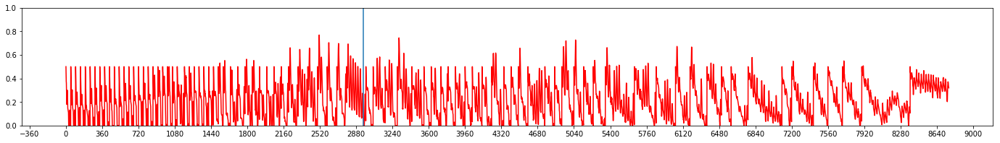

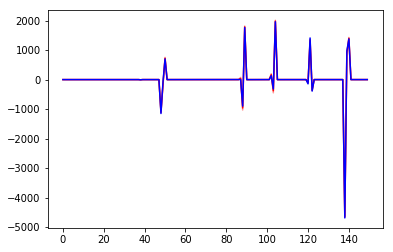

Iteration 243:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.459
Violation Counter 	= 62


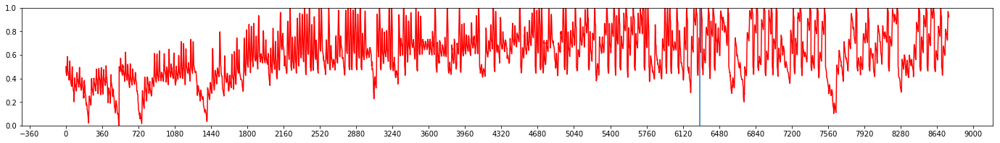

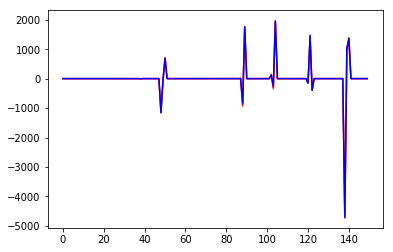

Iteration 244:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.020
Violation Counter 	= 99


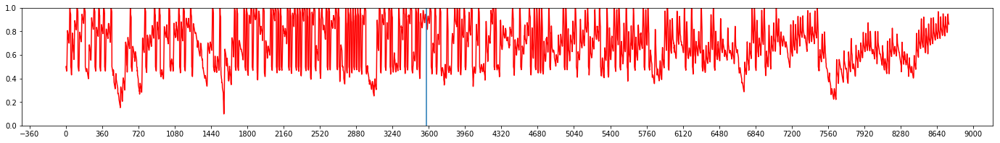

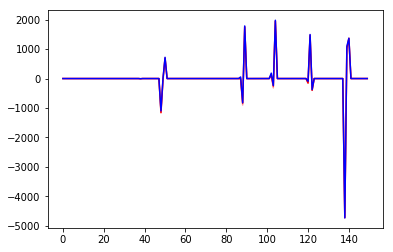

Iteration 245:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.474
Violation Counter 	= 59


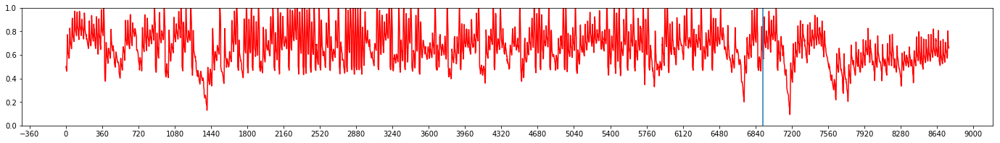

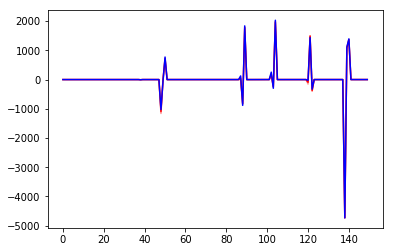

Iteration 246:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.169
Violation Counter 	= 64


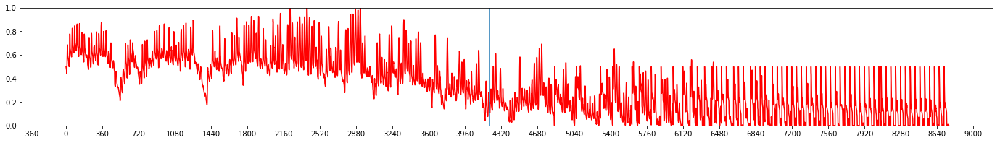

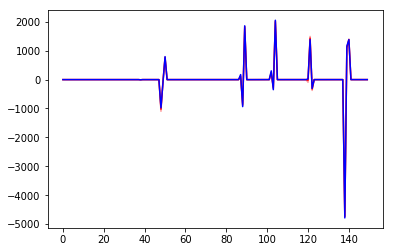

Iteration 247:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.507
Violation Counter 	= 80


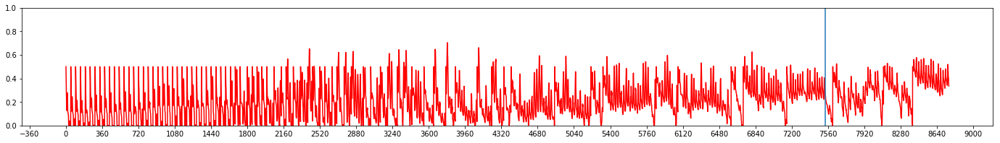

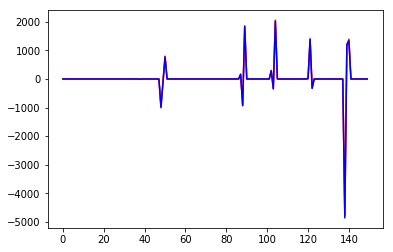

Iteration 248:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.525
Violation Counter 	= 65


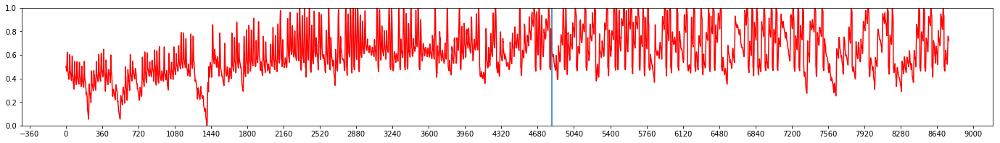

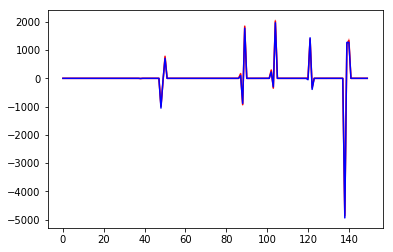

Iteration 249:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.679
Violation Counter 	= 53


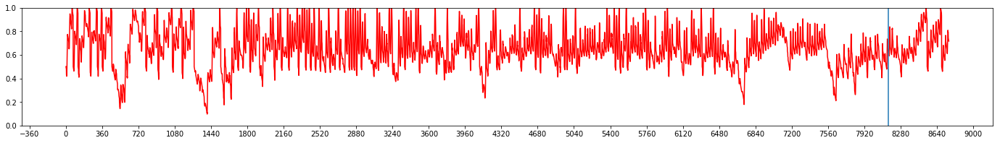

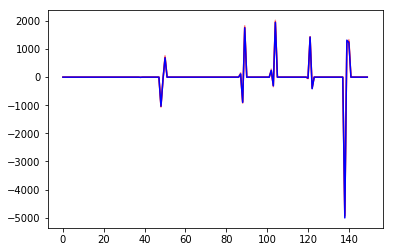

Iteration 250:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.013
Violation Counter 	= 76


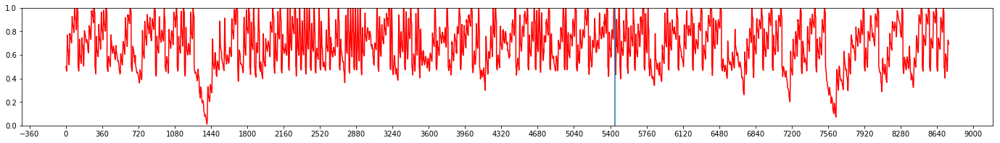

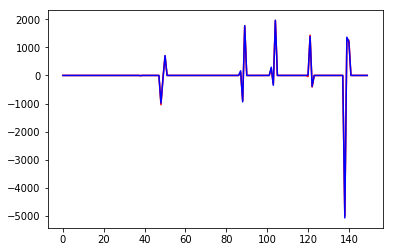

Iteration 251:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.172
Violation Counter 	= 80


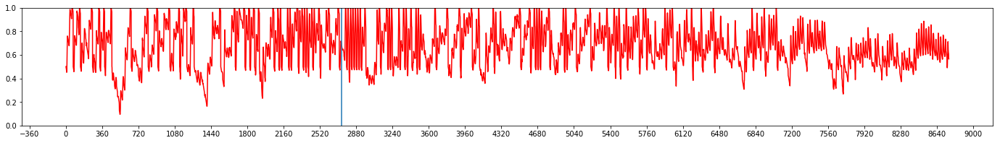

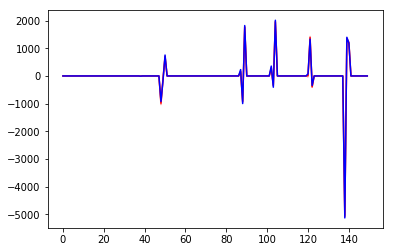

Iteration 252:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.060
Violation Counter 	= 92


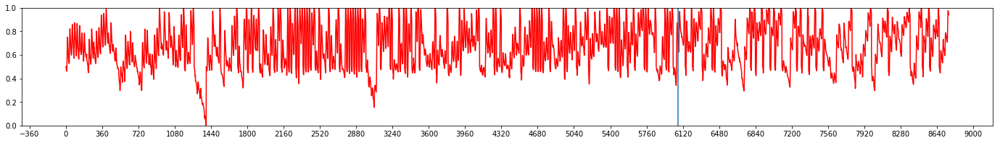

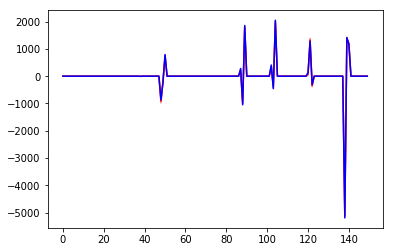

Iteration 253:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.228
Violation Counter 	= 96


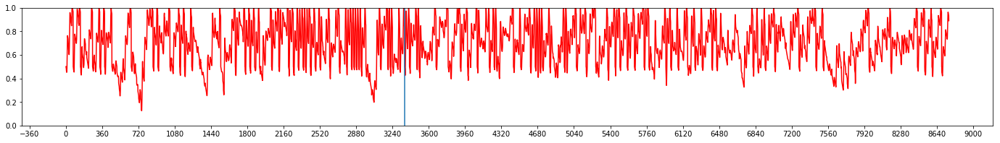

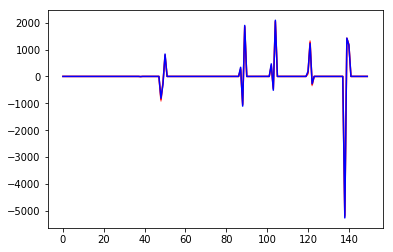

Iteration 254:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.213
Violation Counter 	= 102


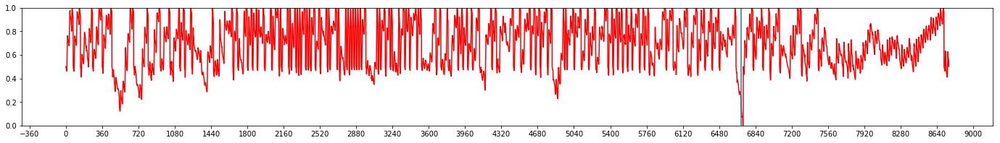

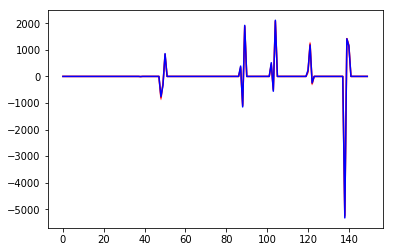

Iteration 255:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.608
Violation Counter 	= 12


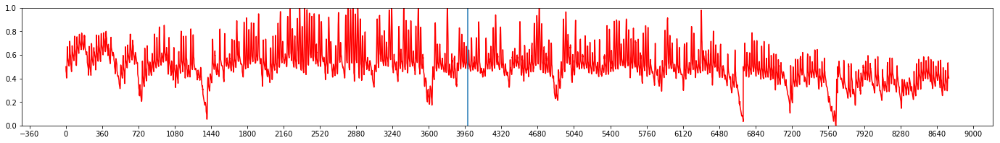

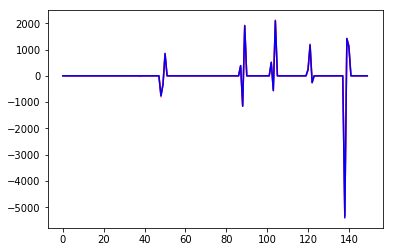

Iteration 256:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.484
Violation Counter 	= 3


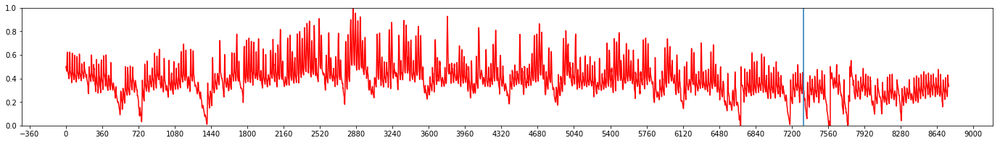

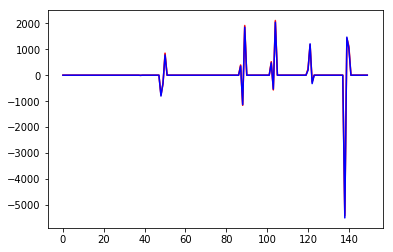

Iteration 257:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    1.039
Violation Counter 	= 4


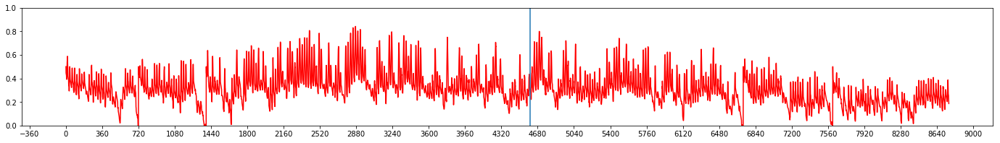

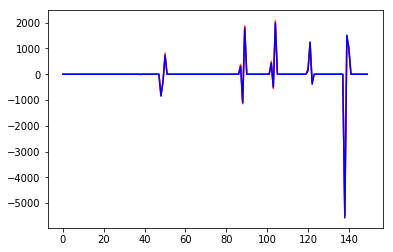

Iteration 258:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=    0.253
Violation Counter 	= 16


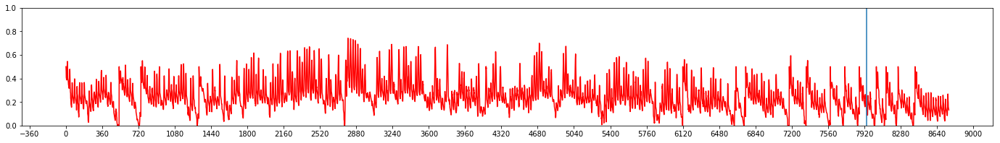

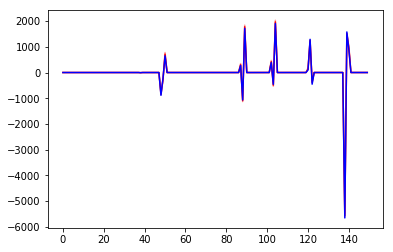

Iteration 259:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.445
Violation Counter 	= 29


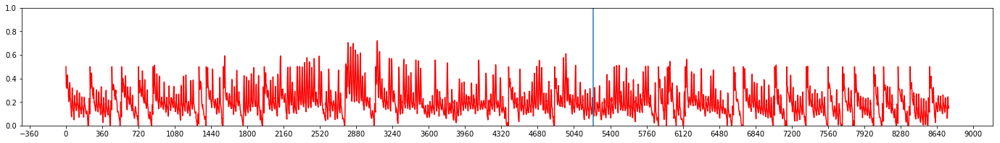

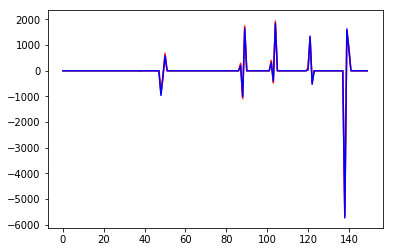

Iteration 260:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.577
Violation Counter 	= 36


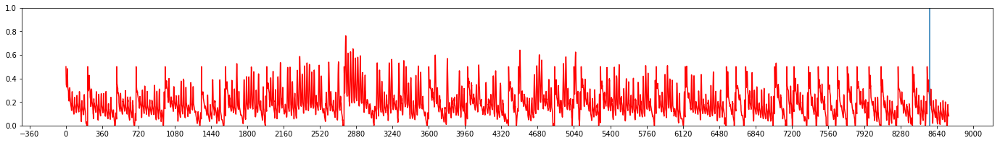

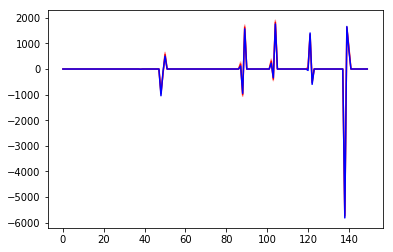

Iteration 261:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.727
Violation Counter 	= 47


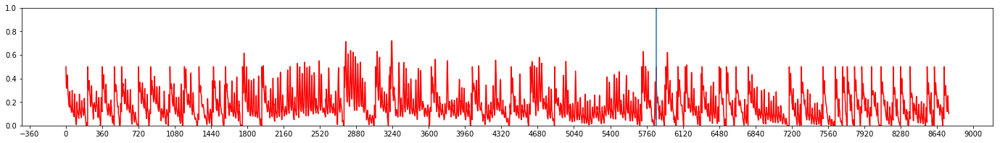

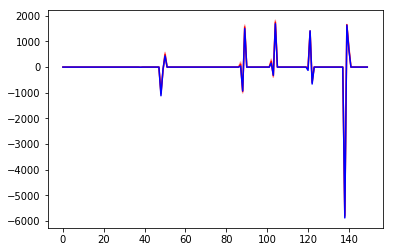

Iteration 262:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.041
Violation Counter 	= 91


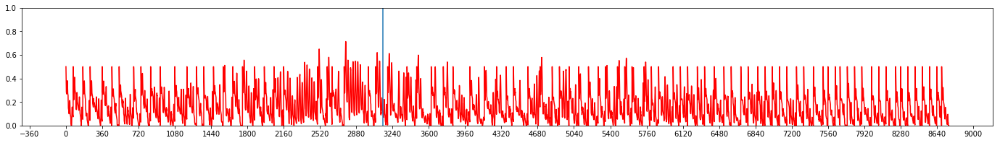

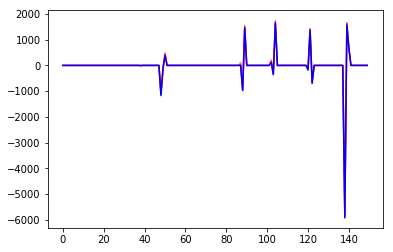

Iteration 263:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.311
Violation Counter 	= 130


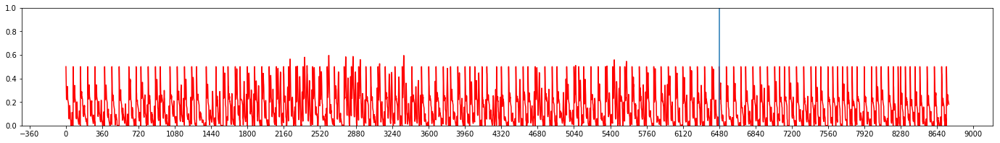

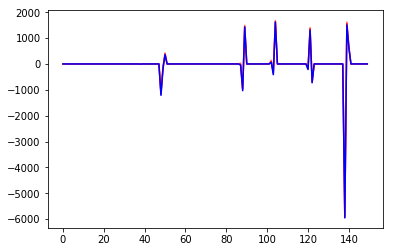

Iteration 264:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.518
Violation Counter 	= 157


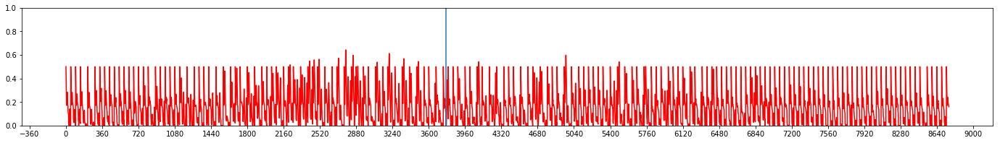

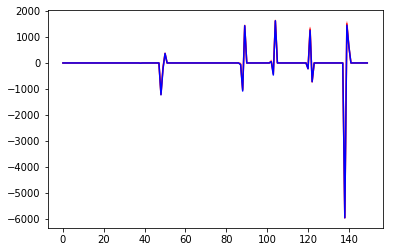

Iteration 265:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.619
Violation Counter 	= 168


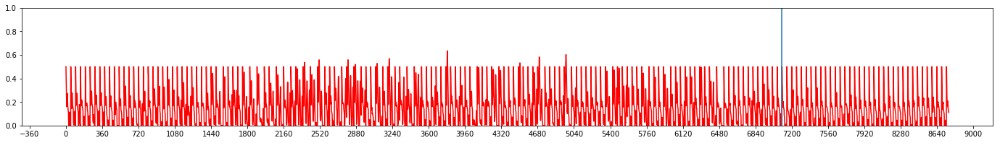

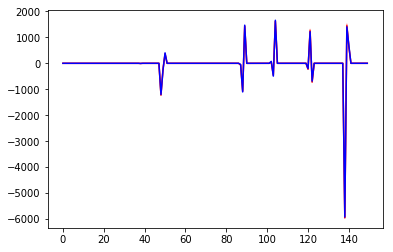

Iteration 266:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.579
Violation Counter 	= 174


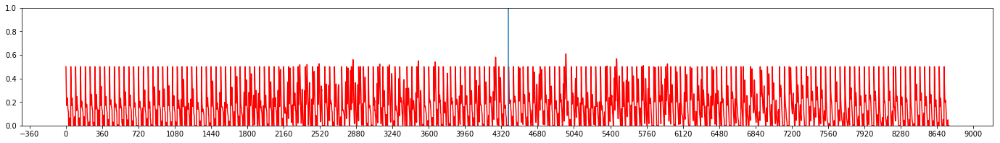

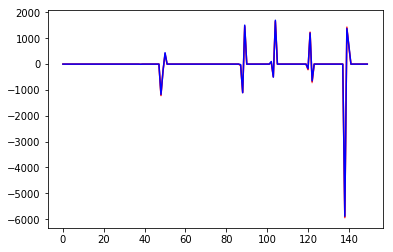

Iteration 267:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.840
Violation Counter 	= 221


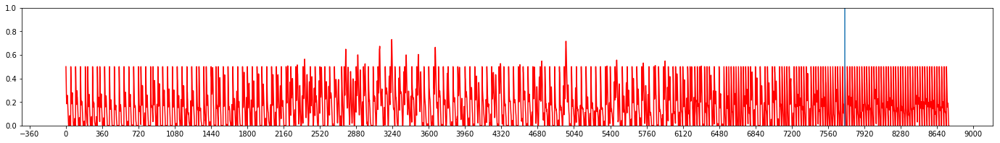

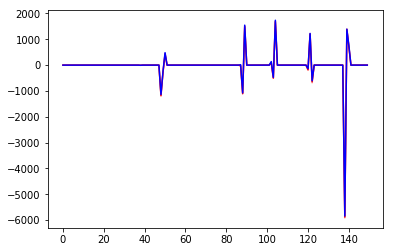

Iteration 268:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.759
Violation Counter 	= 218


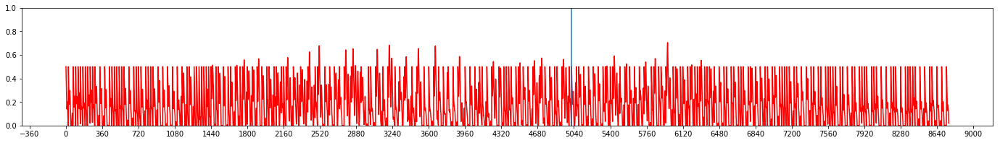

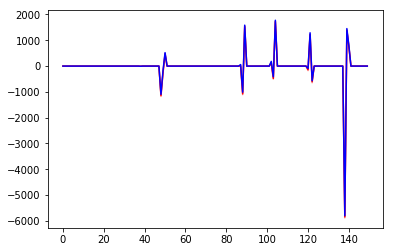

Iteration 269:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.713
Violation Counter 	= 207


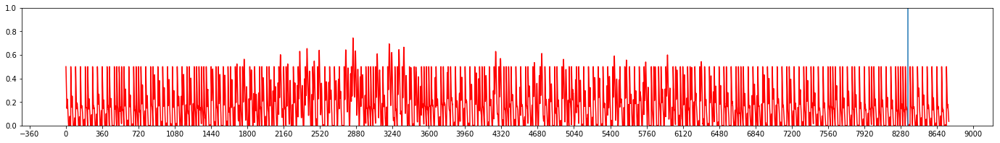

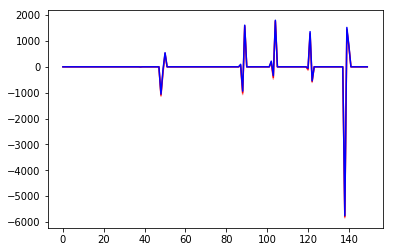

Iteration 270:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.793
Violation Counter 	= 210


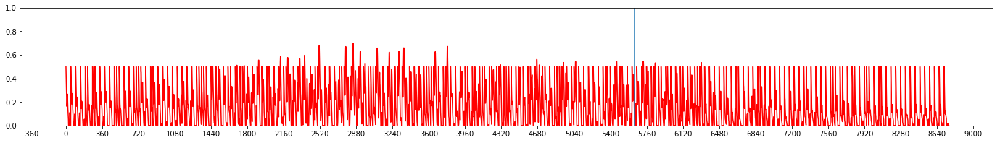

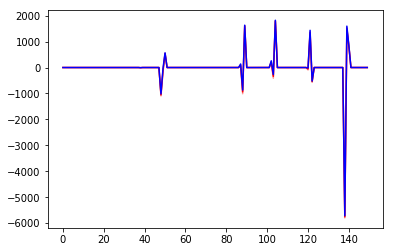

Iteration 271:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.745
Violation Counter 	= 184


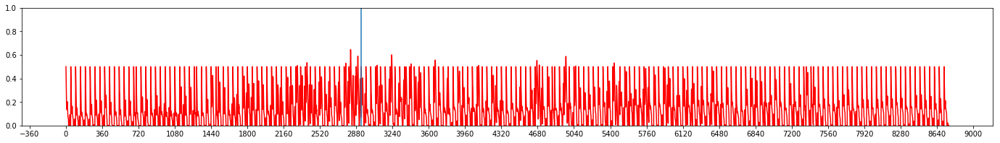

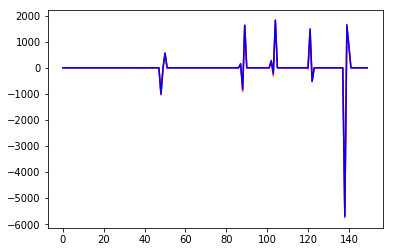

Iteration 272:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.537
Violation Counter 	= 173


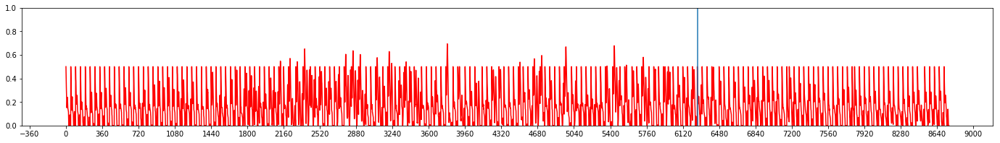

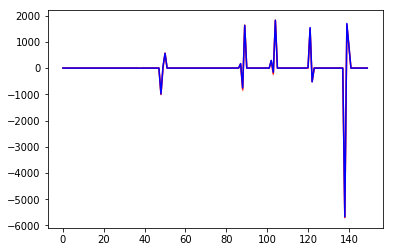

Iteration 273:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.393
Violation Counter 	= 161


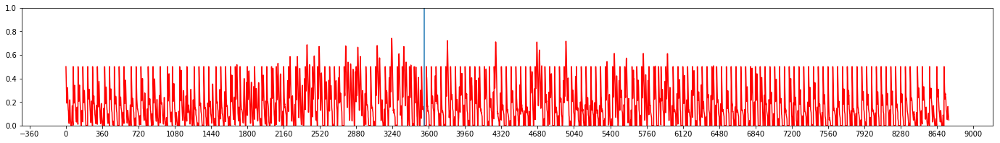

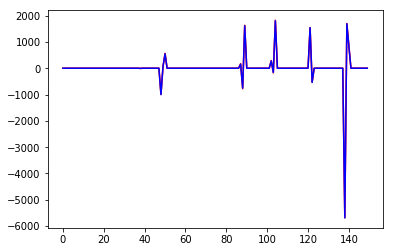

Iteration 274:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.964
Violation Counter 	= 130


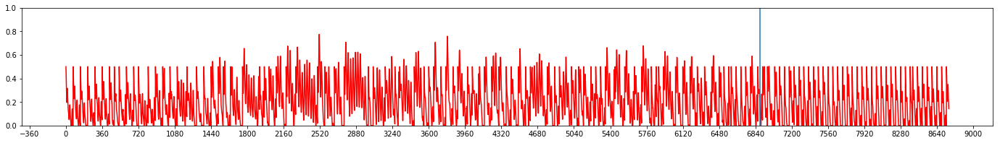

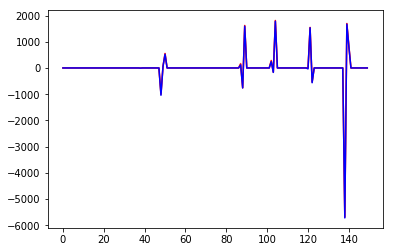

Iteration 275:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.587
Violation Counter 	= 187


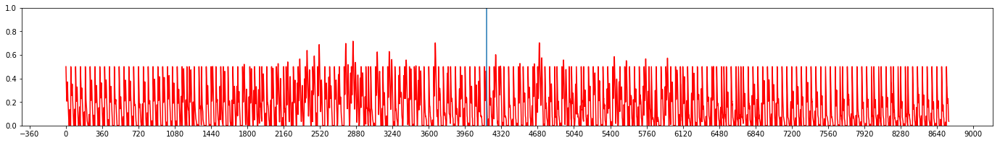

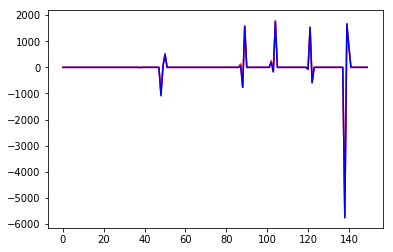

Iteration 276:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.516
Violation Counter 	= 174


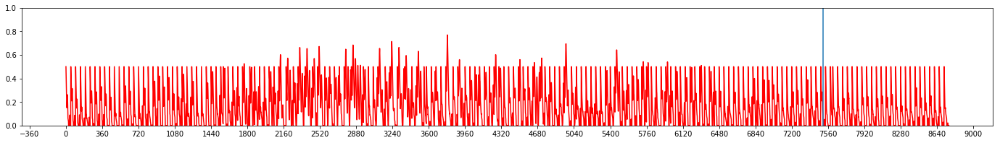

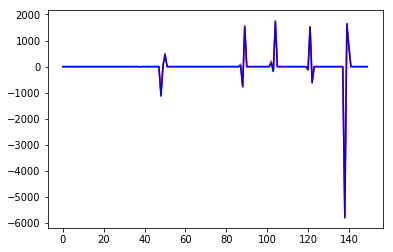

Iteration 277:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.519
Violation Counter 	= 172


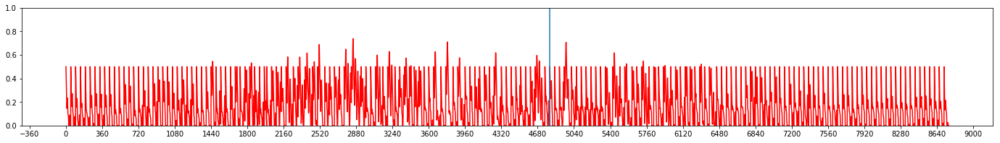

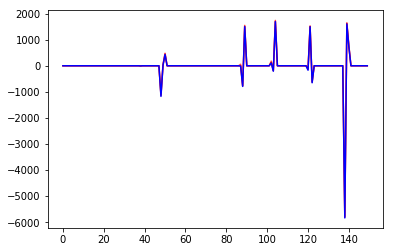

Iteration 278:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.658
Violation Counter 	= 176


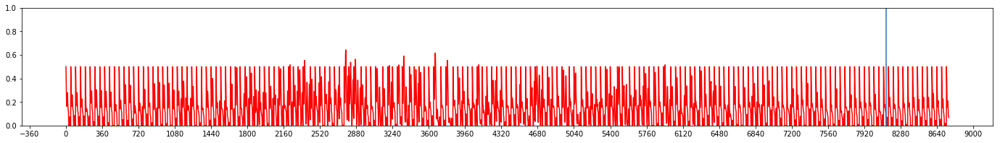

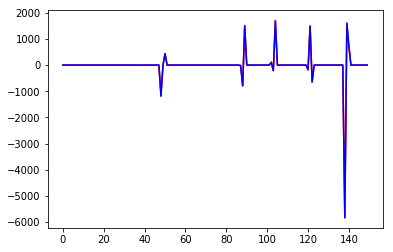

Iteration 279:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.687
Violation Counter 	= 178


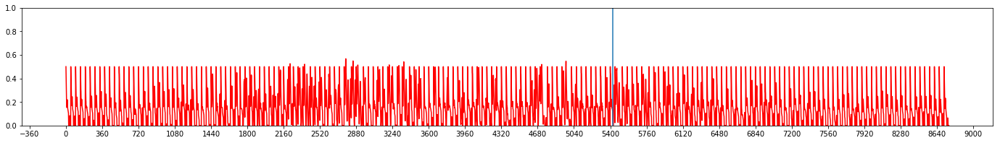

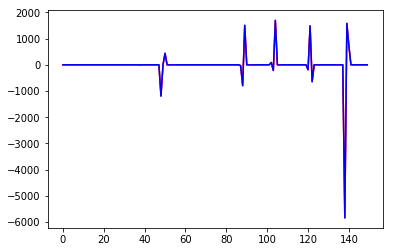

Iteration 280:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.723
Violation Counter 	= 181


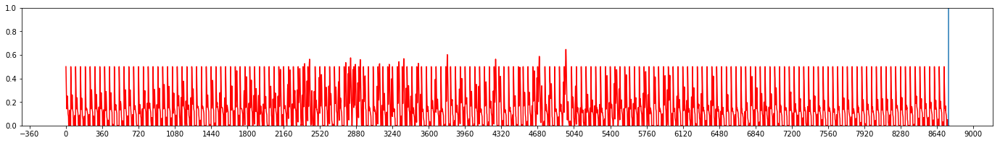

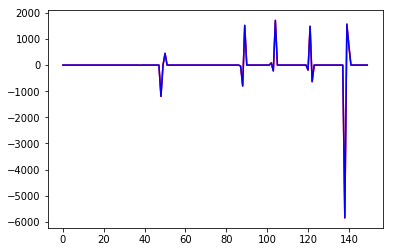

Iteration 281:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.545
Violation Counter 	= 175


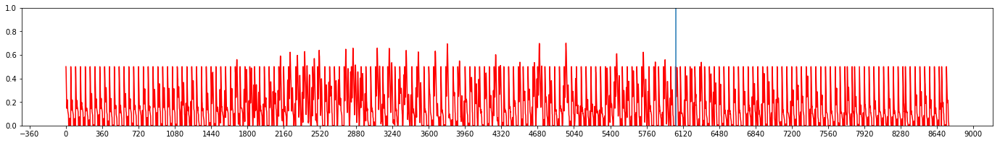

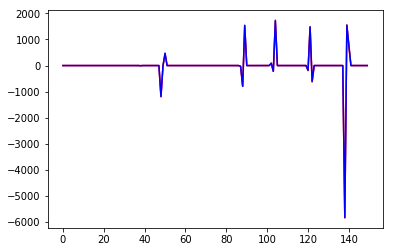

Iteration 282:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.533
Violation Counter 	= 171


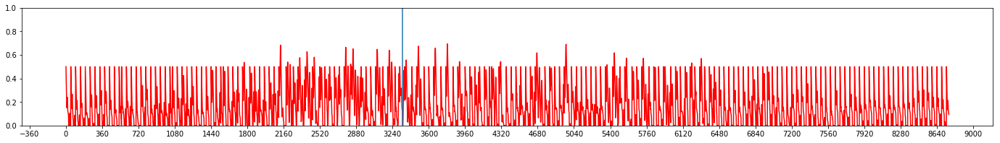

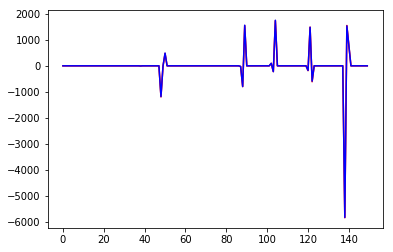

Iteration 283:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.390
Violation Counter 	= 161


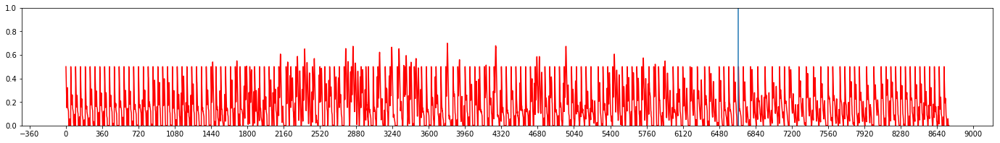

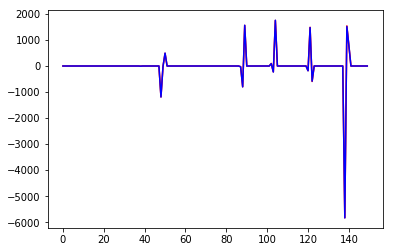

Iteration 284:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.594
Violation Counter 	= 182


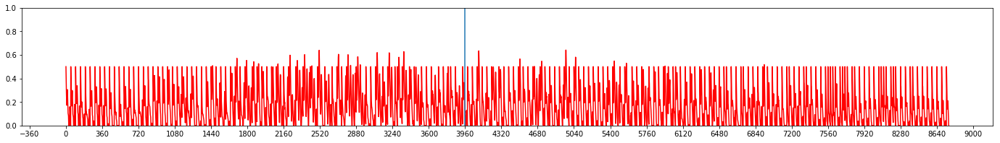

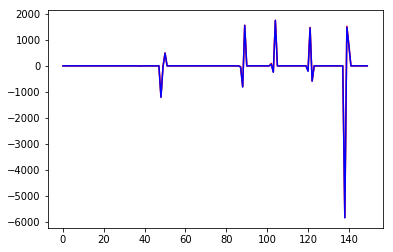

Iteration 285:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.648
Violation Counter 	= 178


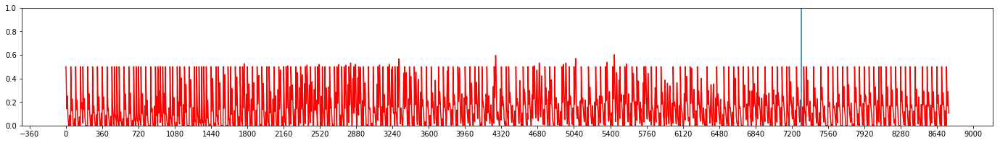

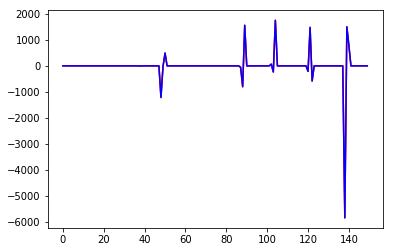

Iteration 286:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.015
Violation Counter 	= 242


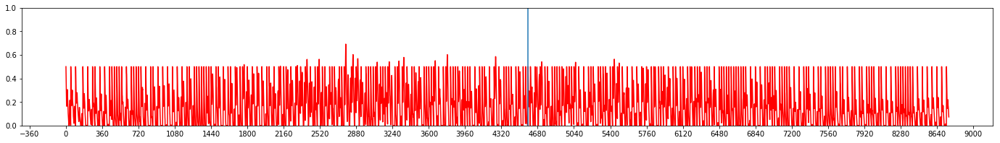

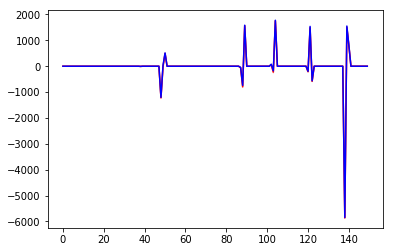

Iteration 287:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.001
Violation Counter 	= 260


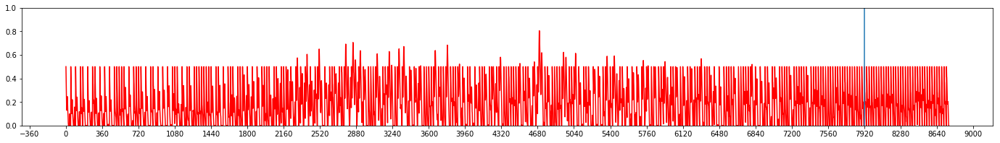

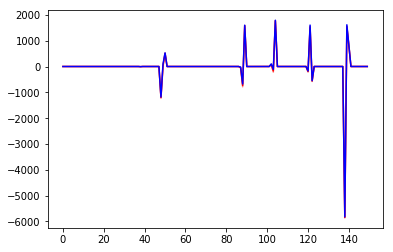

Iteration 288:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.914
Violation Counter 	= 233


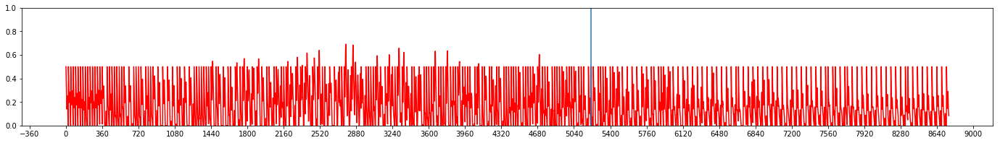

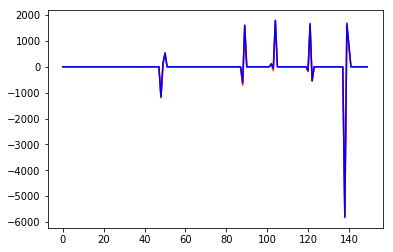

Iteration 289:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.944
Violation Counter 	= 219


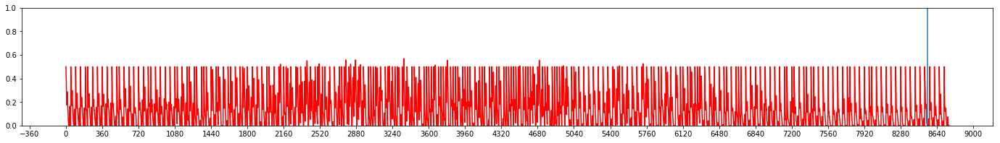

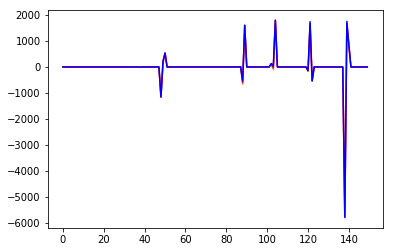

Iteration 290:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.729
Violation Counter 	= 183


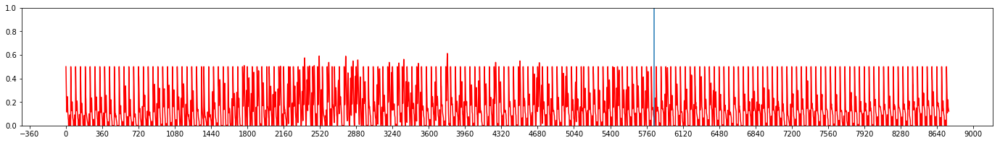

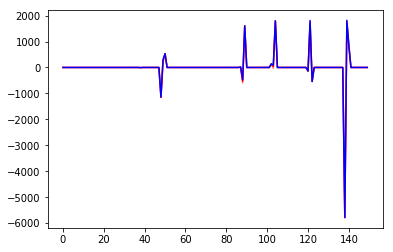

Iteration 291:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.698
Violation Counter 	= 178


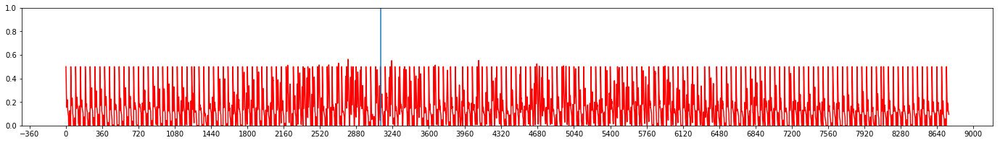

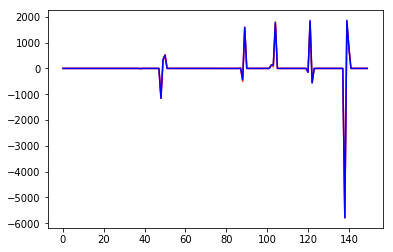

Iteration 292:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.687
Violation Counter 	= 182


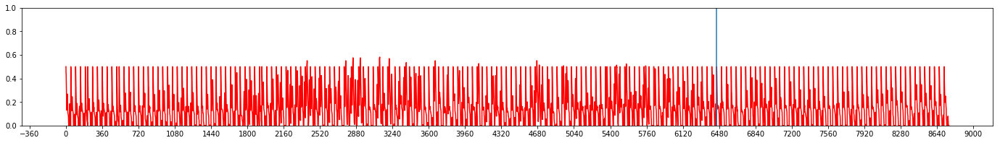

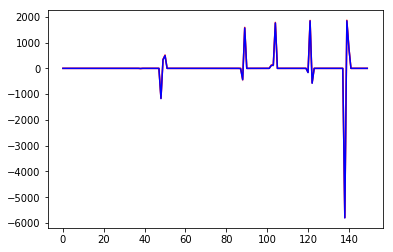

Iteration 293:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.551
Violation Counter 	= 178


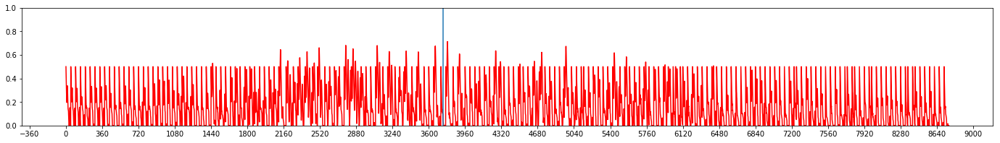

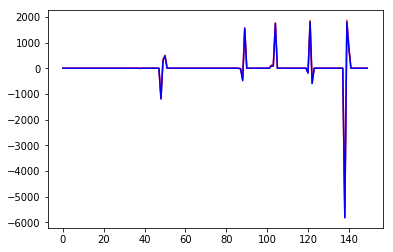

Iteration 294:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.588
Violation Counter 	= 180


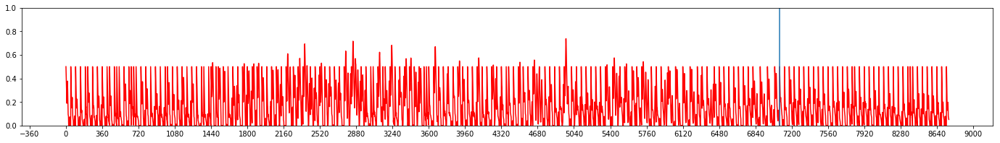

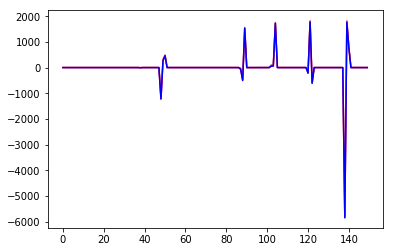

Iteration 295:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.834
Violation Counter 	= 196


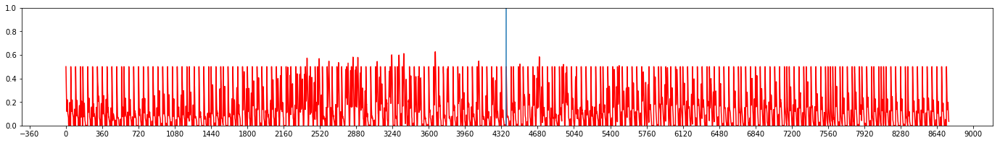

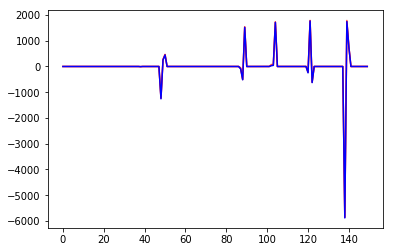

Iteration 296:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.659
Violation Counter 	= 186


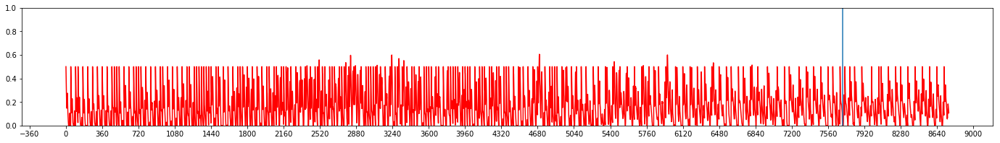

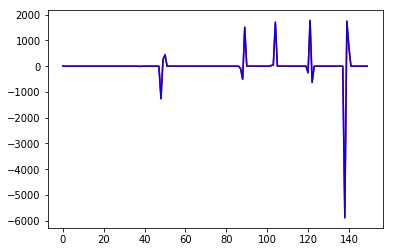

Iteration 297:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.508
Violation Counter 	= 78


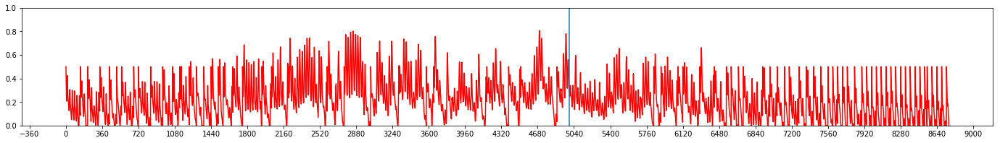

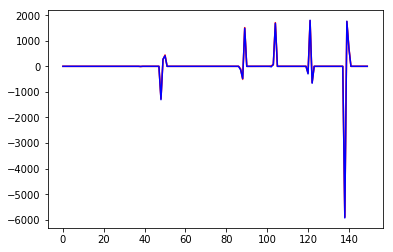

Iteration 298:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.771
Violation Counter 	= 227


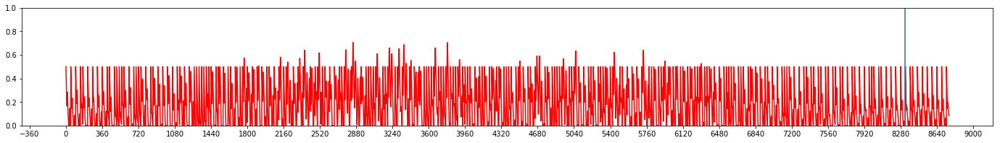

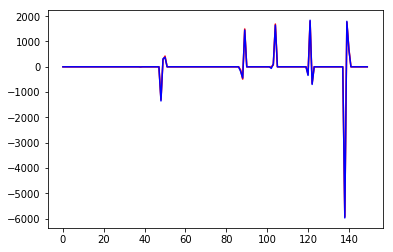

Iteration 299:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.814
Violation Counter 	= 227


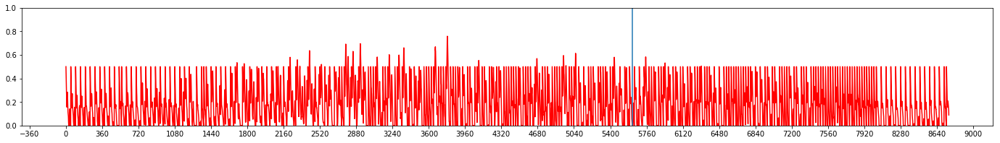

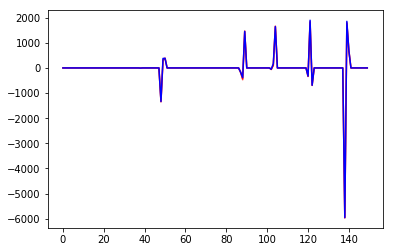

Iteration 300:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.889
Violation Counter 	= 242


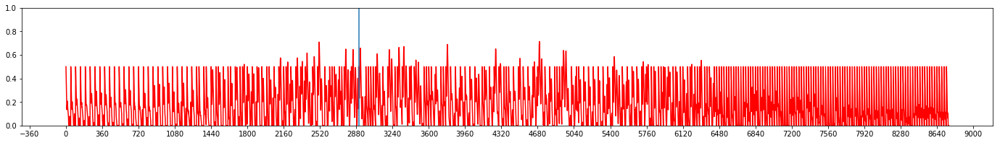

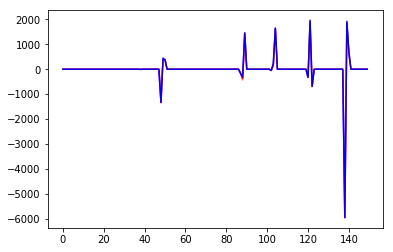

Iteration 301:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.267
Violation Counter 	= 286


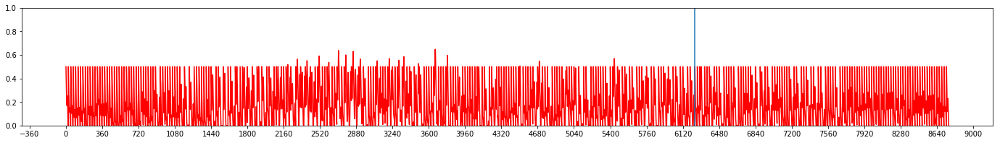

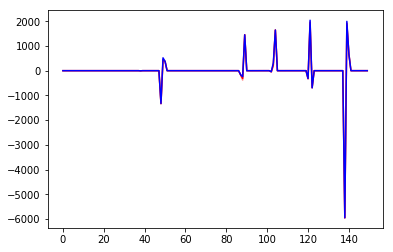

Iteration 302:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.052
Violation Counter 	= 254


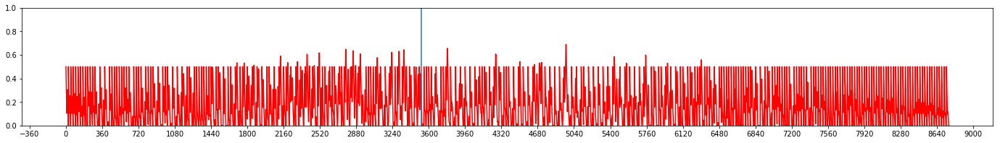

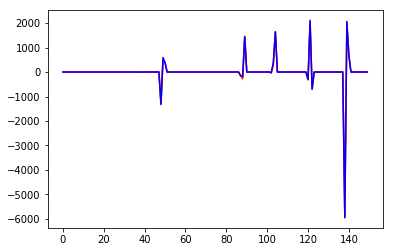

Iteration 303:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.818
Violation Counter 	= 216


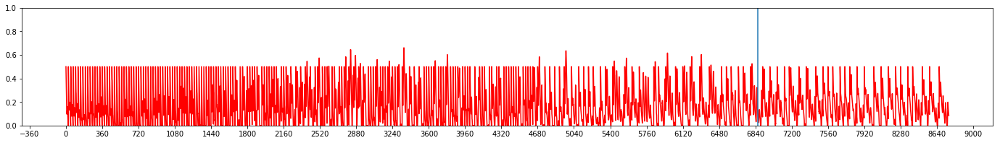

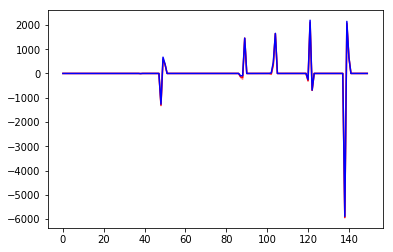

Iteration 304:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -0.845
Violation Counter 	= 105


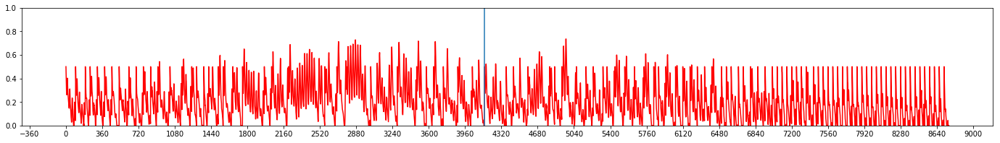

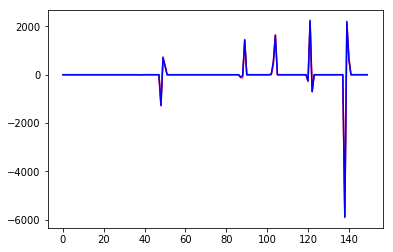

Iteration 305:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.932
Violation Counter 	= 256


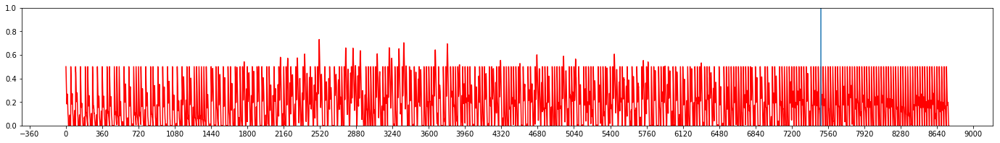

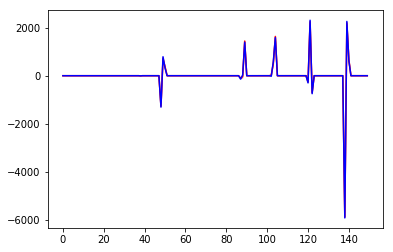

Iteration 306:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.005
Violation Counter 	= 271


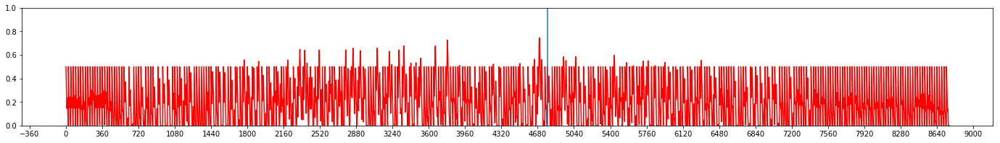

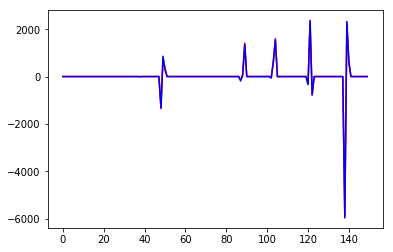

Iteration 307:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.035
Violation Counter 	= 272


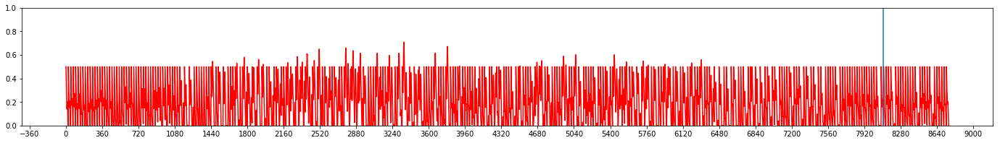

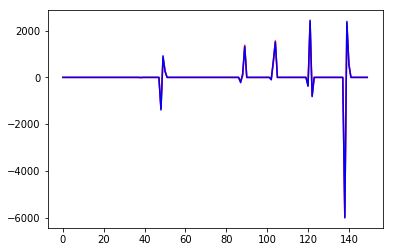

Iteration 308:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.514
Violation Counter 	= 183


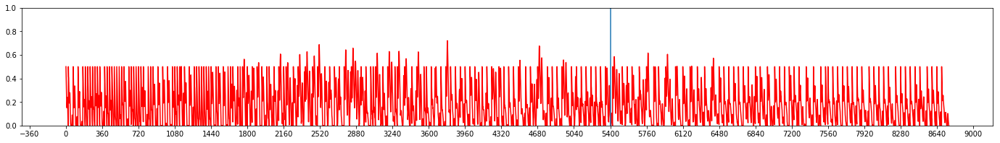

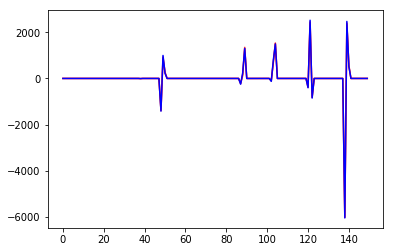

Iteration 309:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.475
Violation Counter 	= 177


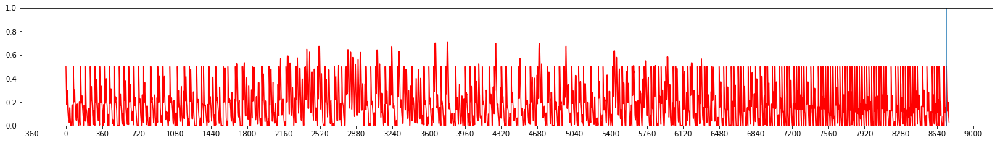

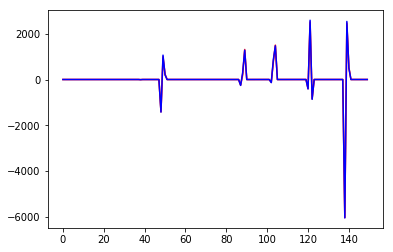

Iteration 310:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.073
Violation Counter 	= 264


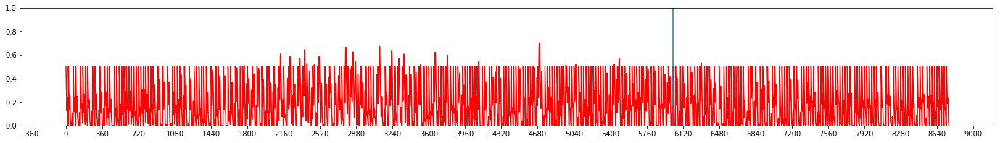

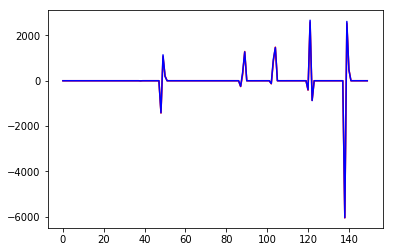

Iteration 311:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.914
Violation Counter 	= 255


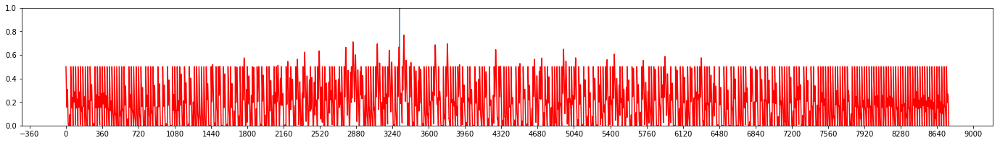

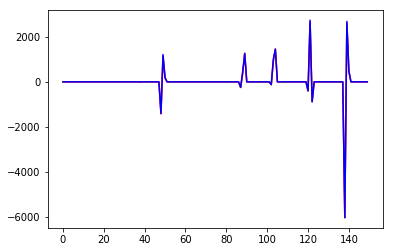

Iteration 312:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.993
Violation Counter 	= 274


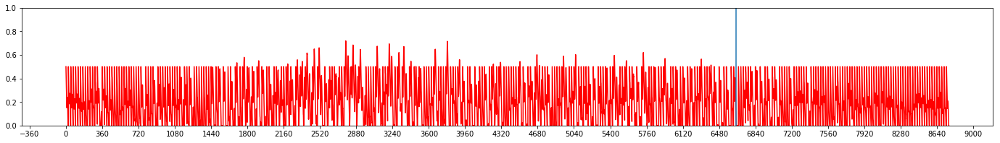

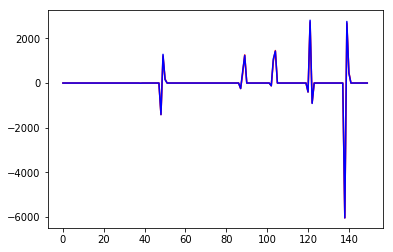

Iteration 313:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.888
Violation Counter 	= 243


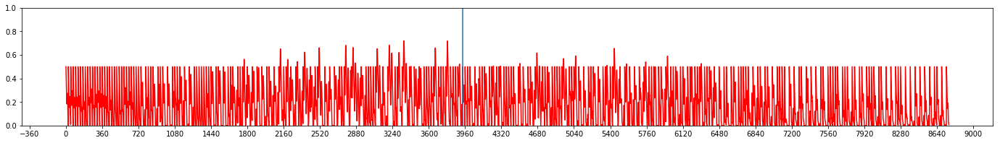

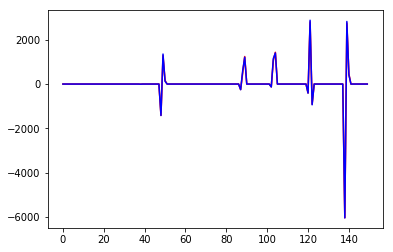

Iteration 314:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.857
Violation Counter 	= 221


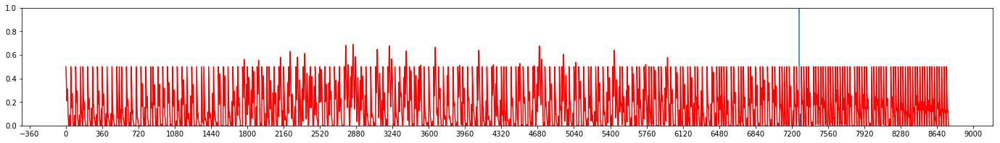

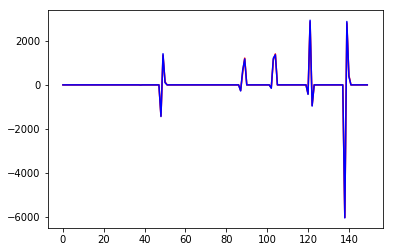

Iteration 315:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.792
Violation Counter 	= 215


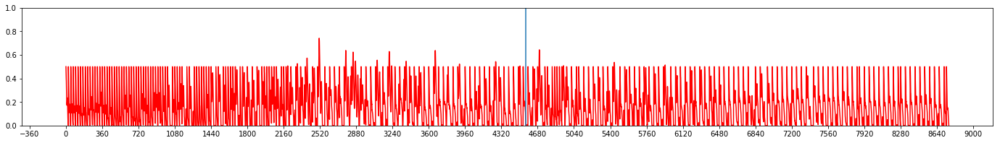

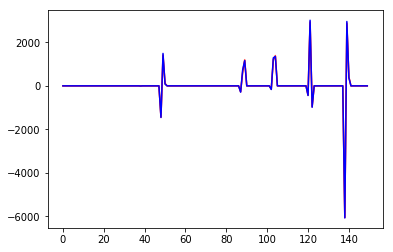

Iteration 316:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.482
Violation Counter 	= 153


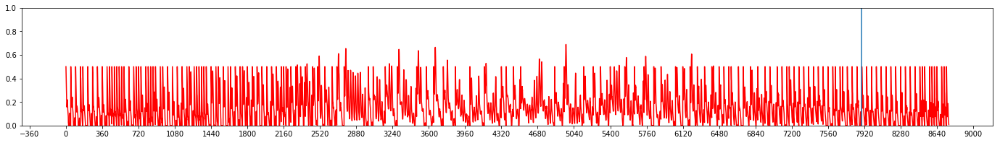

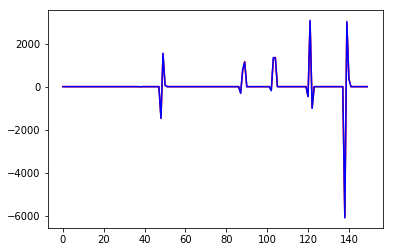

Iteration 317:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.273
Violation Counter 	= 299


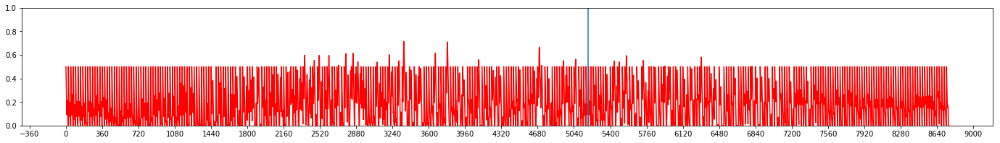

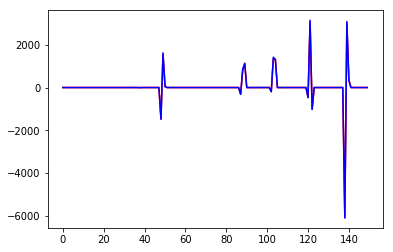

Iteration 318:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -2.045
Violation Counter 	= 265


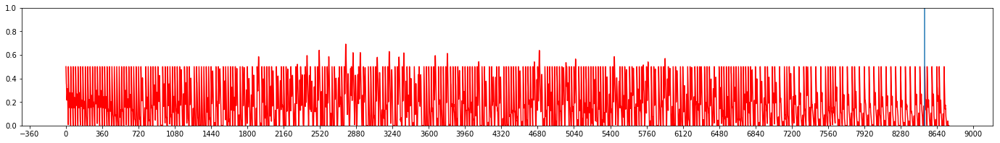

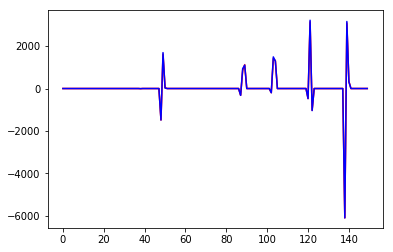

Iteration 319:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.792
Violation Counter 	= 225


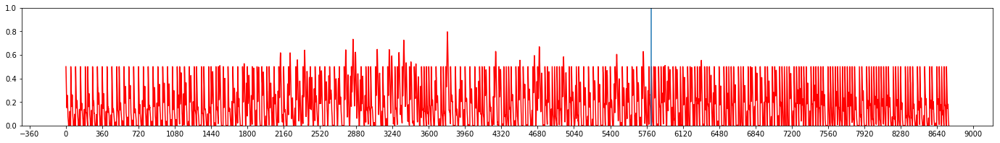

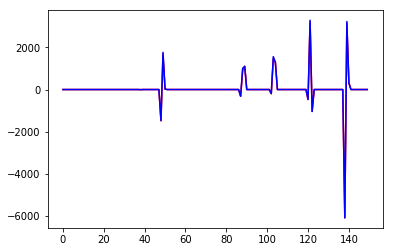

Iteration 320:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.819
Violation Counter 	= 232


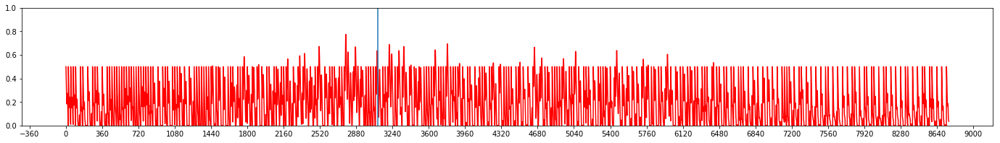

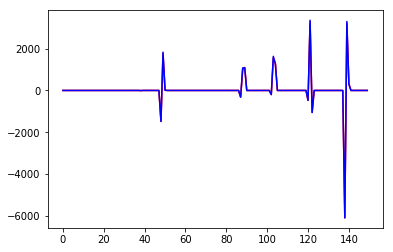

Iteration 321:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True
Average Reward 		=   -1.353
Violation Counter 	= 149


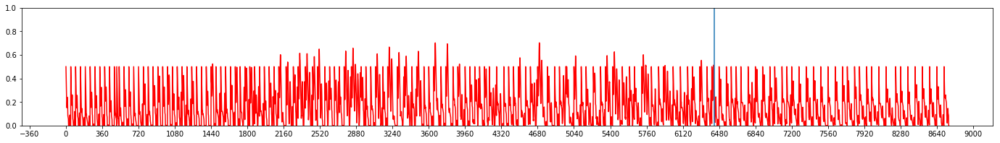

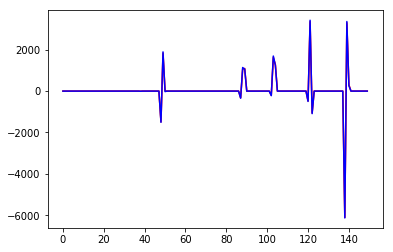

Iteration 322:  TOKYO, 2009 
EPSILON = 0.9, LR = 0.01, RST_FLAG = True


In [ ]:
#TRAIN USING data from TOKYO, WAKKANAI, MINAMIDAITO  FROM 2005 to 2015 on pre-trained model
#Simulating actual working
#No Random Battery 
#No battery reset
#No Shuffle
#No day_balance
dqn = DQN()
old = dqn.eval_net.fc1.weight.data.numpy().flatten()
old2 = old


best_iteration = -1
best_avg_reward = -1000 #initialize best average reward to very low value
reset_flag = True #put CAPM in traimode
reset_counter = 0 #count number of times the battery had to be reset
change_hr = 0
# PFILENAME = ''.join(random.choice(string.ascii_uppercase + string.digits) for _ in range(8)) #create random filename
# BFILENAME = "best"+PFILENAME + ".pt" #this file stores the best model
# TFILENAME = "terminal"+PFILENAME + ".pt" #this file stores the last model

avg_reward_rec = [] #record the yearly average rewards over the entire duration of training
violation_rec = []
print('\nTRAINING IN PROGRESS\n')
Y_EAR = 2004
for iteration in range(NO_OF_ITERATIONS):
    LOCATION = 'tokyo' # random.choice(['tokyo','wakkanai','minamidaito'])
    YEAR = 2009#Y_EAR + iteration%11#random.choice(np.arange(2005,2015))
    capm = CAPM(LOCATION,YEAR,shuffle=False, trainmode=reset_flag) #instantiate the CAPM class
    capm.eno = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
    capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object
#     clear_output()
    print('Iteration {}:  {}, {} '.format(iteration, LOCATION.upper(), YEAR))
    print('EPSILON = {}, LR = {}, RST_FLAG = {}'.format(EPSILON, LR, reset_flag))

    

    s, r, day_end, year_end = capm.reset()
    yr_record = np.empty(4)

    record = np.empty(4) #record for battery, henergy, reward and action
    transition_rec = np.zeros((capm.eno.TIME_STEPS, N_STATES * 2 + 2)) #record all the transition in one day

    while True:
        a = dqn.choose_action(s)

        # present state = [batt, enp, henergy]
        record = np.vstack((record, [s[0],s[2],r, a])) # record battery, henergy, reward and action for troubleshooting
                                                       # However, we are interested only in the reward
        yr_record = np.vstack((yr_record, [s[0],s[2],r, a]))

        # take action
        s_, r, day_end, year_end = capm.step(a)
        
        temp_transitions = np.hstack((s, [a, r], s_))
        transition_rec[capm.eno.hr-1,:] = temp_transitions

        if (day_end):
            transition_rec[:,5] = r #broadcast reward to all states
            decay_factor = [i for i in (LAMBDA**n for n in reversed(range(0, capm.eno.TIME_STEPS)))]
            transition_rec[:,5] = transition_rec[:,5] * decay_factor #decay reward proportionately
            dqn.store_day_transition(transition_rec)
#             if (capm.BMIN == capm.batt or capm.BMAX == capm.batt):
#                 capm.batt = capm.BOPT

        if dqn.memory_counter > MEMORY_CAPACITY:
            dqn.learn()
#             print("Learning:",capm.eno.year, capm.eno.day)

        if dqn.nettoggle:
            change_hr = capm.eno.day*24+capm.eno.hr
            dqn.nettoggle = not dqn.nettoggle

        if (year_end):
    #             print("End of Year")
            break

        # transition to new state
        s = s_

    record = np.delete(record, 0, 0) #remove the first row which is garbage
    reward_rec = record[:,2] #extract reward information from the record array
    reward_rec = reward_rec[reward_rec != 0] #remove all zero rewards in the middle of the days
    print("Average Reward \t\t= {:8.3f}".format(np.mean(reward_rec)))
    print("Violation Counter \t= {}".format(capm.violation_counter))

#     if(best_avg_reward < np.mean(reward_rec)):
#         best_avg_reward = np.mean(reward_rec)
    
#     if(best_avg_reward > 1.5 or iteration > 20):
#         EPSILON = 0.9
#         LR = 0.01
        
#     if (capm.violation_counter < 5):
#         reset_flag = False
#         EPSILON = 0.95
#         LR = 0.001
        

#     # Check if reward beats the High Score and possible save it    
#     if (iteration > 19): #save the best models only after 20 iterations
#         print("Best Score \t = {:8.3f} @ Iteration No. {}".format(best_avg_reward, best_iteration))
#         if(best_avg_reward < np.mean(reward_rec)):
#             best_iteration = iteration
#             best_avg_reward = np.mean(reward_rec)
#             print("Saving Model")
#             torch.save(dqn.eval_net.state_dict(), BFILENAME)
#     else:
#         print("\r")
    # Log the average reward in avg_reward_rec
    avg_reward_rec = np.append(avg_reward_rec, np.mean(reward_rec))
    violation_rec = np.append(violation_rec, capm.violation_counter)

    yr_record = np.delete(yr_record, 0, 0) #remove the first row which is garbage
#     NO_OF_DAYS = capm.eno.NO_OF_DAYS
#     yr_reward_rec = yr_record[:,2]
#     yr_reward_rec = yr_reward_rec[yr_reward_rec != 0]
    fig = plt.figure(figsize=(24,3))
    
    TIME_STEPS = capm.eno.TIME_STEPS
    NO_OF_DAYS = capm.eno.NO_OF_DAYS
    DAY_SPACING = 15
    TICK_SPACING = TIME_STEPS*DAY_SPACING
    
    ax = fig.add_subplot(111)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS),yr_record[:,0],'r')
    ax.set_ylim([0,1])
    ax.axvline(x=change_hr)

    ax.xaxis.set_major_locator(ticker.MultipleLocator(TICK_SPACING))
#     labels = [item for item in ax.get_xticklabels()]
#     print(labels)
#     labels [15:-1] = np.arange(0,NO_OF_DAYS,DAY_SPACING) #the first label is reserved to negative values
#     ax.set_xticklabels(labels)
    plt.show()

    new = dqn.eval_net.fc1.weight.data.numpy().flatten()
    plt.plot(old2,color='r', alpha=0.4)
    plt.plot(old,color='r')
    plt.plot(new,color='b')
    old2 = old
    old = new
    plt.show()


    # End of training
# Save the last model
# torch.save(dqn.eval_net.state_dict(), TFILENAME) 

In [ ]:
fig = plt.figure(figsize=(9,3))
# Plot the average reward log

ax1 = fig.add_subplot(111)
ax1.set_ylabel("Reward")
# ax1.set_ylim([-3,3]);
ax1.plot(avg_reward_rec,'k')


#Plot the violation record log
ax2 = ax1.twinx()
ax2.set_ylabel("Violations",color = 'g')
ax2.plot(violation_rec,'g')
for xpt in np.argwhere(violation_rec<40):
    ax2.axvline(x=xpt,color='r')
ax2.set_ylim([0,365]);

fig.tight_layout()

In [ ]:
# #BFILENAME -> loads the best model
# #TFILENAME -> loads the last model
# MODELFILE = BFILENAME
# TEST_LOCATION = 'tokyo'
# dqn = DQN()
# for TEST_YEAR in np.arange(2015,2018):
#     test_model(TEST_LOCATION, TEST_YEAR, MODELFILE, dqn)

In [ ]:
# #BFILENAME -> loads the best model
# #TFILENAME -> loads the last model
# MODELFILE = TFILENAME
# TEST_LOCATION = 'tokyo'
# dqn = DQN()
# for TEST_YEAR in np.arange(2016,2018)
#     test_model(TEST_LOCATION, TEST_YEAR, MODELFILE, dqn)

In [ ]:
# TEST_YEAR = 2018
# for TEST_LOCATION in ['tokyo','wakkanai','minamidaito']:
#     test_model(TEST_LOCATION, TEST_YEAR)

In [ ]:
# dqn = DQN()
# capm = CAPM(TEST_LOCATION,TEST_YEAR, shuffle=False, trainmode=False) #if reset is True
# capm.eno = ENO(TEST_LOCATION,TEST_YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
# capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object


# # load the required model
# dqn.eval_net.load_state_dict(torch.load(MODELFILE))
# dqn.eval_net.eval()
# print('Model Used: ',MODELFILE)

# s, r, day_end, year_end = capm.reset()
# yr_test_record = np.empty(4)

# while True:
#     a = dqn.choose_greedy_action(s)

#     #state = [batt, enp, henergy, fcast]
#     yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action

#     # take action
#     s_, r, day_end, year_end = capm.step(a)
    
# #     if day_end:
# #         if (capm.BMIN ==capm.batt or capm.batt == capm.BMAX):
# #             capm.batt = capm.BOPT
        

#     if year_end:
#         print("End of Test")
#         break

#     s = s_

# yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage

# #Plot the reward and battery for the entire year run
# title = TEST_LOCATION.upper() + ',' + str(TEST_YEAR)

# NO_OF_DAYS = capm.eno.NO_OF_DAYS
# yr_test_reward_rec = yr_test_record[:,2]
# yr_test_reward_rec = yr_test_reward_rec[yr_test_reward_rec != 0]
# print('Average Reward for',title, '=', np.mean(yr_test_reward_rec))


# fig = plt.figure(figsize=(24,10))
# fig.suptitle(title, fontsize=15)

# #     ax1 = fig.add_subplot(211)
# #     ax1.plot(yr_test_reward_rec)
# #     ax1.set_title("\n\nYear Run Reward")
# #     ax1.set_ylim([-3,1])

# ax2 = fig.add_subplot(111)
# ax2.plot(yr_test_record[:,0],'r')
# ax2.set_title("\n\nYear Run Battery")
# ax2.set_ylim([0,1])
# plt.sca(ax2)
# plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))

# fig.tight_layout()
# plt.show()
    

In [ ]:
# #Plot the reward and battery for the entire year run on a day by day basis
# title = TEST_LOCATION.upper() + ',' + str(TEST_YEAR)
# TIME_AXIS = np.arange(0,capm.eno.TIME_STEPS)
# for DAY in range(150,170):#capm.eno.NO_OF_DAYS):
#     START = DAY*24
#     END = START+24

#     daytitle = title + ' - DAY ' + str(DAY)
#     fig = plt.figure(figsize=(16,4))
#     st = fig.suptitle(daytitle)

#     ax2 = fig.add_subplot(121)
#     ax2.plot(yr_test_record[START:END,1],'g')
#     ax2.set_title("HARVESTED ENERGY")
#     plt.xlabel("Hour")
#     ax2.set_ylim([0,1])

#     #plot battery for year run
#     ax1 = fig.add_subplot(122)
#     ax1.plot(TIME_AXIS,yr_test_record[START:END,0],'r') 
# #     ax1.plot(TIME_AXIS, np.ones(capm.eno.TIME_STEPS)*capm.BOPT/capm.BMAX,'r--')
#     ax1.plot(TIME_AXIS, np.ones(capm.eno.TIME_STEPS)*yr_test_record[START,0],'r--')
#     ax1.text(0.1, 0.2, "BINIT = %.2f\n" %(yr_test_record[START,0]),fontsize=11, ha='left')
#     ax1.text(0.1, 0.4, "TENP = %.2f\n" %(capm.BOPT/capm.BMAX-yr_test_record[END,0]),fontsize=11, ha='left')
#     ax1.text(0.1, 0.3, "BMEAN = %.2f\n" %(np.mean(yr_test_record[START:END,0])),fontsize=11, ha='left')



#     ax1.set_title("YEAR RUN TEST")
#     if END < (capm.eno.NO_OF_DAYS*capm.eno.TIME_STEPS):
#         ax1.text(0.1, 0, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=13, ha='left')
#     plt.xlabel("Hour")
#     ax1.set_ylabel('Battery', color='r',fontsize=12)
#     ax1.set_ylim([0,1])

#     #plot actions for year run
#     ax1a = ax1.twinx()
#     ax1a.plot(yr_test_record[START:END,3])
#     ax1a.set_ylim([0,N_ACTIONS])
#     ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)

#     fig.tight_layout()
#     st.set_y(0.95)
#     fig.subplots_adjust(top=0.75)
#     plt.show()